# Imports

In [1]:
import pandas as pd
import numpy as np
from scipy import stats

 
from sklearn.preprocessing import PolynomialFeatures
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
import xgboost as xgb
import sklearn.metrics
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import permutation_test_score

import hazelbean as hb

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib 
from mpl_toolkits.axes_grid1 import AxesGrid
from mpl_toolkits.basemap import Basemap
%matplotlib inline

pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)


import pickle

# Load dataset

## Baseline data

In [3]:
###TODO load_new_data():

def load_baseline_df():
    crop_types_df = pd.read_csv('../ipbes_invest_crop_yield_project/intermediate/aggregate_crops_by_type/aggregated_crop_data.csv')
    df_land = pd.read_csv('../ipbes_invest_crop_yield_project/intermediate/create_baseline_regression_data/baseline_regression_data.csv')
    df = crop_types_df.merge(df_land,how='outer',on='pixel_id')
    
    #Remove cal_per_ha per crop type for now
    df = df.drop(labels=['c3_annual_calories_per_ha', 'c3_perennial_calories_per_ha',
           'c4_annual_calories_per_ha', 'c4_perennial_calories_per_ha',
           'nitrogen_fixer_calories_per_ha'], axis=1)

    #Remove helper columns (not features)
    df = df.drop(labels=['Unnamed: 0', 'country_ids',
           'ha_per_cell_5m'], axis=1)
    
    return df

def data_preprocessing(df):
    
    # Rename cols
    df = df.rename(columns={'minutes_to_market_5m': 'min_to_market',
                            'gdp_per_capita_2000_5m': 'gdp_per_capita',
                            'gdp_2000': 'gdp'})
    
    # Encode properly NaNs
    df['slope'] = df['slope'].replace({0: np.nan})  # 143 NaN in 'slope' variable
    for soil_var in ['workability_index', 'toxicity_index', 'rooting_conditions_index', 'oxygen_availability_index',
                     'nutrient_retention_index', 'nutrient_availability_index', 'excess_salts_index']:
        df[soil_var] = df[soil_var].replace({255: np.nan})
        
    # Drop NaN
    df = df.dropna()
    df = df[df['calories_per_ha'] != 0]    
    
    #Encode climate zones (as str)
    climate_zones_map = {1:'Af',2:'Am',3:'Aw',
                     5:'BWk',4:'BWh',7:'BSk',6:'BSh',
                     14:'Cfa',15:'Cfb',16:'Cfc',8:'Csa',
                     9:'Csb',10:'Csc',11:'Cwa',12:'Cwb',13:'Cwc',
                     25:'Dfa',26:'Dfb',27:'Dfc',28:'Dfd',17:'Dsa',18:'Dsb',19:'Dsc',
                     20:'Dsd',21:'Dwa',22:'Dwb',23:'Dwc',24:'Dwd',
                     30:'EF',29:'ET'}
    df['climate_zones'] = df['climate_zones'].map(climate_zones_map)
    
    # Encode climate zones as dummies
    climate_dummies_df = pd.get_dummies(df['climate_zones'])
    for col in climate_dummies_df.columns:
        climate_dummies_df = climate_dummies_df.rename({col:str('climatezone_'+col)},axis=1)
    
    df = df.merge(climate_dummies_df, right_index=True,left_index=True)
    df = df.drop('climate_zones',axis=1)
    
    # Lat/Lon
    df['sin_lon'] = df['lon'].apply(lambda x:np.sin(np.radians(x)))
    df = df.drop('lon',axis=1)
    #df['sin_lat'] = df['lat'].apply(lambda x:np.sin(np.radians(x)))
    
    # Log some skewed variables
    df['calories_per_ha'] = df['calories_per_ha'].apply(lambda x: np.log(x) if x != 0 else 0)

    for col in ['gdp_per_capita','altitude', 'min_to_market', 'gpw_population']:
        df[str('log_'+col)] = df[col].apply(lambda x: np.log(x) if x != 0 else 0)
        df = df.drop(col,axis=1)
        
        
    # Slope
    df['slope'] = df['slope'].apply(lambda x:x-90)
                
    
    # Cols to drop
    for col in ['pixel_id_float', 'land_mask']:
        df = df.drop(col,axis=1)
    
    #Set index 'pixel_id'
    df = df.set_index('pixel_id')

    return df

In [4]:
baseline_df = data_preprocessing(load_baseline_df())

In [5]:
baseline_df.name = 'baseline'

In [6]:
X = baseline_df.drop(['calories_per_ha'], axis=1)
y = baseline_df['calories_per_ha']

## Climate scenarios data

In [7]:
futureclimate = pd.read_csv('../ipbes_invest_crop_yield_project/intermediate/create_climate_regression_data/climate_regression_data.csv')


In [ ]:
#For reference:

rcp = ['45', '85']  # RCP4.5 and 8.4
var = ['bi']  # bi is the bioclimatic vars. otherws are all precip or temp sspecific
year = ['50', '70'] #2050 2070

In [9]:
rcp45_2050_df = create_newclimate_df('45bi50')
rcp45_2070_df = create_newclimate_df('45bi70')

rcp85_2050_df = create_newclimate_df('85bi50')
rcp85_2070_df = create_newclimate_df('85bi70')

In [8]:
baseline_wo_climate_cols = baseline_df.columns.drop(['temp_avg', 'temp_diurnalrange', 'temp_isothermality',
       'temp_seasonality', 'temp_annualmax', 'temp_annualmin',
       'temp_annualrange', 'precip', 'precip_wet_mth', 'precip_dry_mth',
       'precip_seasonality'])


def create_newclimate_df(rcp_year):

    rcp45_2050_cols = ['pixel_id'] 
    for col in futureclimate.columns:
        if rcp_year in col:
            rcp45_2050_cols.append(col)

    rcp45_2050 = futureclimate[rcp45_2050_cols].set_index('pixel_id')


    # Drop unused columns
    unused_climate_cols = [
        'ensemble_mean_'+rcp_year+"8_Mean_Temperature_of_Wettest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"9_Mean_Temperature_of_Driest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"10_Mean_Temperature_of_Warmest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"11_Mean_Temperature_of_Coldest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"16_Precipitation_of_Wettest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"17_Precipitation_of_Driest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"18_Precipitation_of_Warmest_Quarter_compressed.tif",
        'ensemble_mean_'+rcp_year+"19_Precipitation_of_Coldest_Quarter_compressed.tif"]
    #rcp45_2050 = rcp45_2050.drop(unused_climate_cols,axis=1)


    # Rename columns to match
    rcp45_2050 = rcp45_2050.rename(columns={'ensemble_mean_'+rcp_year+'1_annual_mean_temperature_compressed' :'temp_avg',
                                            'ensemble_mean_'+rcp_year+"2_mean_diurnal_range_compressed":'temp_diurnalrange',
                                            'ensemble_mean_'+rcp_year+"3_isothermality_compressed":'temp_isothermality',
                                            'ensemble_mean_'+rcp_year+"4_temperature_seasonality_compressed":'temp_seasonality',
                                            'ensemble_mean_'+rcp_year+"5_max_temperature_of_warmest_month_compressed":'temp_annualmax',
                                            'ensemble_mean_'+rcp_year+"6_min_temperature_of_coldest_month_compressed":'temp_annualmin',
                                            'ensemble_mean_'+rcp_year+"7_temperature_annual_range_compressed":'temp_annualrange',

                                            'ensemble_mean_'+rcp_year+"12_annual_precipitation_compressed":'precip',
                                            'ensemble_mean_'+rcp_year+"13_precipitation_of_wettest_month_compressed":'precip_wet_mth',
                                            'ensemble_mean_'+rcp_year+"14_precipitation_of_driest_month_compressed":'precip_dry_mth',
                                            'ensemble_mean_'+rcp_year+"15_precipitation_seasonality_compressed":'precip_seasonality'})


    #Merge with baseline_df_wo_climate
    rcp45_2050_df = rcp45_2050.merge(baseline_df[baseline_wo_climate_cols],how='inner',right_index=True,left_index=True)
    
    # Sort cols in the same order as training data, or xgb fails
    # (This is dumb, xgb!)
    rcp45_2050_df = rcp45_2050_df[['calories_per_ha', 'slope', 'workability_index', 'toxicity_index',
       'rooting_conditions_index', 'protected_areas_index',
       'oxygen_availability_index', 'nutrient_retention_index',
       'nutrient_availability_index', 'excess_salts_index', 'gdp', 'temp_avg',
       'temp_diurnalrange', 'temp_isothermality', 'temp_seasonality',
       'temp_annualmax', 'temp_annualmin', 'temp_annualrange', 'precip',
       'precip_wet_mth', 'precip_dry_mth', 'precip_seasonality', 'lat',
       'climatezone_Af', 'climatezone_Am', 'climatezone_Aw', 'climatezone_BSh',
       'climatezone_BSk', 'climatezone_BWh', 'climatezone_BWk',
       'climatezone_Cfa', 'climatezone_Cfb', 'climatezone_Cfc',
       'climatezone_Csa', 'climatezone_Csb', 'climatezone_Csc',
       'climatezone_Cwa', 'climatezone_Cwb', 'climatezone_Cwc',
       'climatezone_Dfa', 'climatezone_Dfb', 'climatezone_Dfc',
       'climatezone_Dfd', 'climatezone_Dsa', 'climatezone_Dsb',
       'climatezone_Dsc', 'climatezone_Dsd', 'climatezone_Dwa',
       'climatezone_Dwb', 'climatezone_Dwc', 'climatezone_Dwd',
       'climatezone_EF', 'climatezone_ET', 'sin_lon', 'log_gdp_per_capita',
       'log_altitude', 'log_min_to_market', 'log_gpw_population']]
    
    rcp45_2050_df.name = rcp_year
    
    return rcp45_2050_df


# Utilities functions

In [10]:
def make_polynomial(df, degree = 2, interaction_terms = True):
#'''Returns a new dataFrame with added polynomial terms degree >= 2'''


    if interaction_terms == False:
        x = df.drop(['calories_per_ha'], axis=1)
        y = df['calories_per_ha']

        for deg in range(2,degree+1):
            for col in x.columns:
                x[str(col+'^'+str(deg))] = x[col].apply(lambda x:x**deg)
        
        Poly_df = x.merge(pd.DataFrame(y),right_index=True,left_index=True)

    if interaction_terms == True:
        x = df.drop(['calories_per_ha'], axis=1)
        y = df['calories_per_ha'].reset_index()

        poly = PolynomialFeatures(degree=degree, include_bias=False)
        X2 = poly.fit_transform(x)

        Poly_df = pd.DataFrame(data = np.concatenate((y.as_matrix(),X2),axis=1),
                               columns = ['pixel_id','calories_per_ha'] +
                               poly.get_feature_names((df.drop(['calories_per_ha'], axis=1)).columns))

        Poly_df = Poly_df.set_index('pixel_id')

    return Poly_df


# Output results Loops (over steps below)

## Loop - Make results from (Subset = None) * baseline_df


Regression:
LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)
Scatterplots done


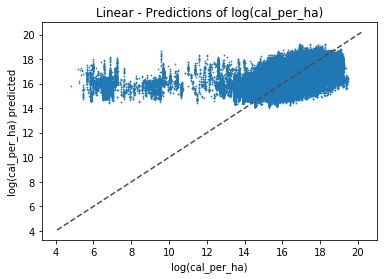

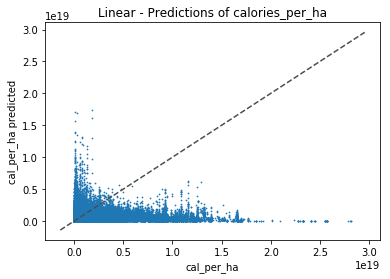

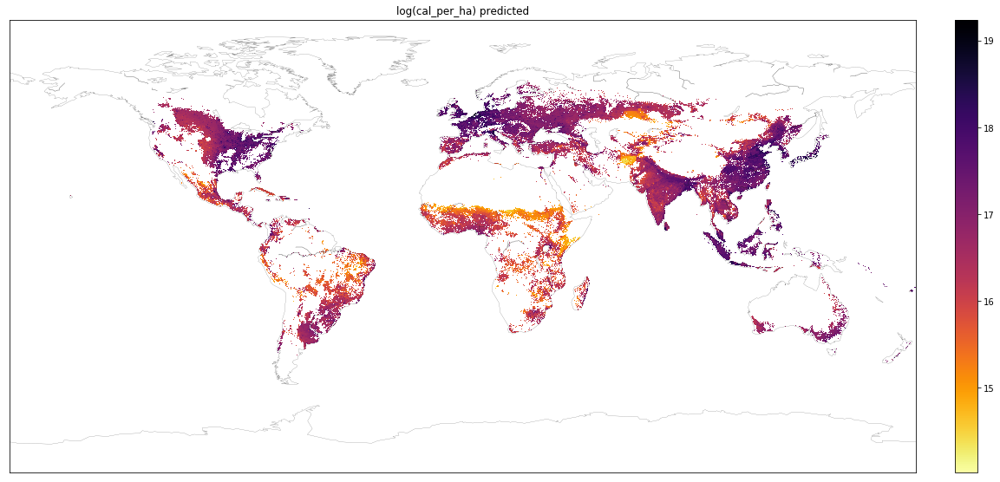

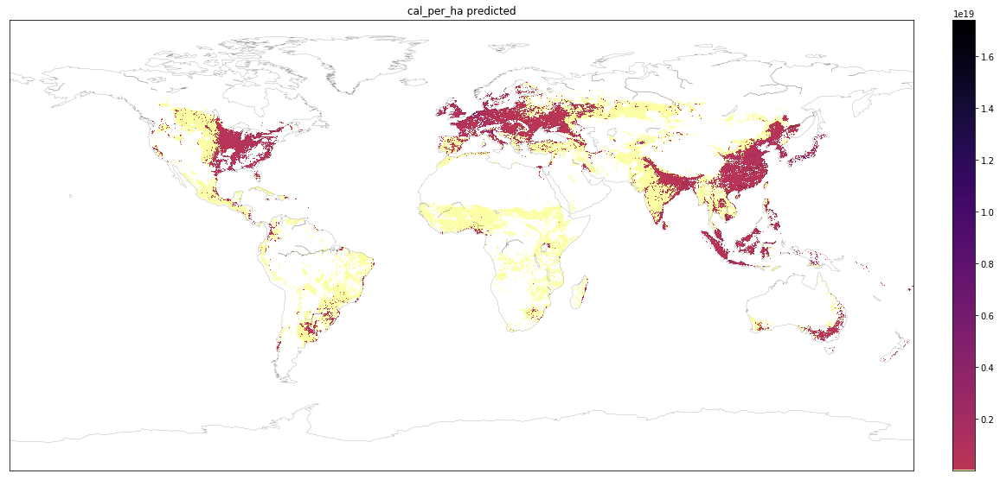

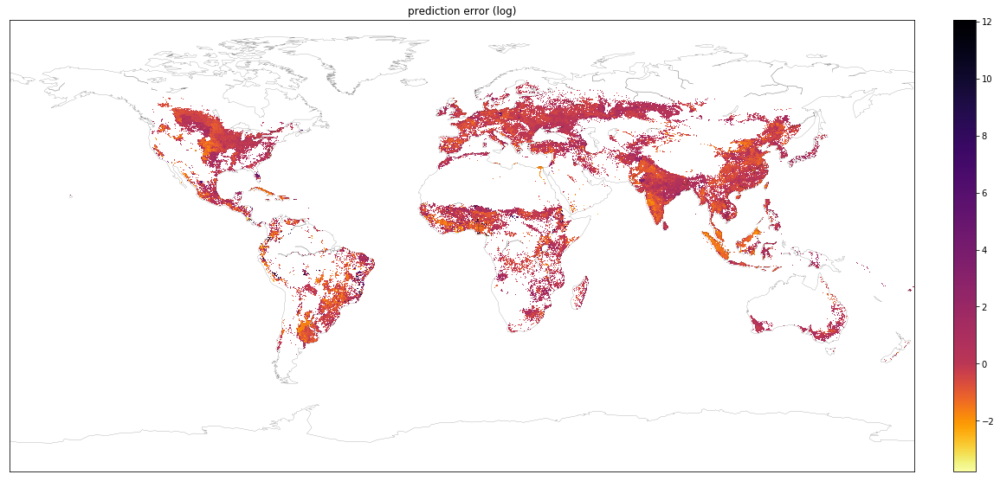

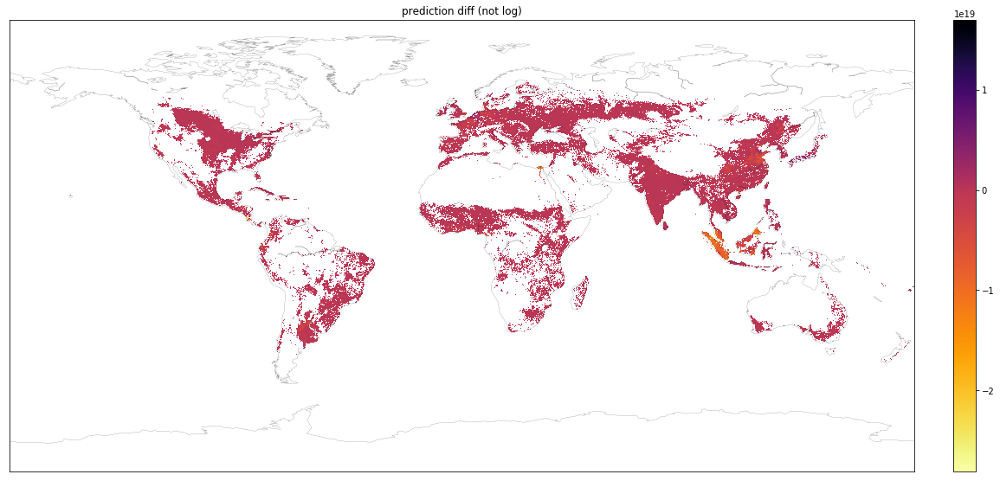

Maps & rasters done

Regression:
Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='random', tol=0.0001, warm_start=False)
Scatterplots done


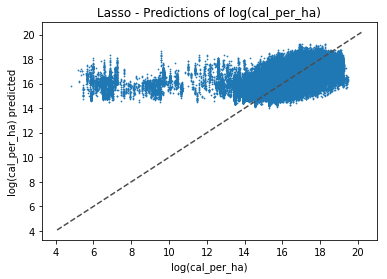

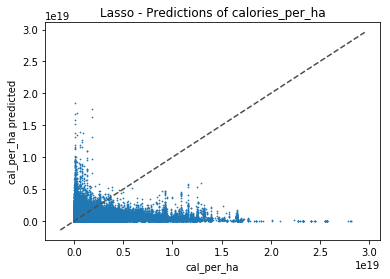

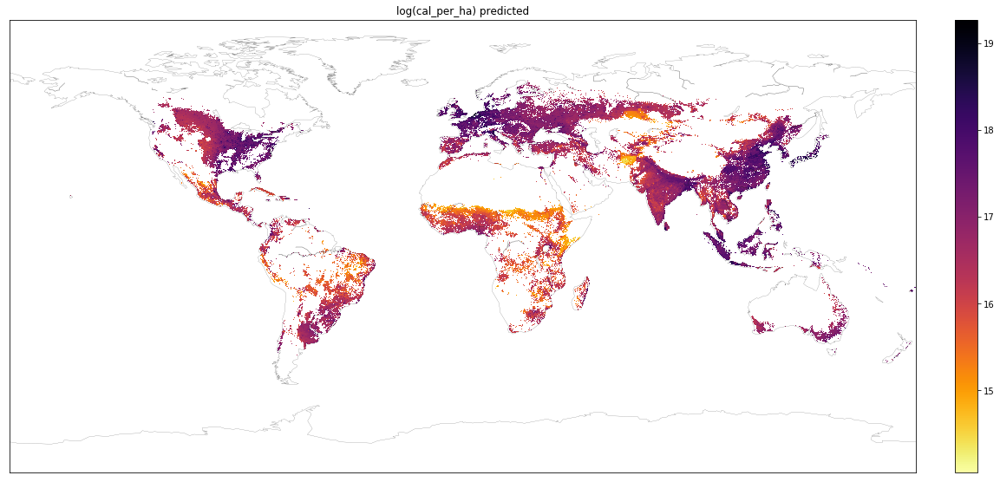

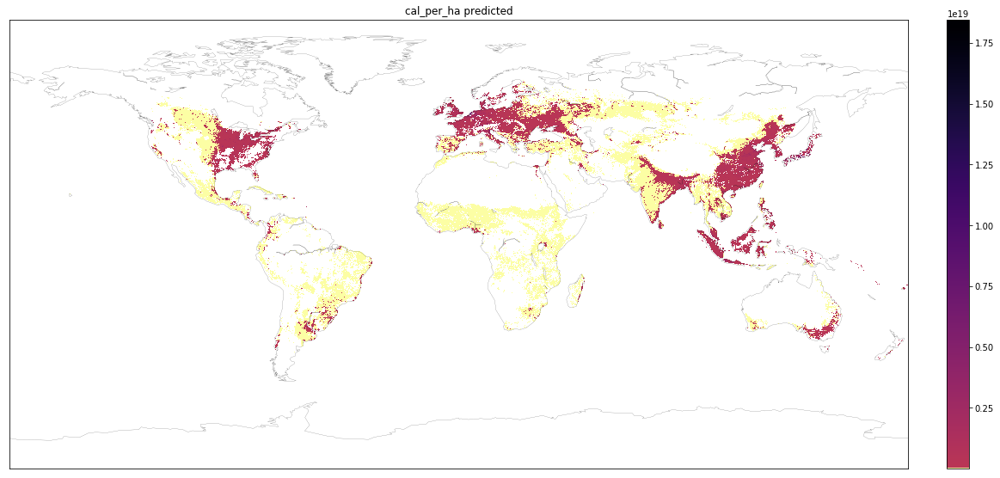

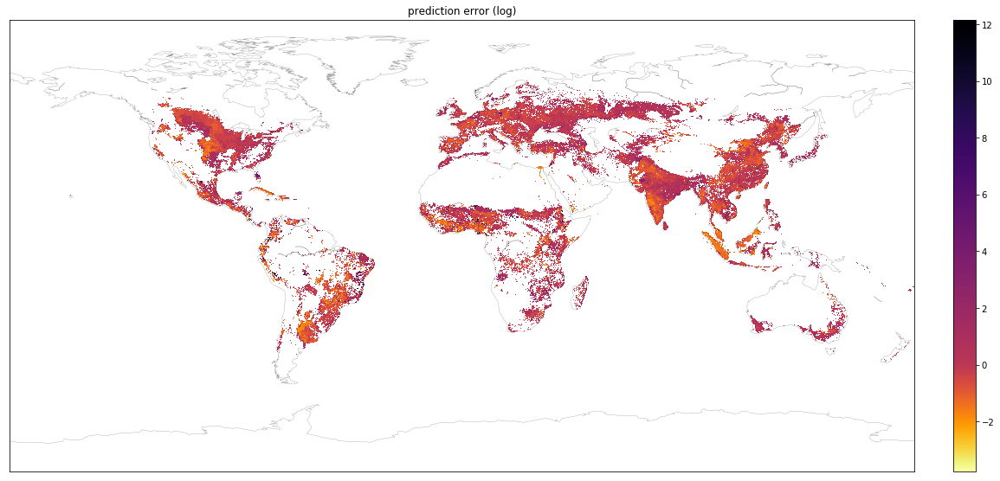

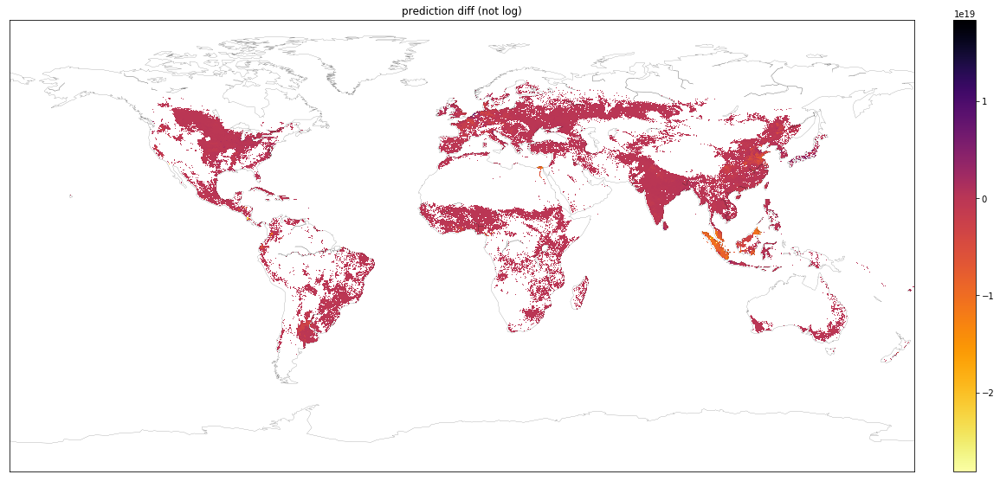

Maps & rasters done

Regression:
Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, random_state=None, solver='auto', tol=1e-06)
Scatterplots done


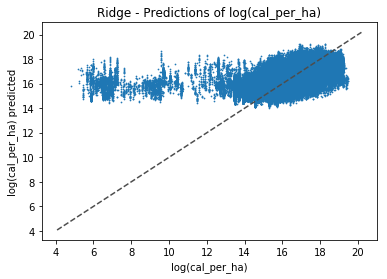

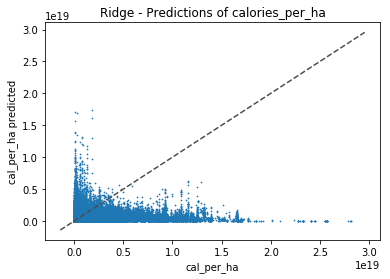

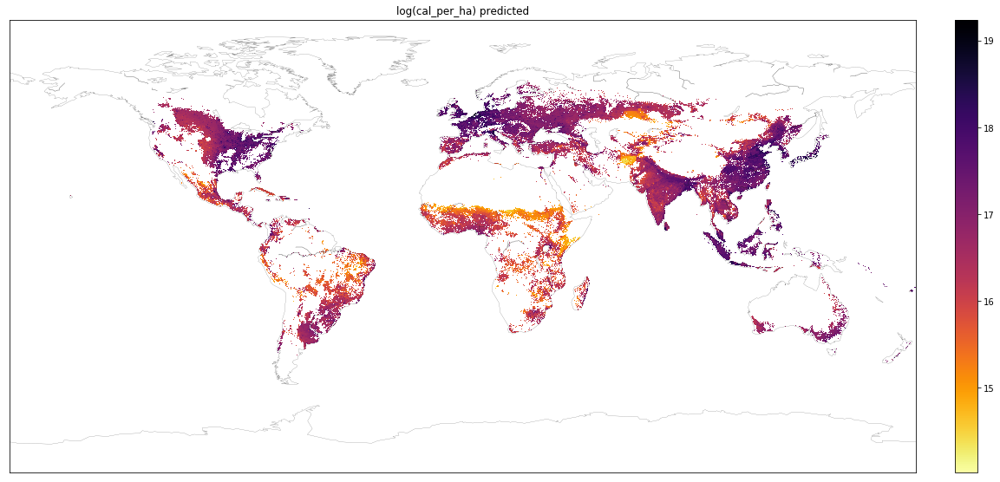

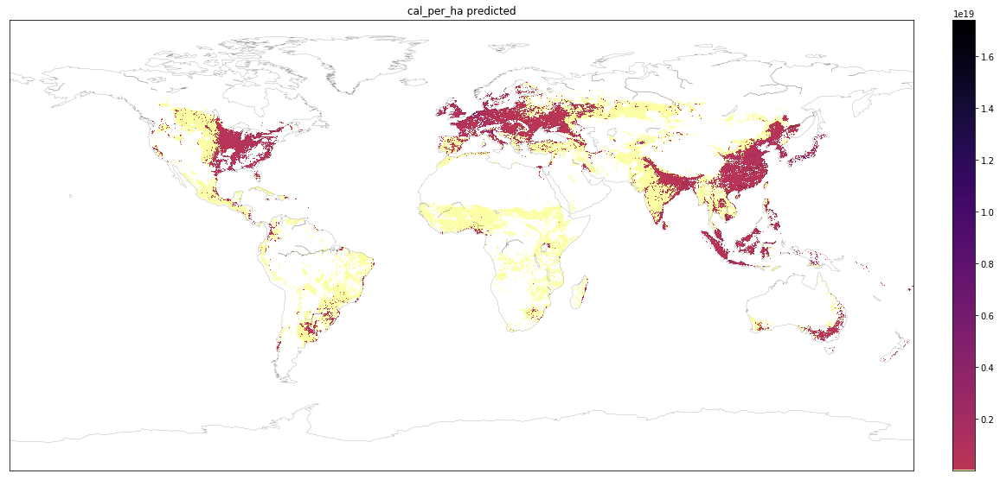

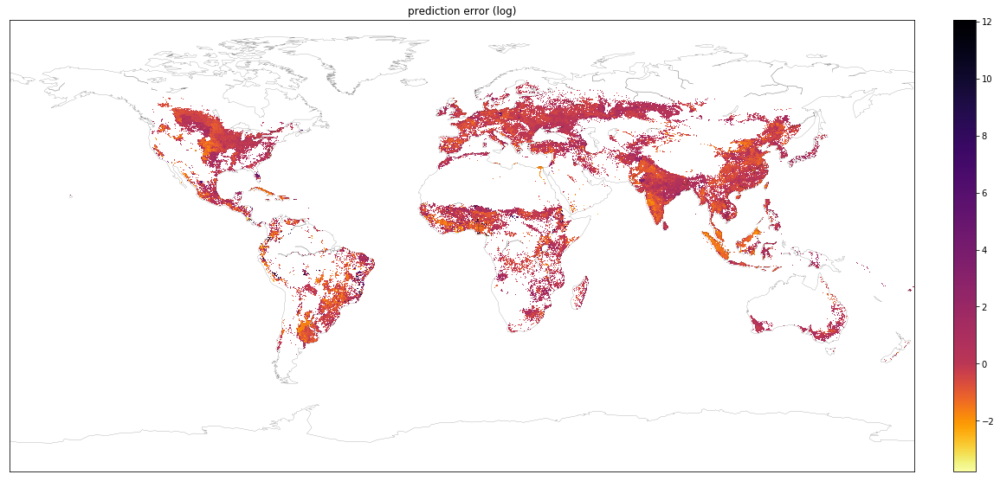

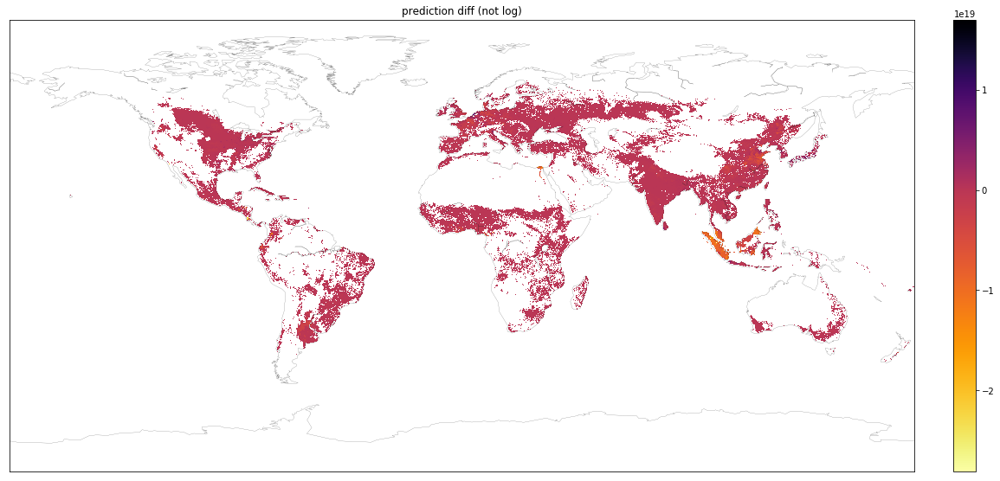

Maps & rasters done

Regression:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)
Scatterplots done


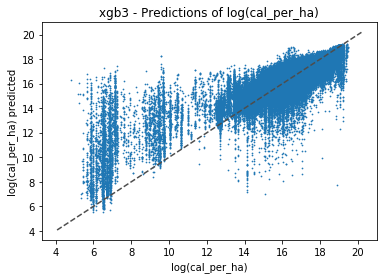

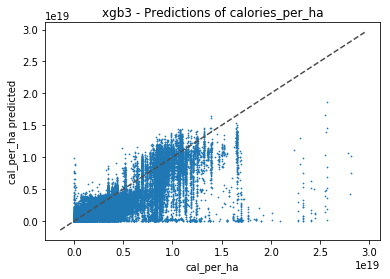

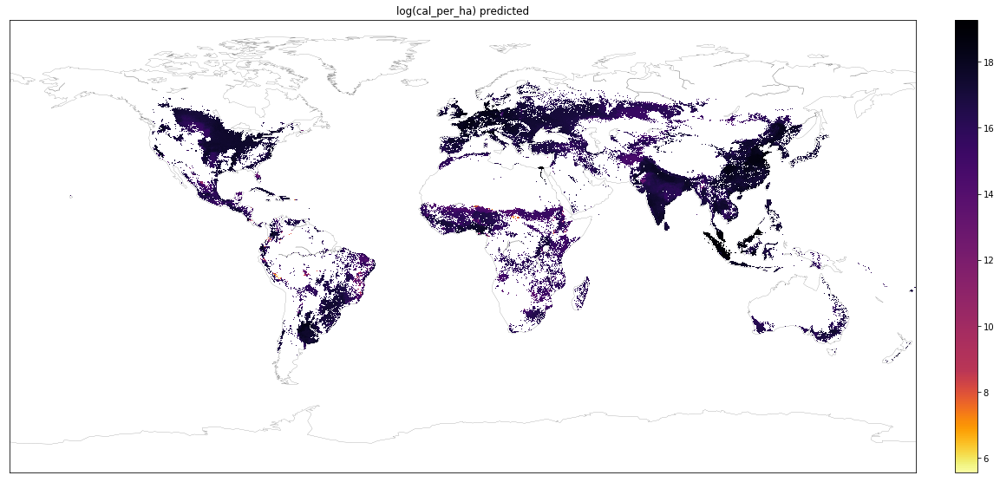

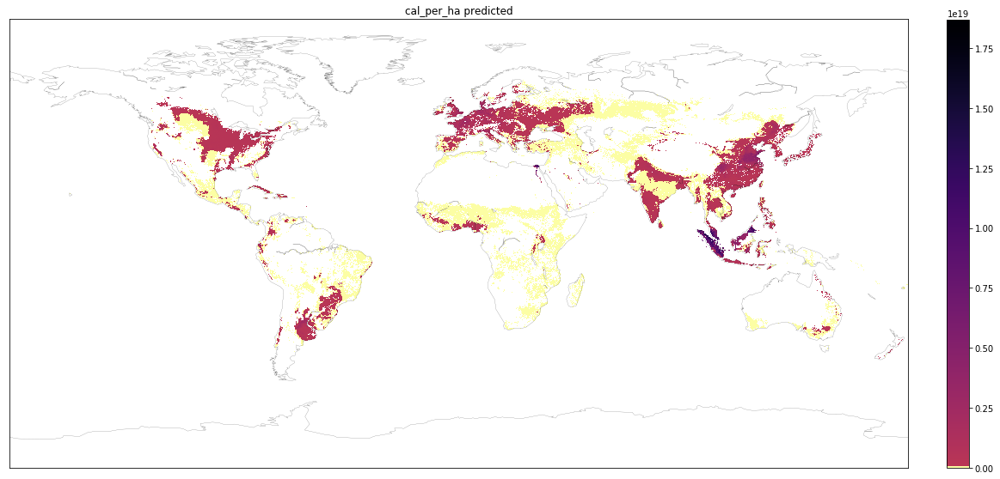

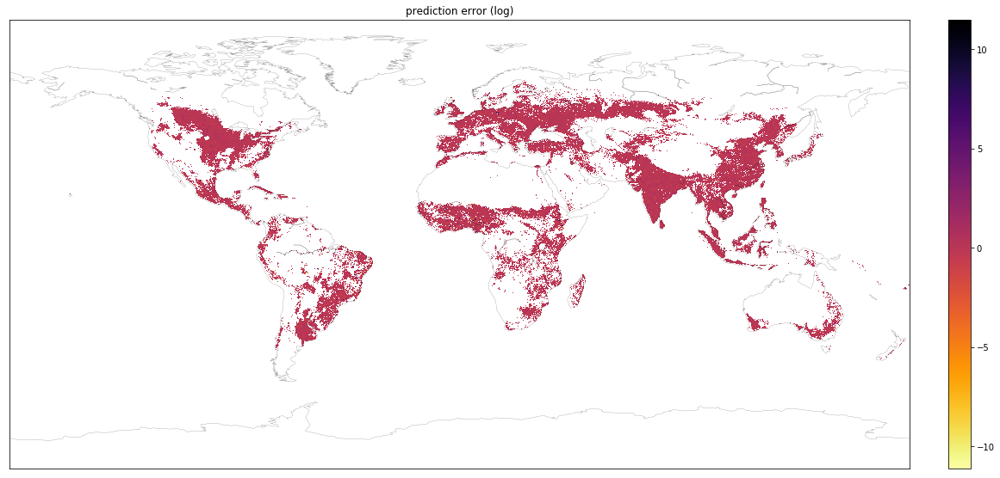

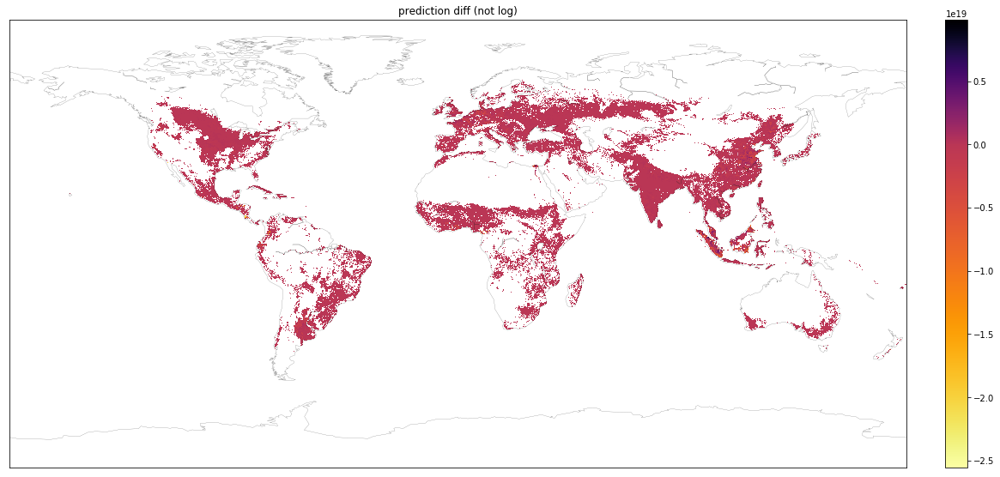

Maps & rasters done


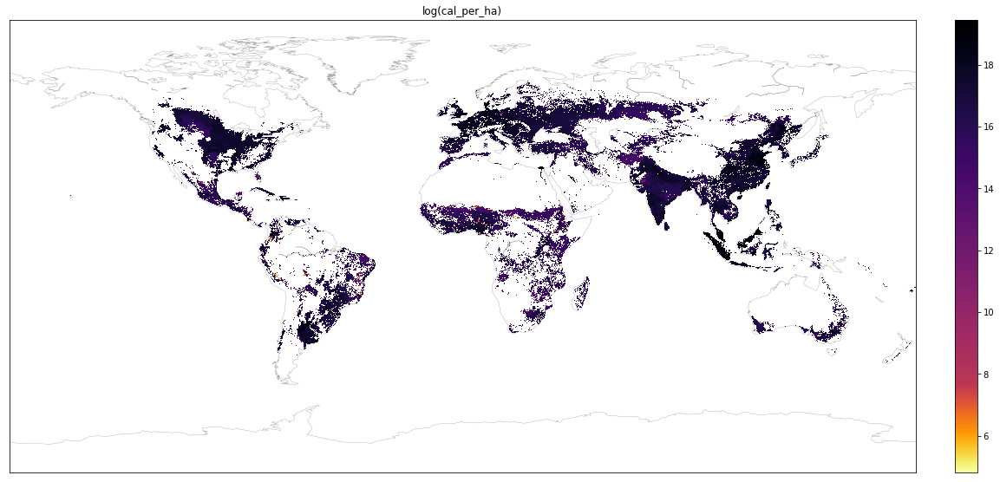

Baseline maps & rasters done


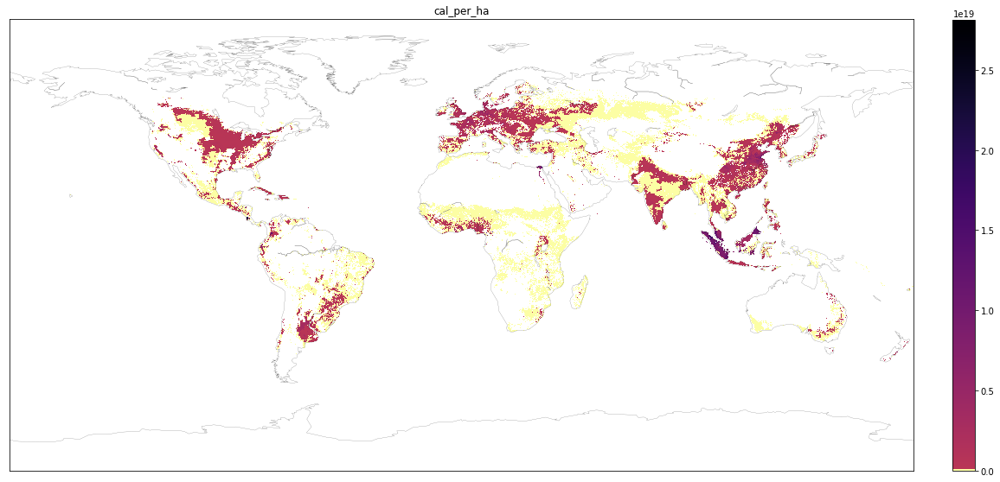

Baseline maps & rasters done


In [92]:
subset = None

for model in ['Linear','Lasso','Ridge','xgb3']: # TO DO Poly
    
    # Load model
    regression = load_regression(model)
    print('\nRegression:')
    print(regression)
    
    # Subset (TODO)
    
    # Apply model
    y_predicted = regression.predict(X)
    compare = predictions_df()
    
    # Save scatterplots
    ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title=(str(model)+' - Predictions of log(cal_per_ha)'));
    ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
    plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted_log---'+str(model)+'.png')
    
    
    ax = compare.plot.scatter(x='cal_per_ha',y='cal_per_ha predicted',s=0.5,title=(str(model)+' - Predictions of calories_per_ha'));
    ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
    plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted---'+str(model)+'.png')
    print('Scatterplots done')
    
    # Save maps+raster (rasters TO DO fct export_raster)    
    for column in ['log(cal_per_ha) predicted','cal_per_ha predicted',
                  'prediction error (log)','prediction diff (not log)']:
        visualize_data(compare,column,colorscheme='sequential',
                   savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'--'+model+'.png')
    
    
        export_raster(compare,column,
                 savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'--'+model+'.png')
    print('Maps & rasters done')
    
for column in ['log(cal_per_ha)','cal_per_ha']:       
    visualize_data(compare,column,colorscheme='sequential',
                   savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'.png')
    
    export_raster(compare,column,
                  savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'.png')
    print('Baseline maps & rasters done')
    

## Loop - With subsetting options * baseline_df

In [101]:
simple_subset = ['slope','lat','sin_lon','log_altitude',
                  'workability_index',
                  'log_gpw_population',
                  'temp_avg','precip',
                  'calories_per_ha']

simple_subset_gdp = ['slope','lat','sin_lon','log_altitude',
                  'workability_index',
                  'gdp','log_gdp_per_capita','log_gpw_population',
                  'temp_avg','precip',
                  'calories_per_ha']

columns_without_climatezones = baseline_df.columns
for col in baseline_df.columns:
    if "climatezone" in col: 
        columns_without_climatezones = columns_without_climatezones.drop([col])


Regression:
LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)
Scatterplots done


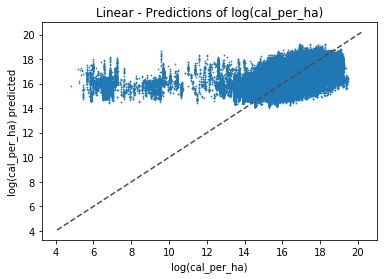

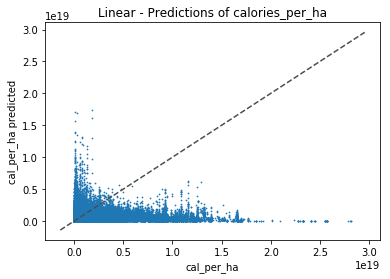

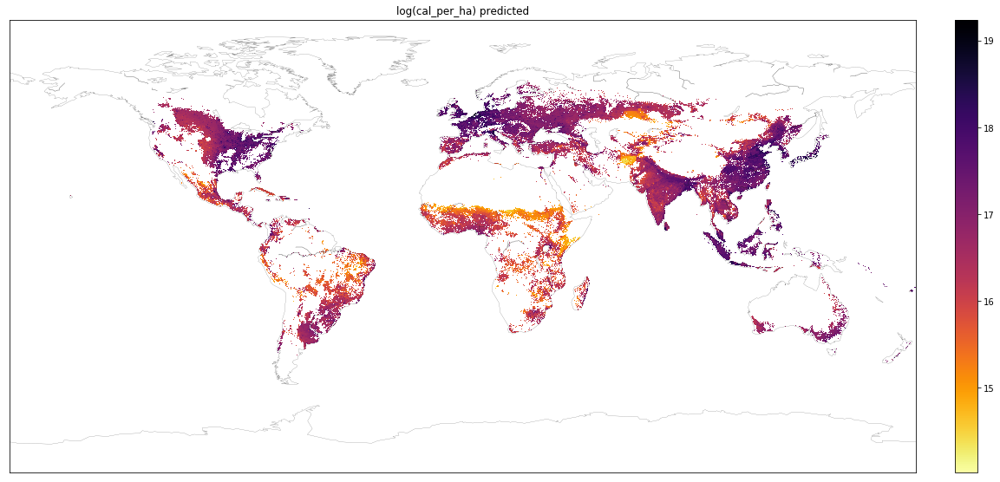

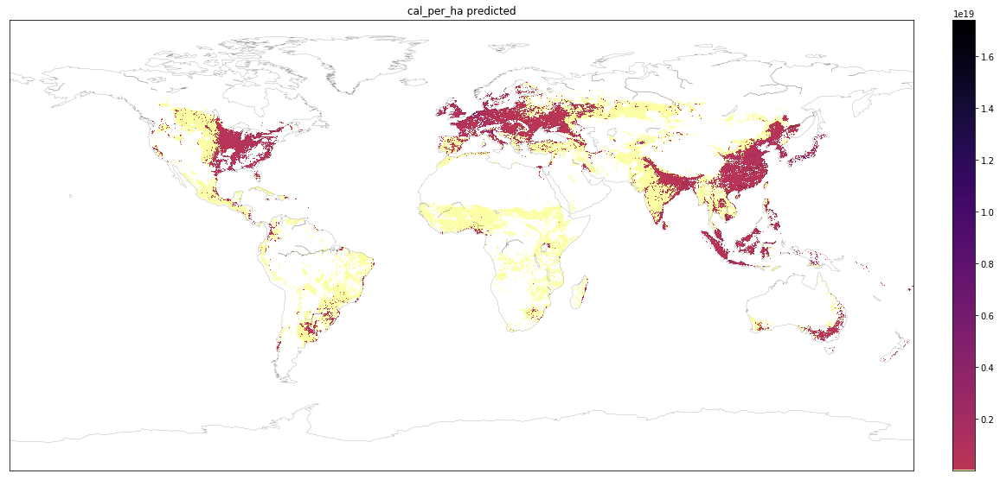

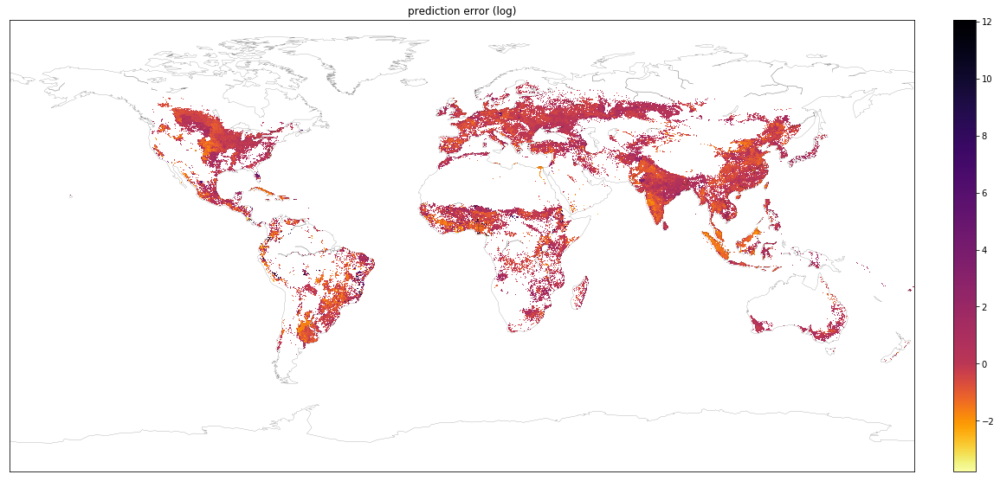

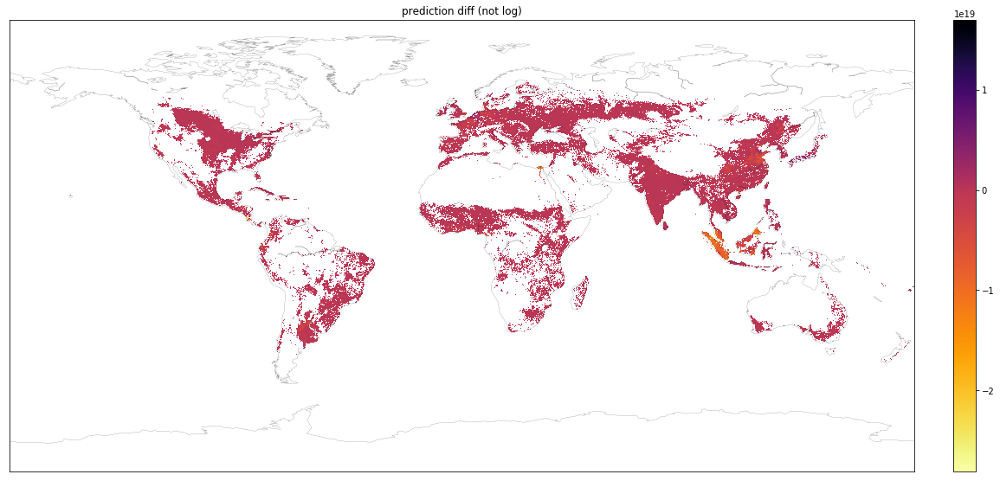

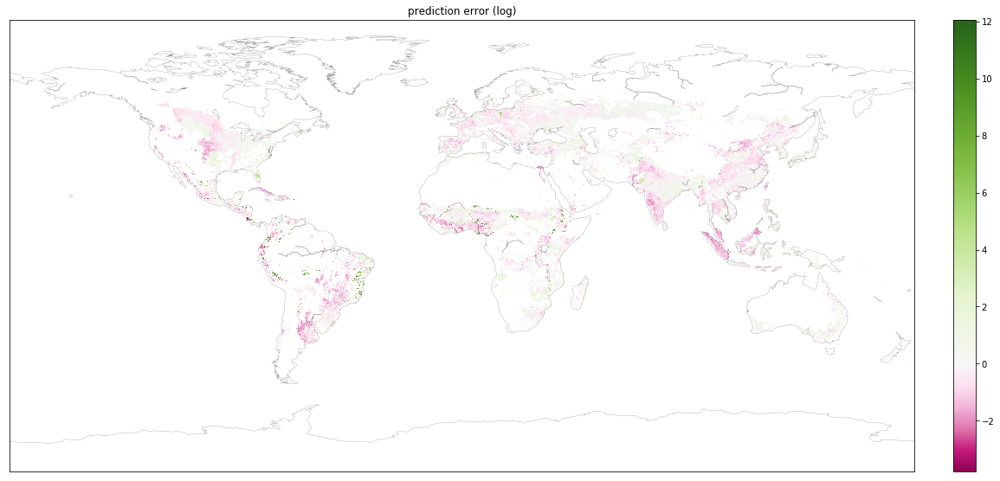

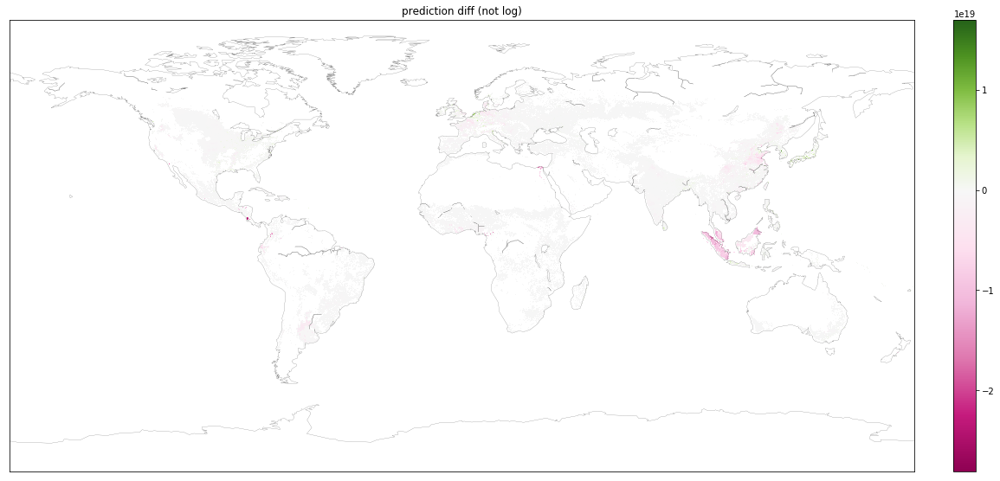

Maps & rasters done

Regression:
LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)
Scatterplots done


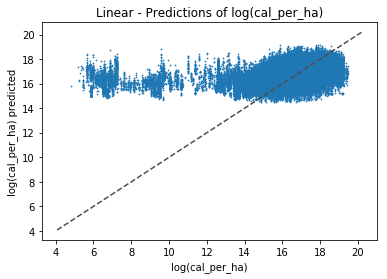

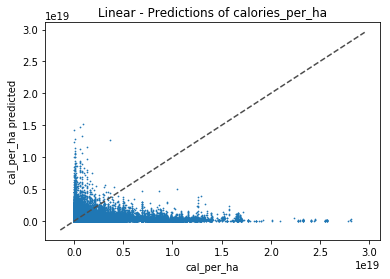

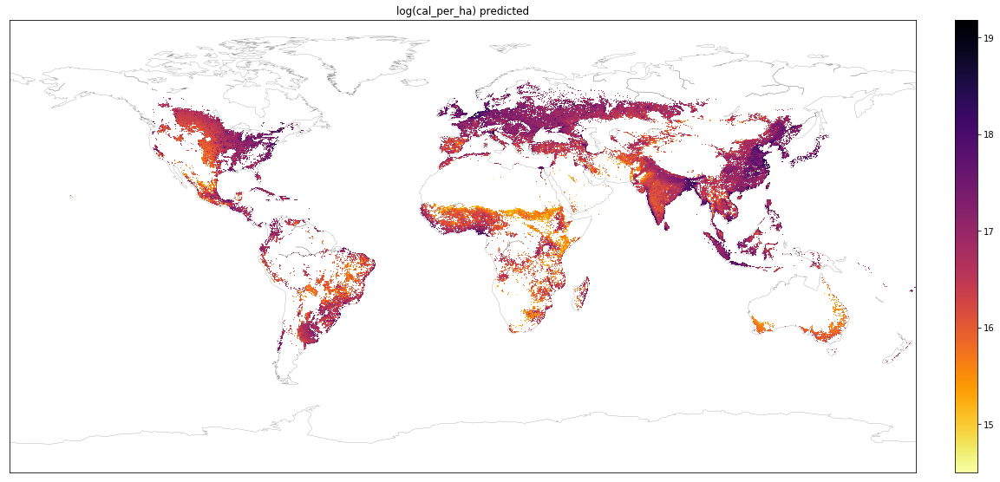

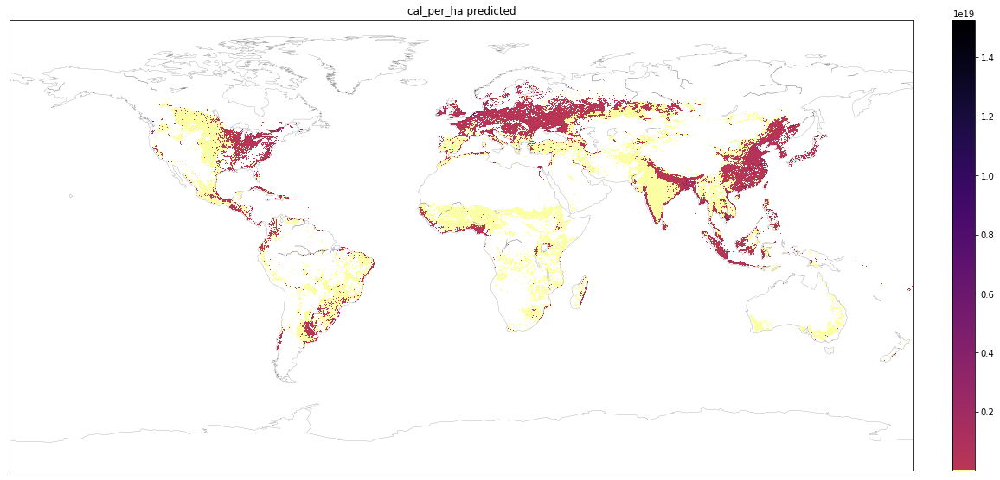

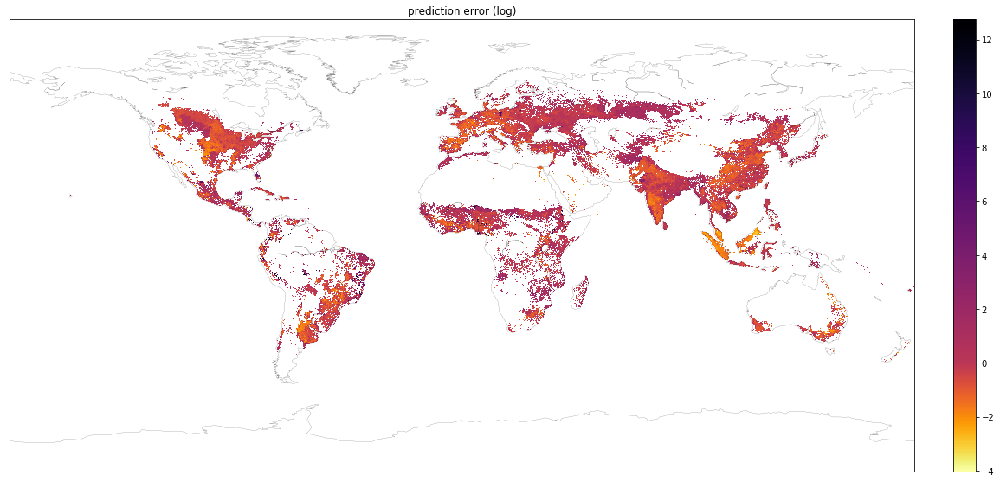

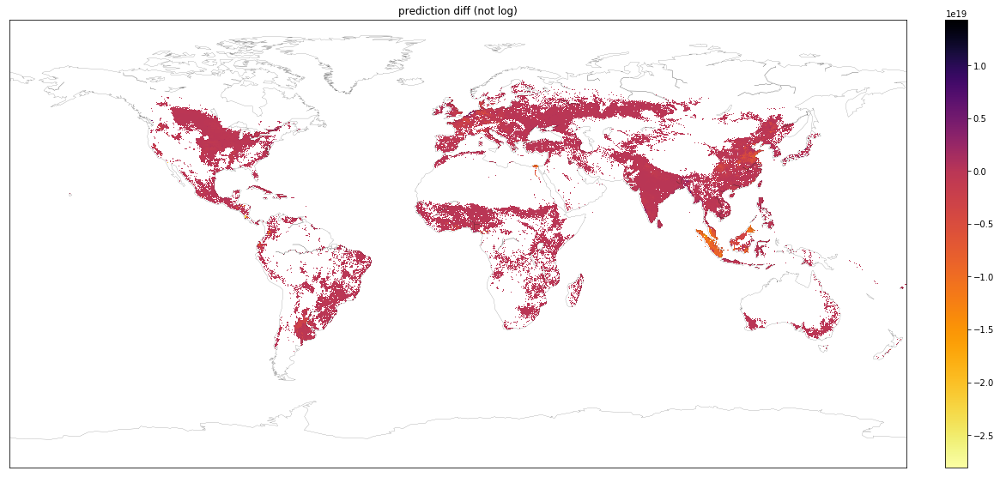

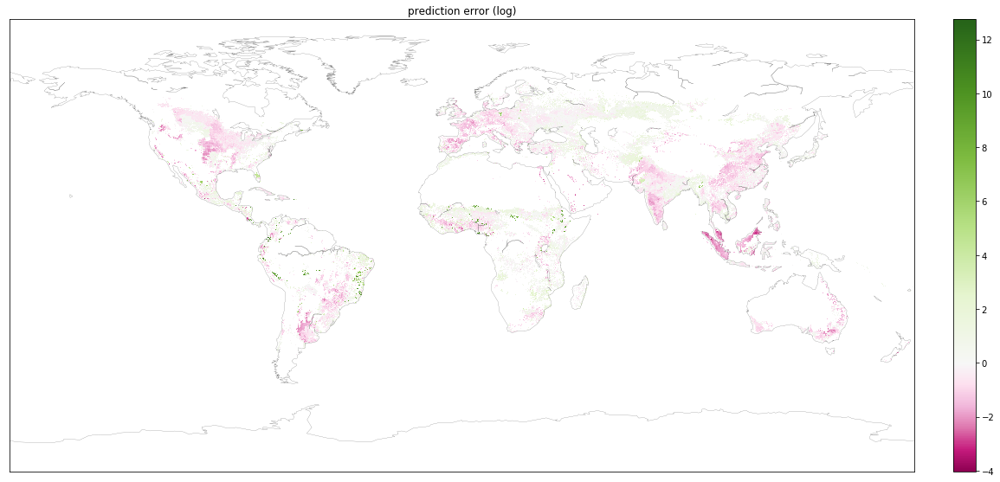

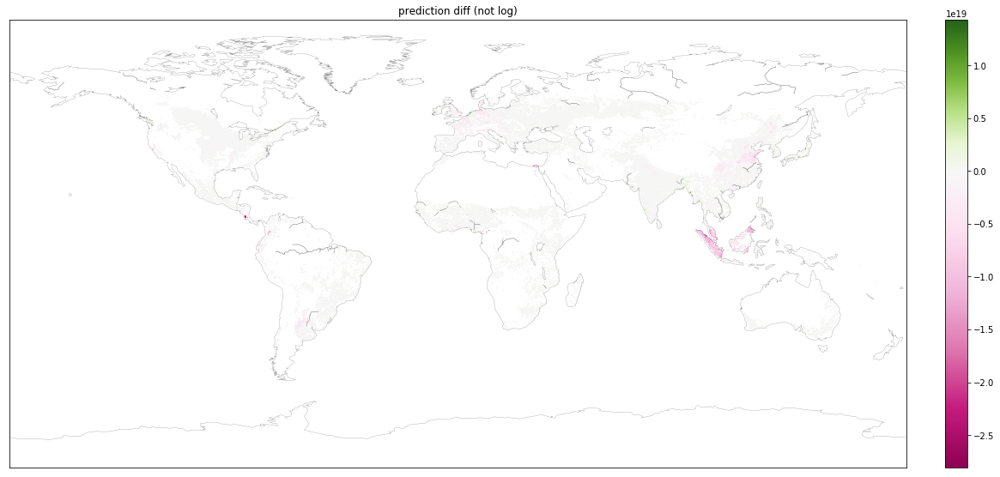

Maps & rasters done

Regression:
LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)
Scatterplots done


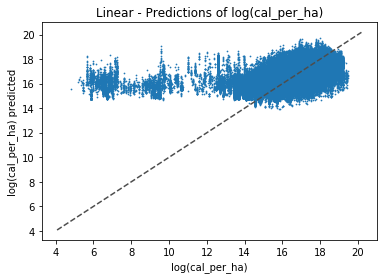

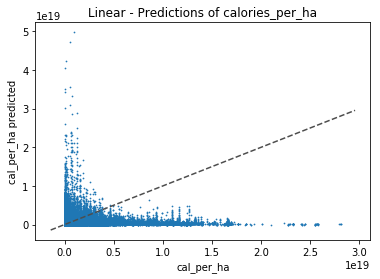

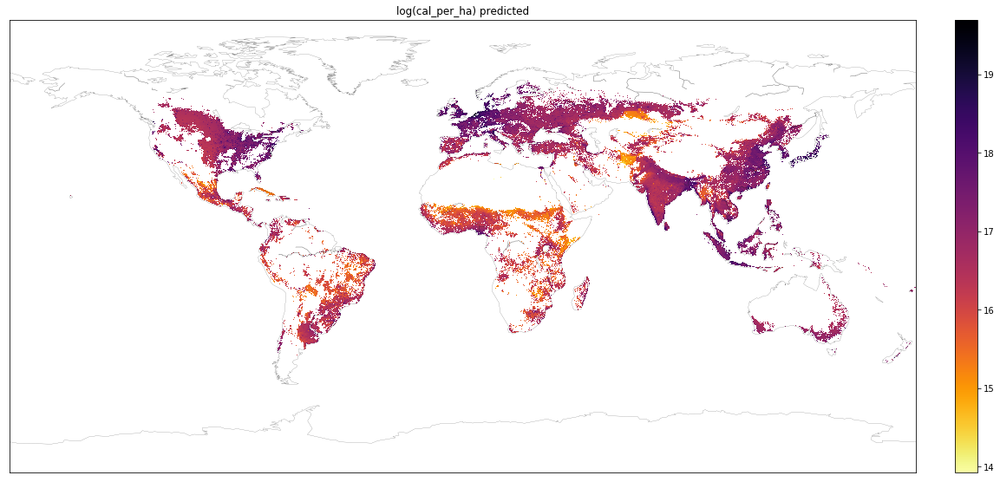

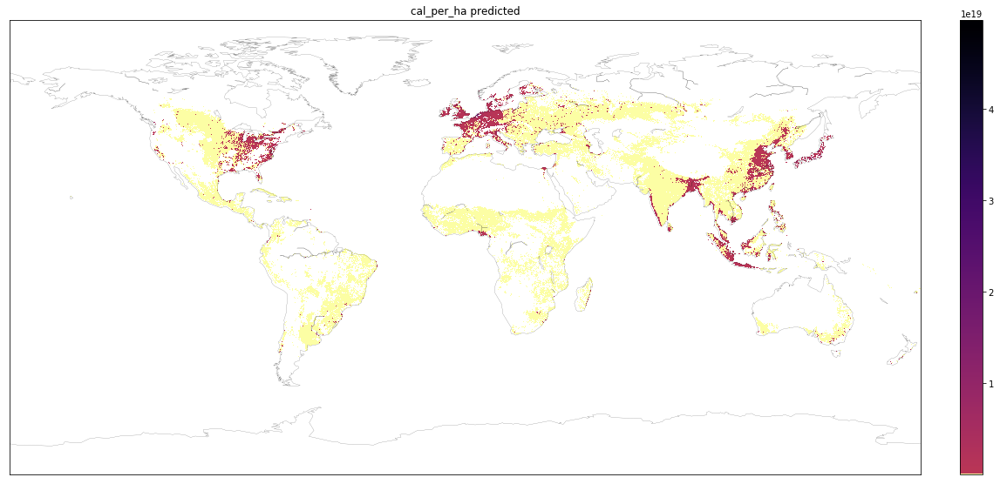

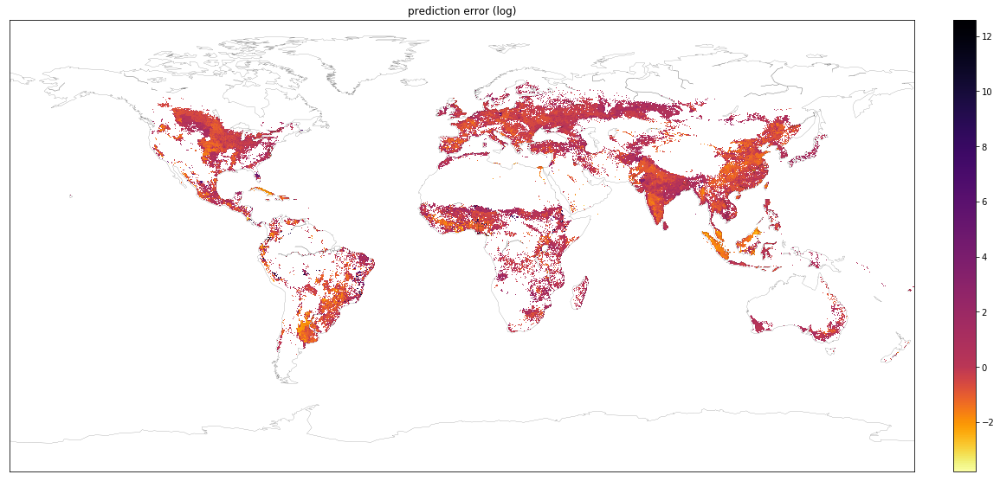

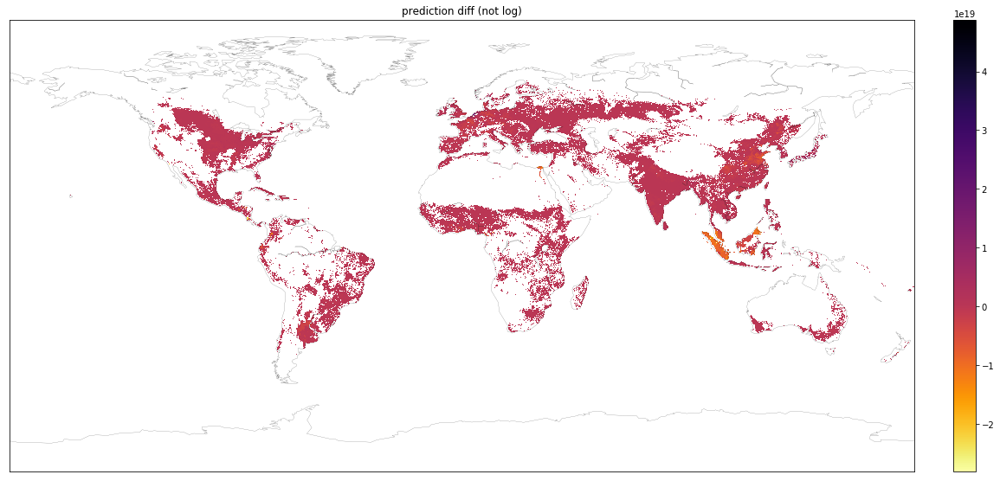

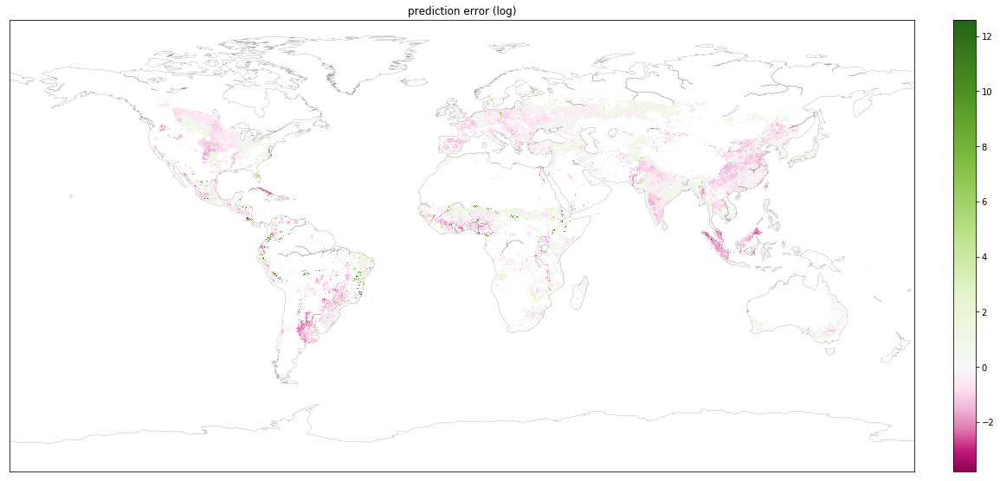

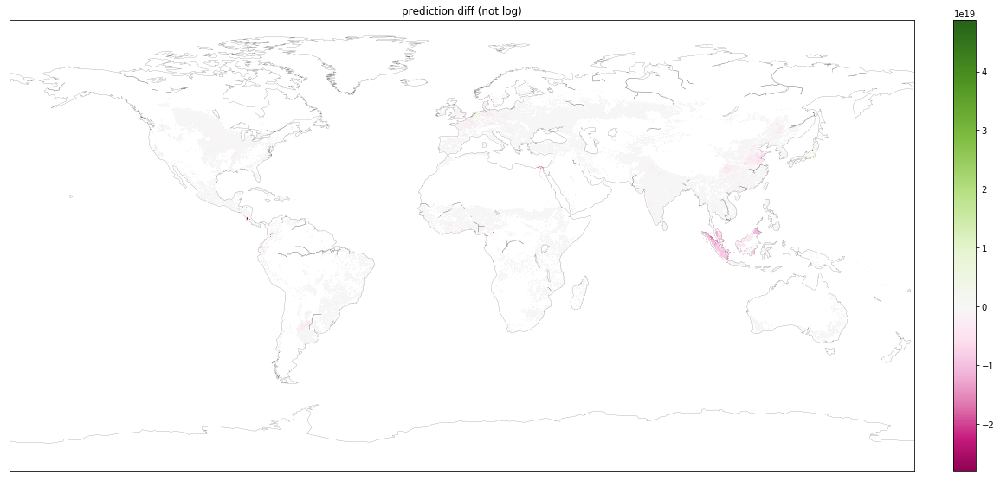

Maps & rasters done

Regression:
LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)
Scatterplots done


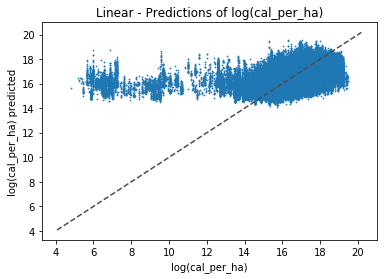

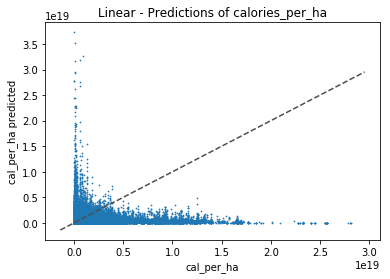

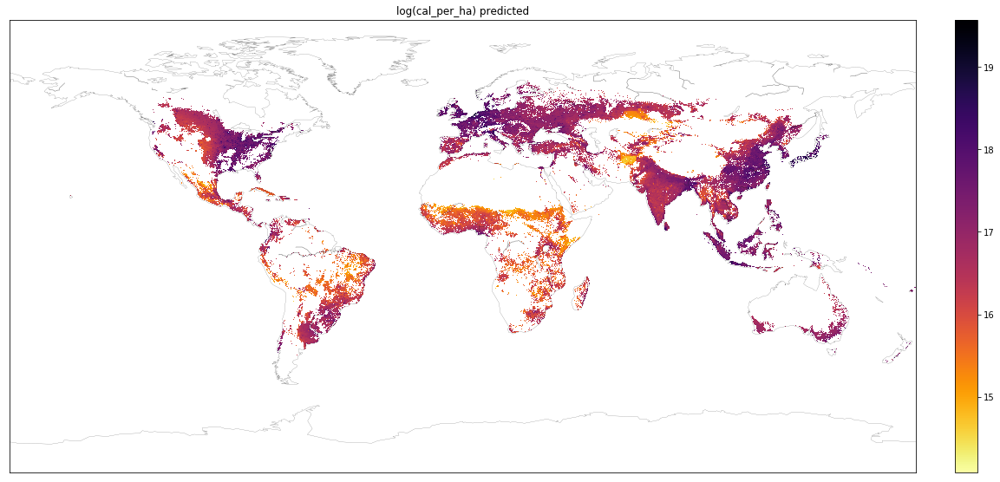

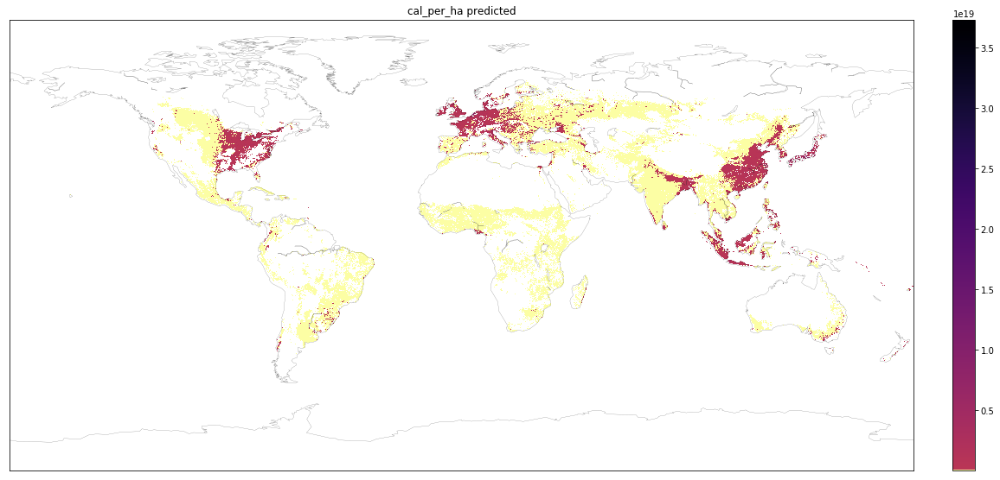

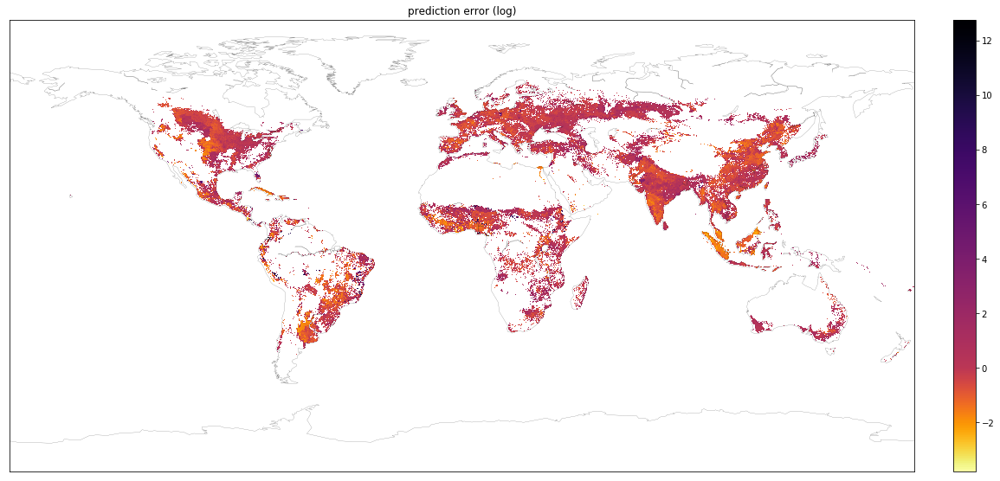

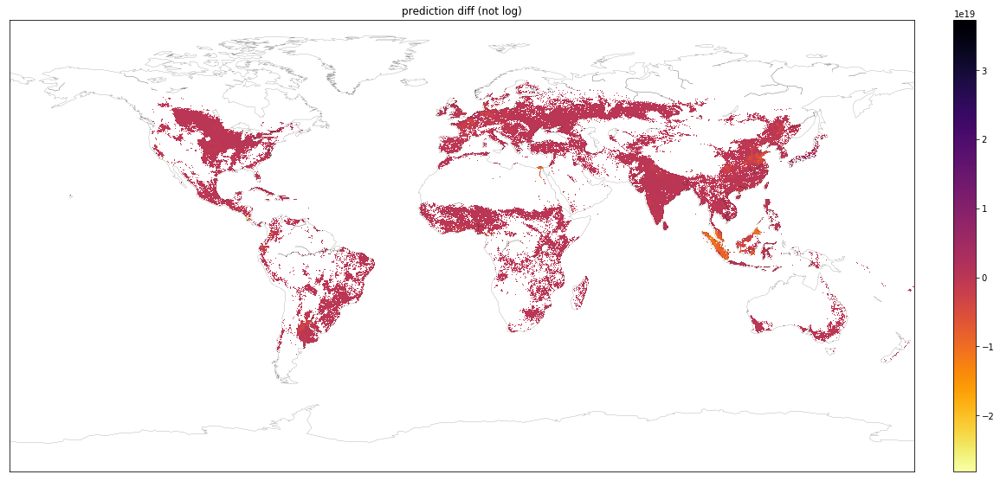

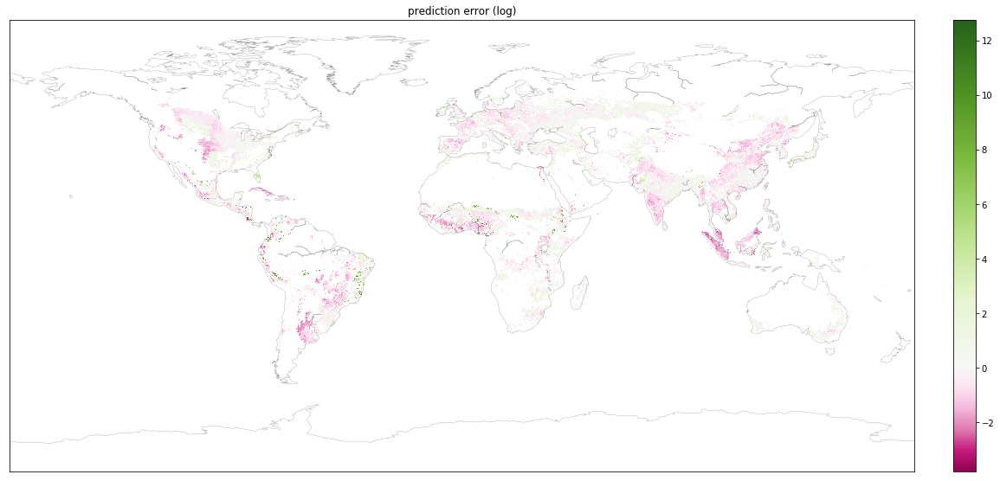

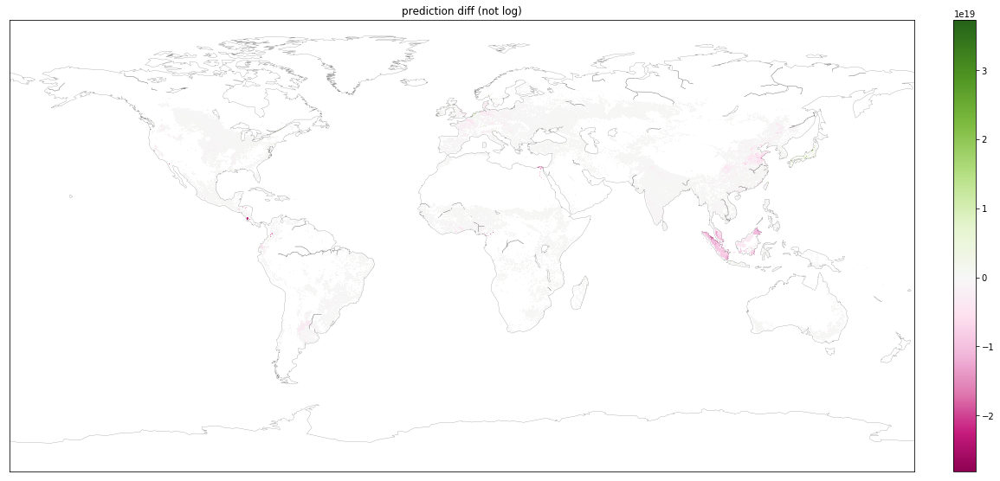

Maps & rasters done

Regression:
Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='random', tol=0.0001, warm_start=False)
Scatterplots done


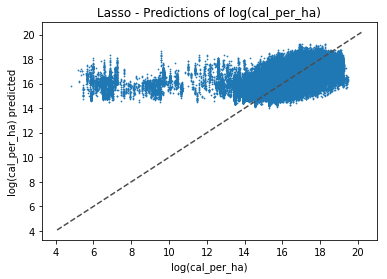

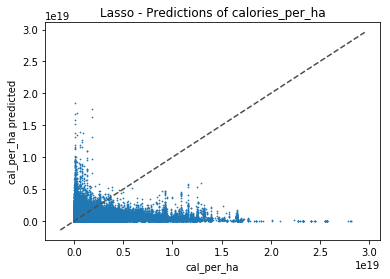

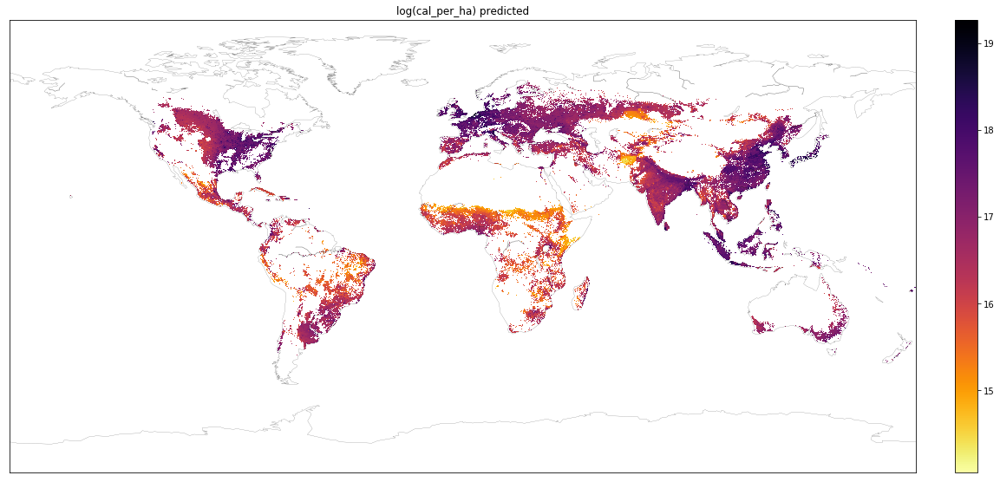

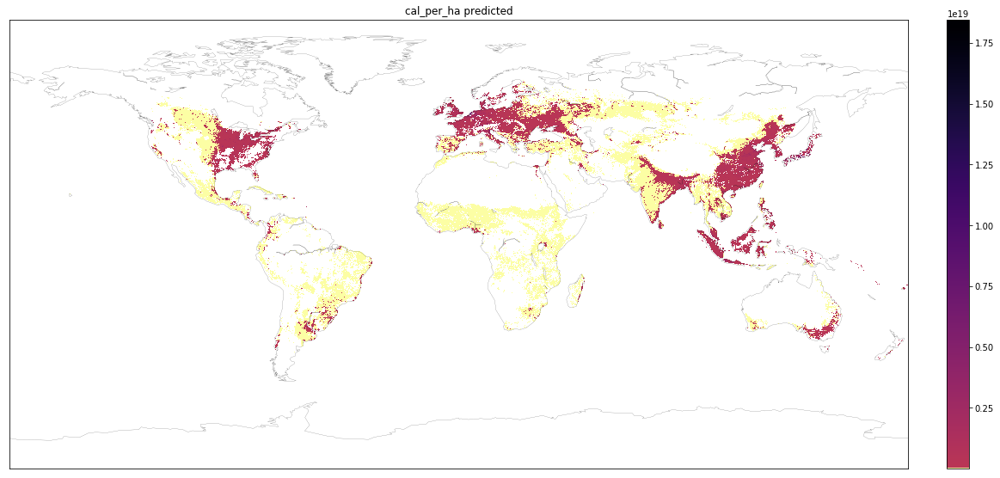

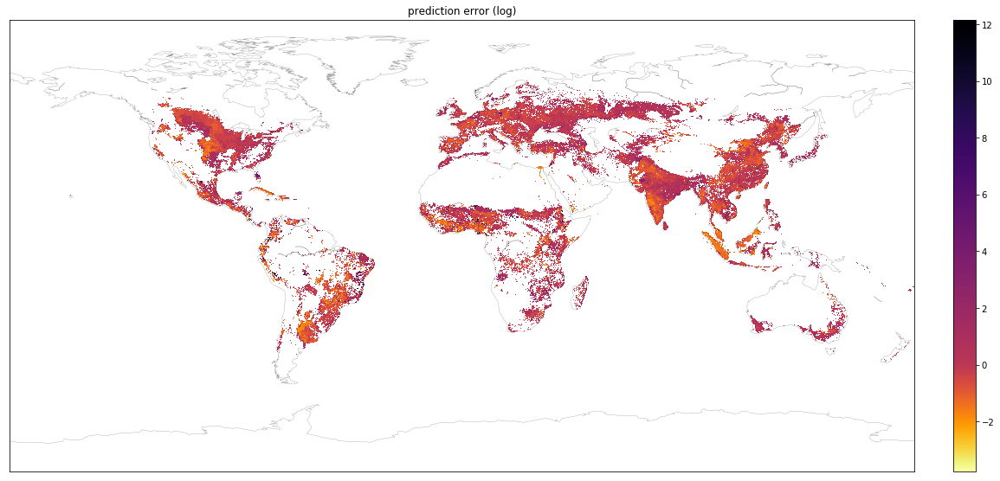

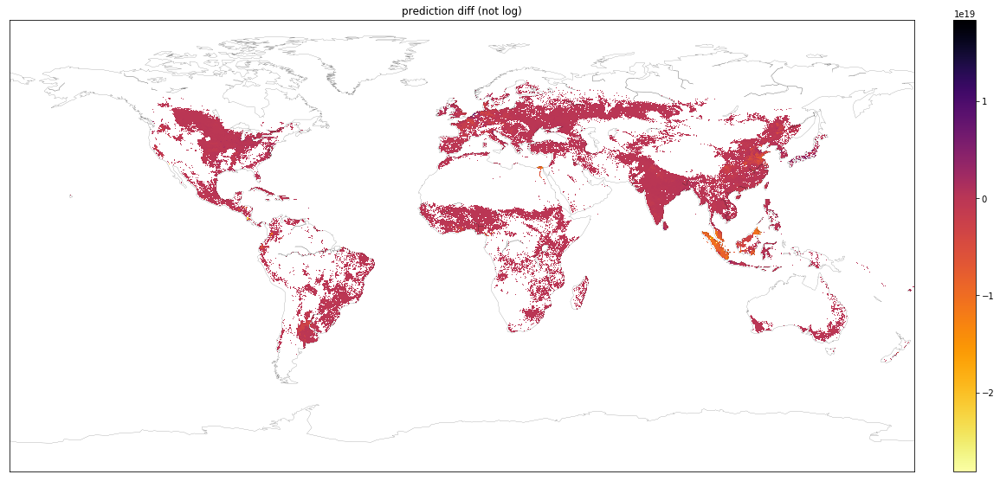

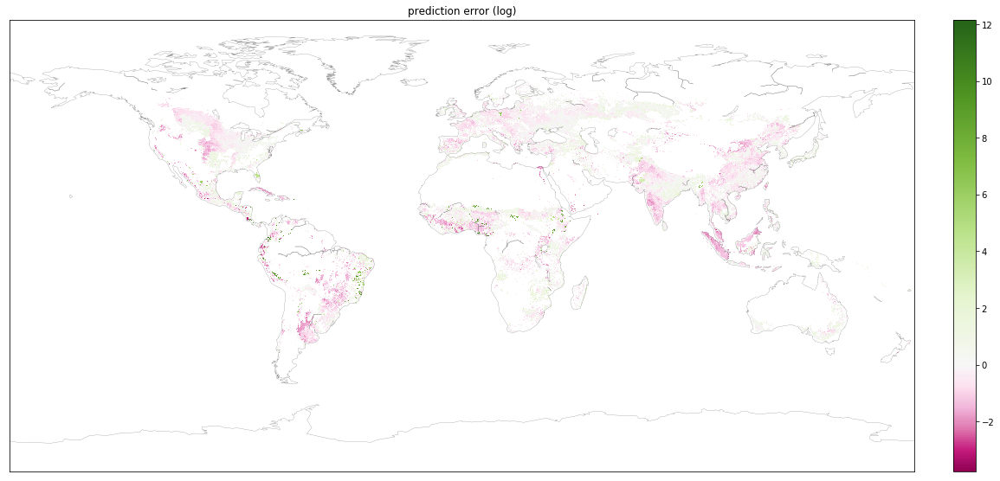

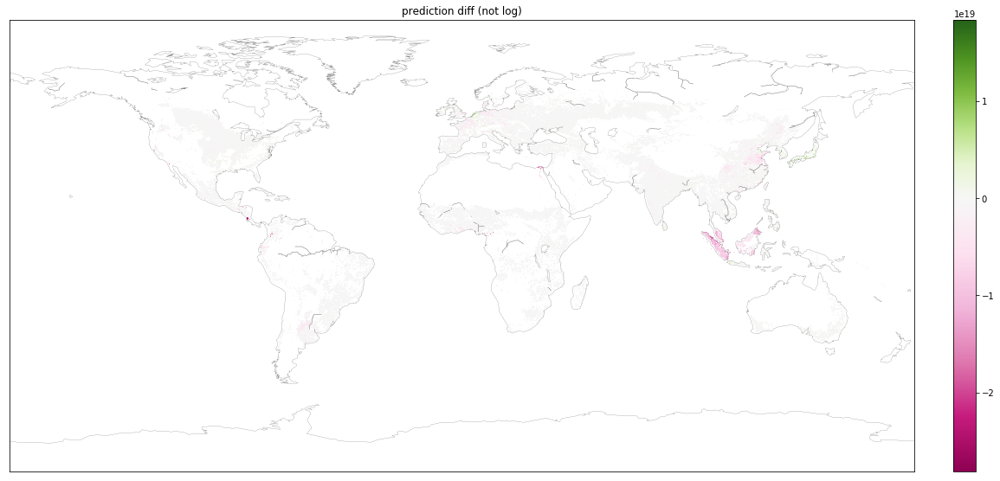

Maps & rasters done

Regression:
Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='random', tol=0.0001, warm_start=False)
Scatterplots done


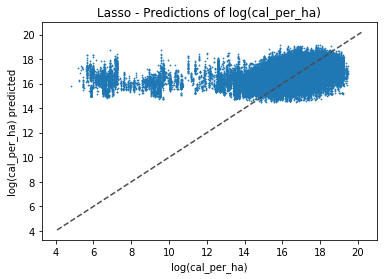

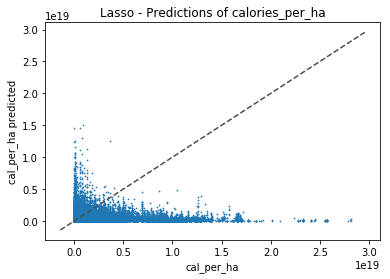

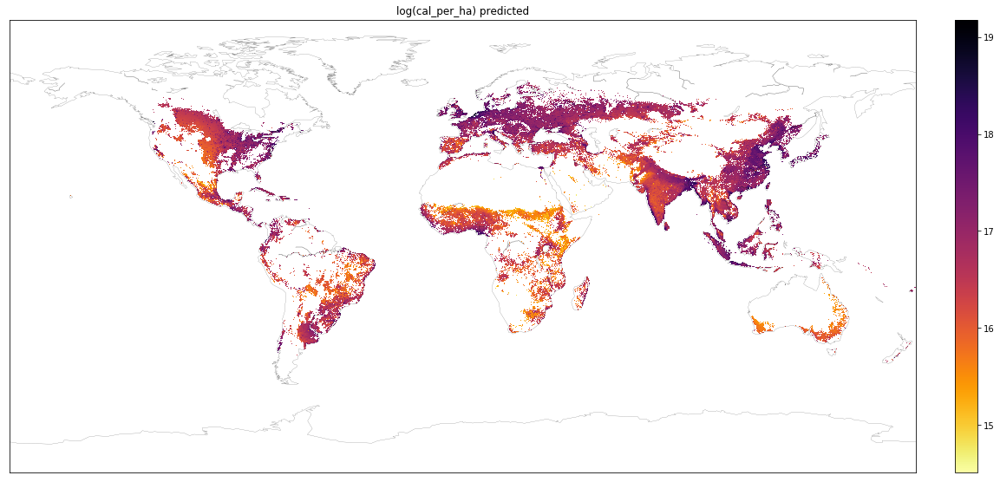

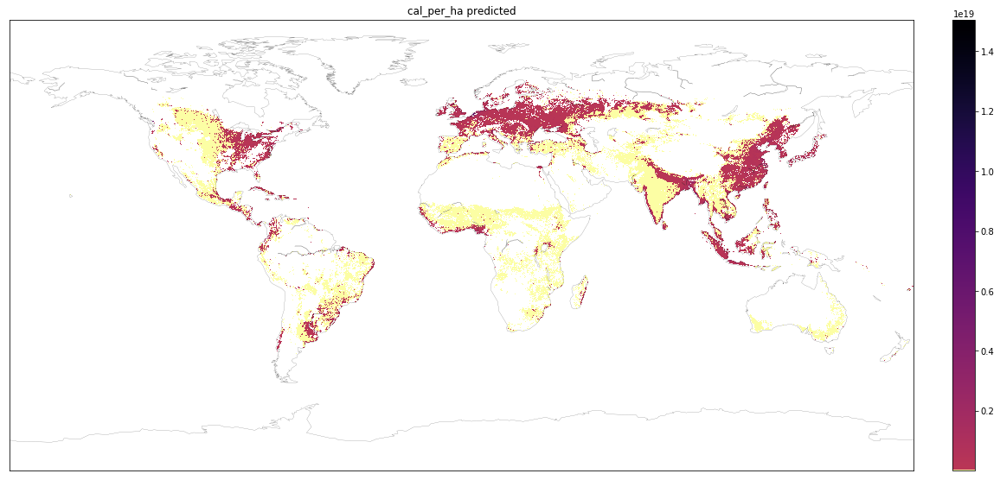

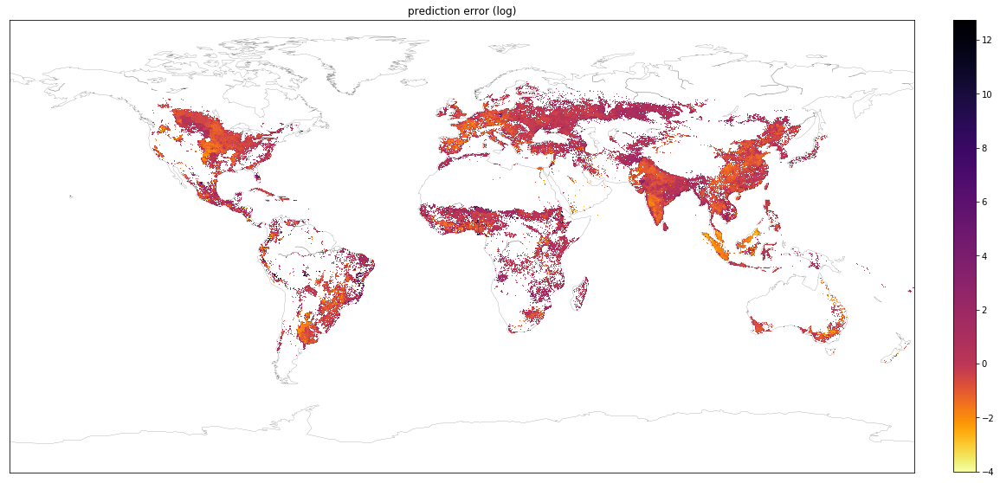

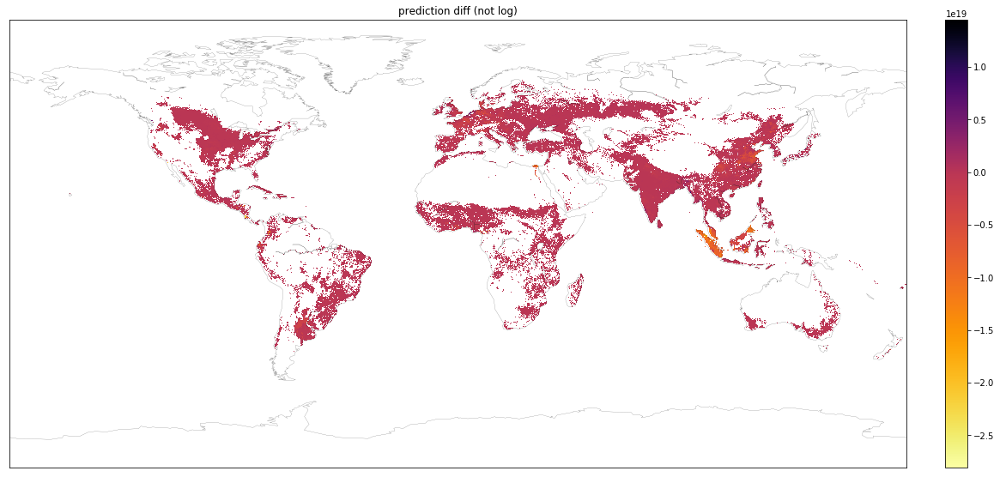

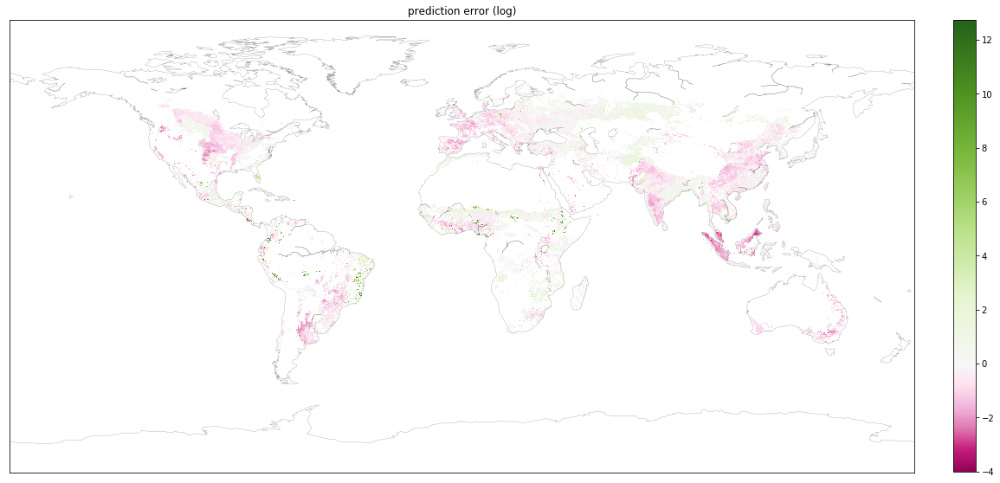

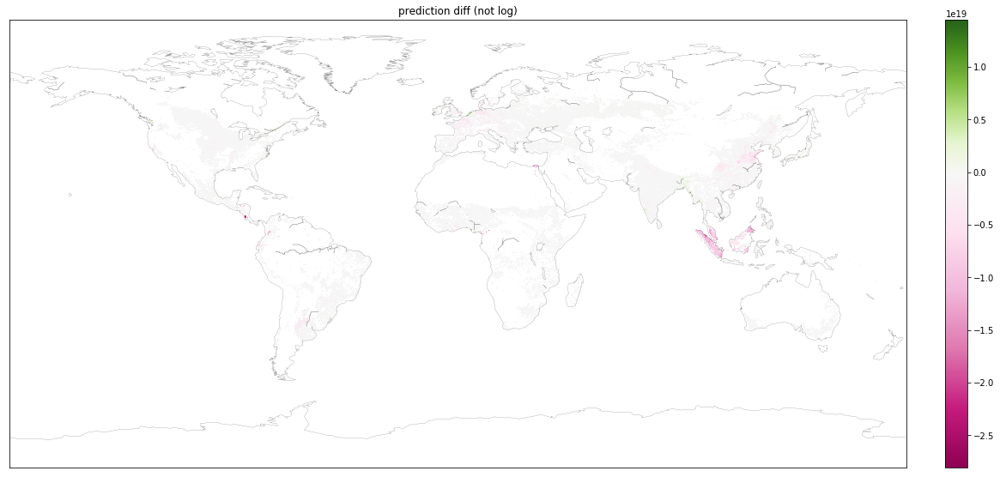

Maps & rasters done

Regression:
Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='random', tol=0.0001, warm_start=False)
Scatterplots done


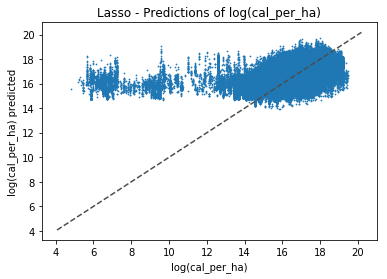

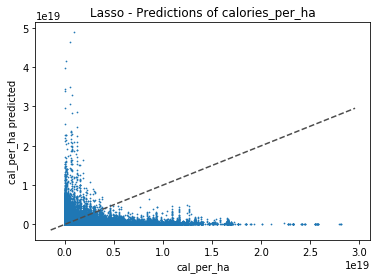

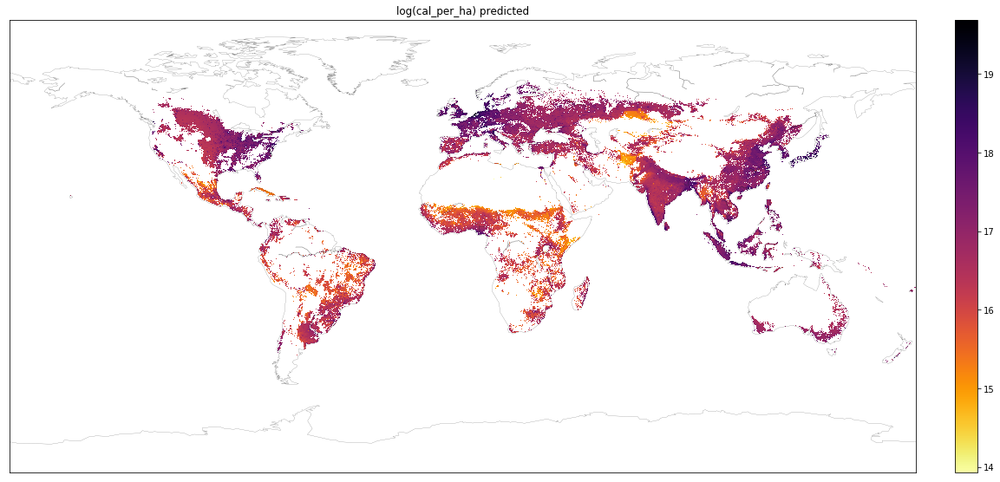

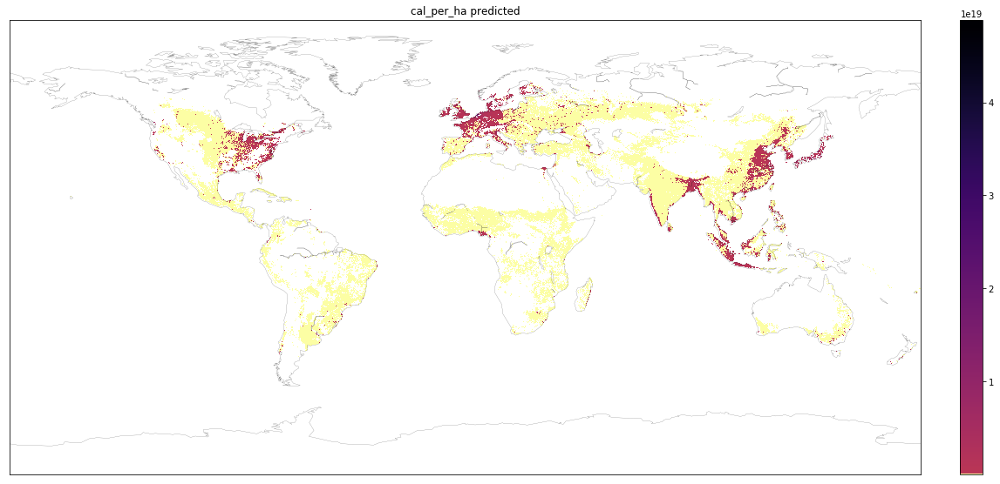

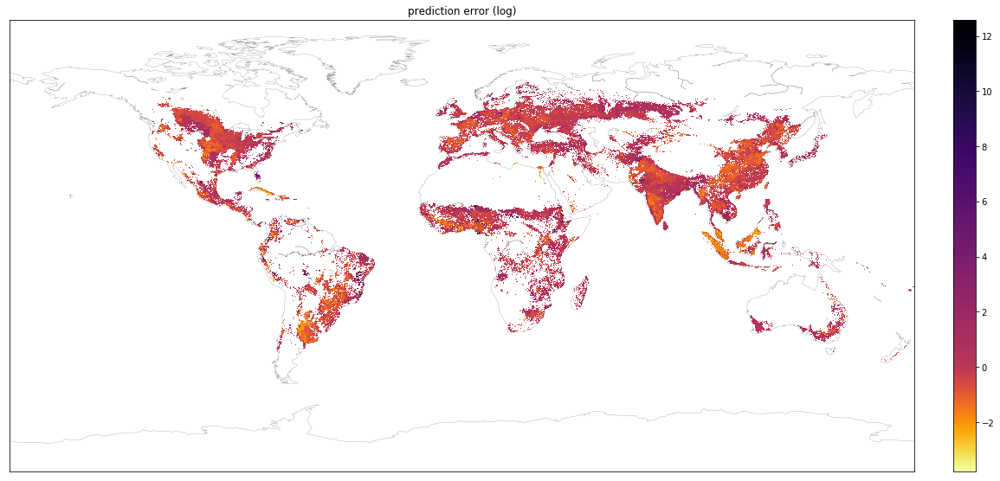

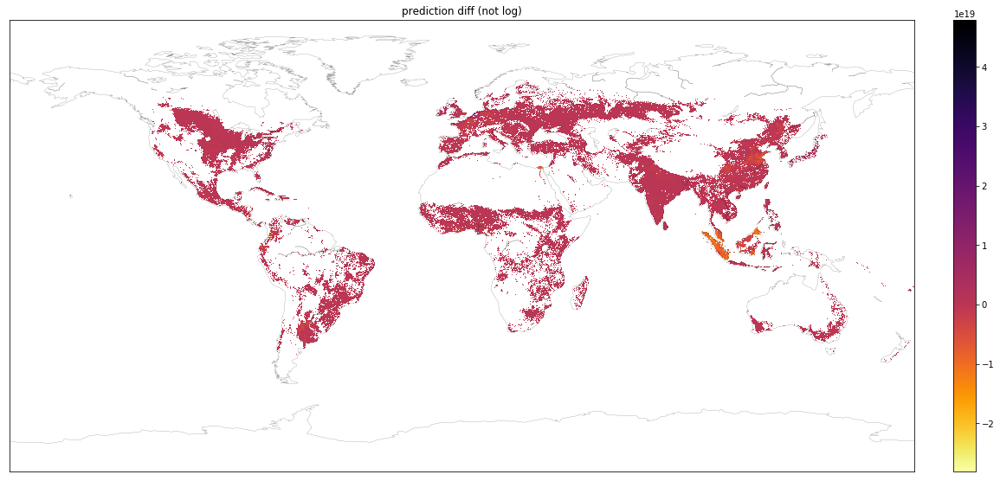

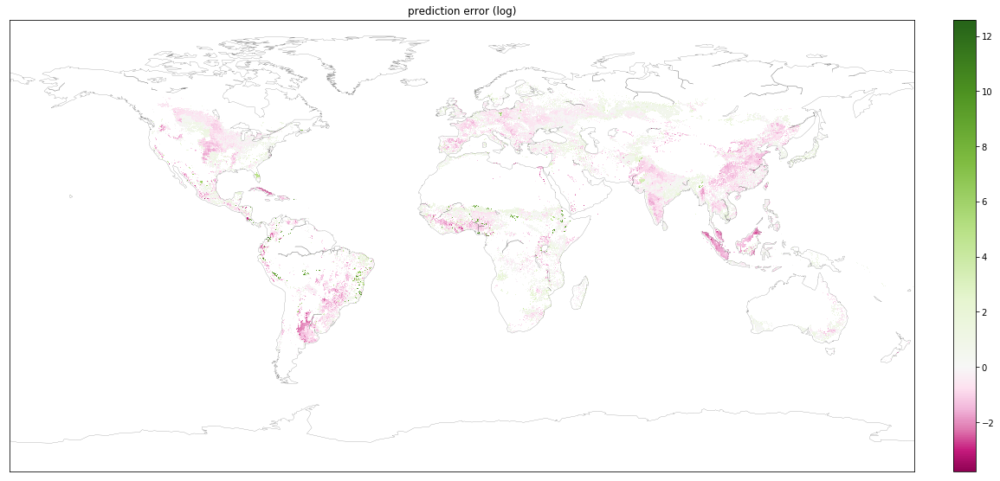

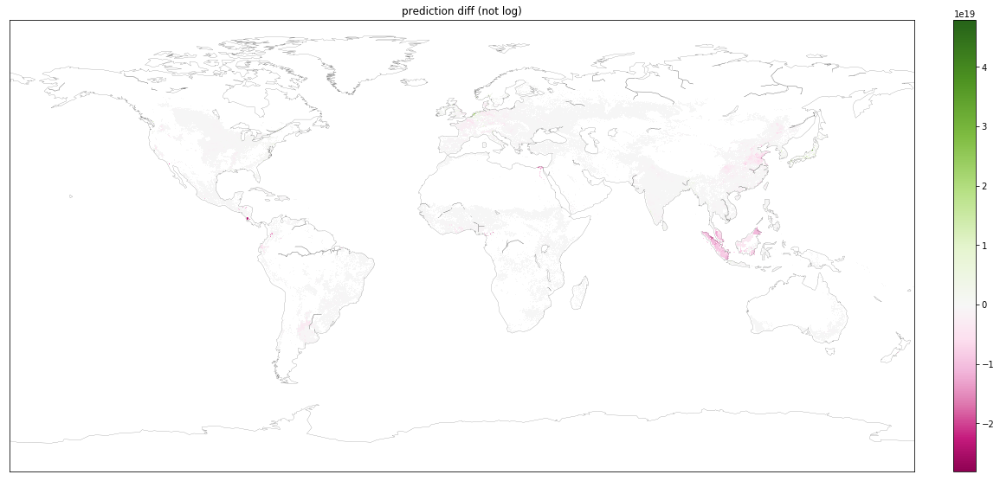

Maps & rasters done

Regression:
Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='random', tol=0.0001, warm_start=False)
Scatterplots done


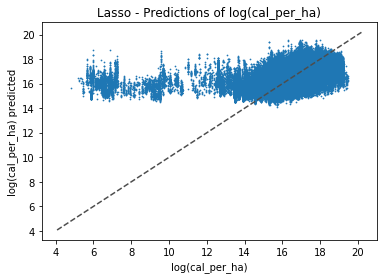

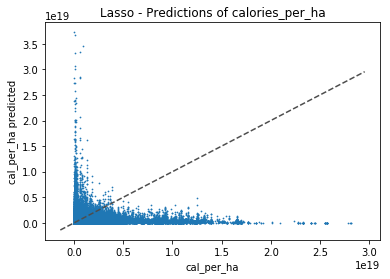

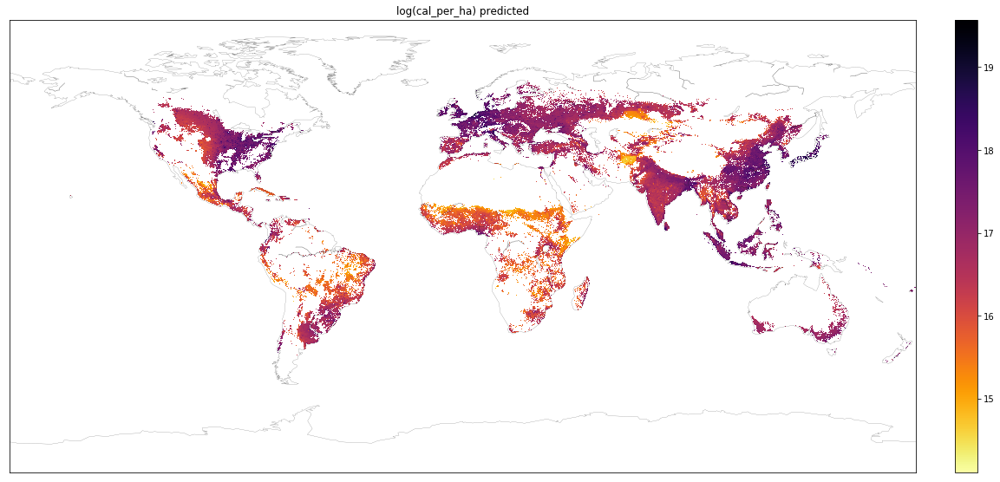

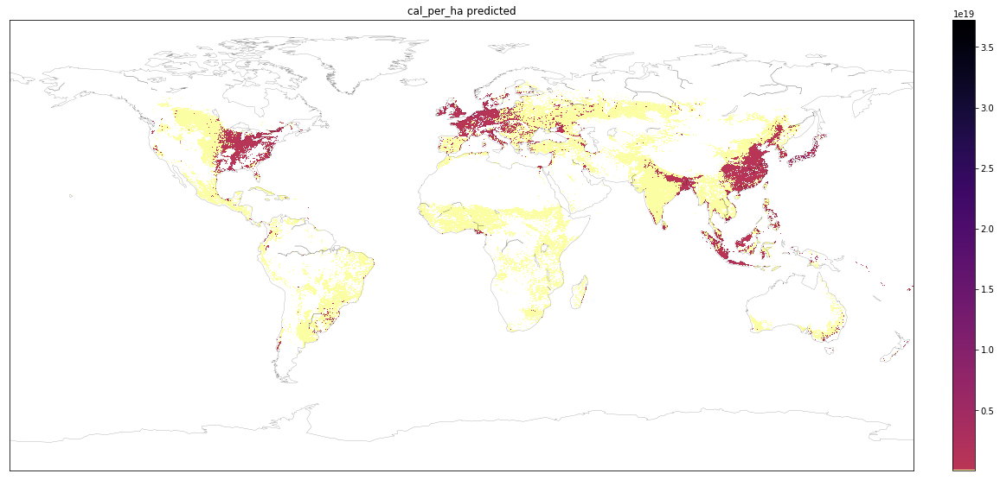

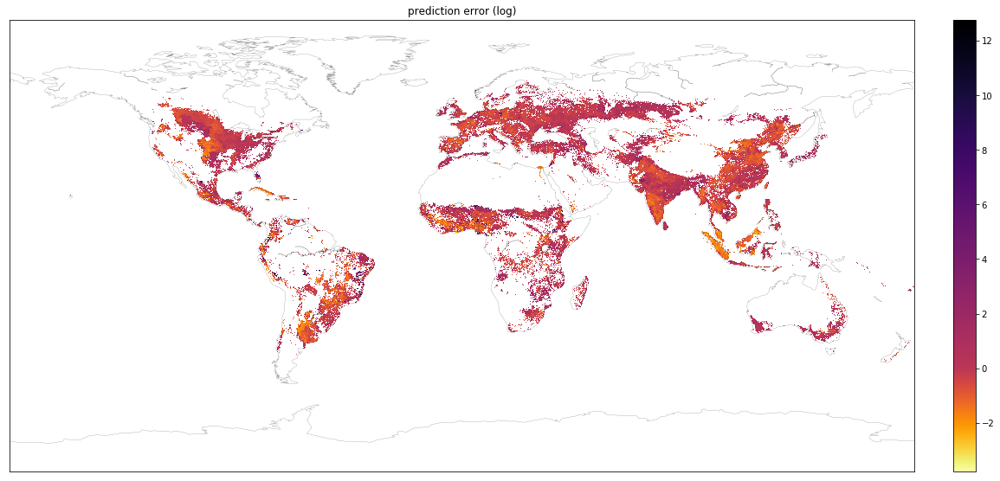

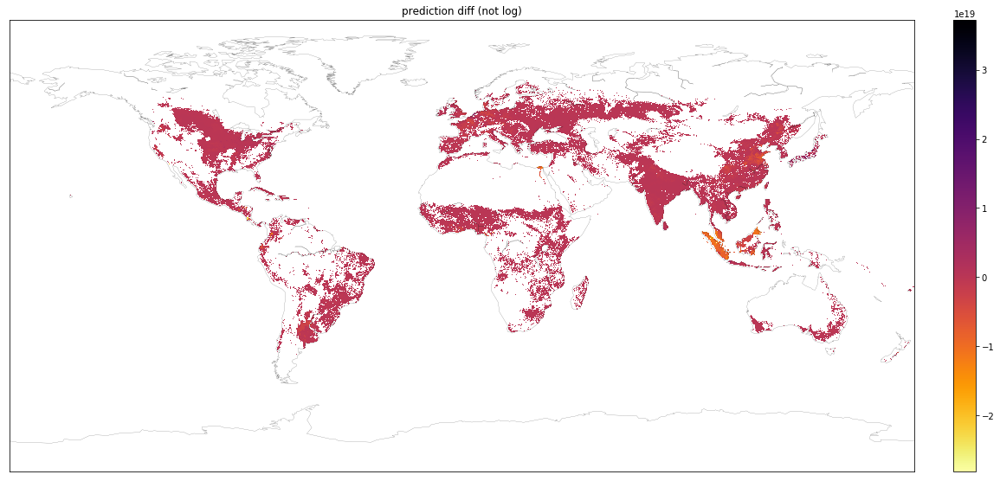

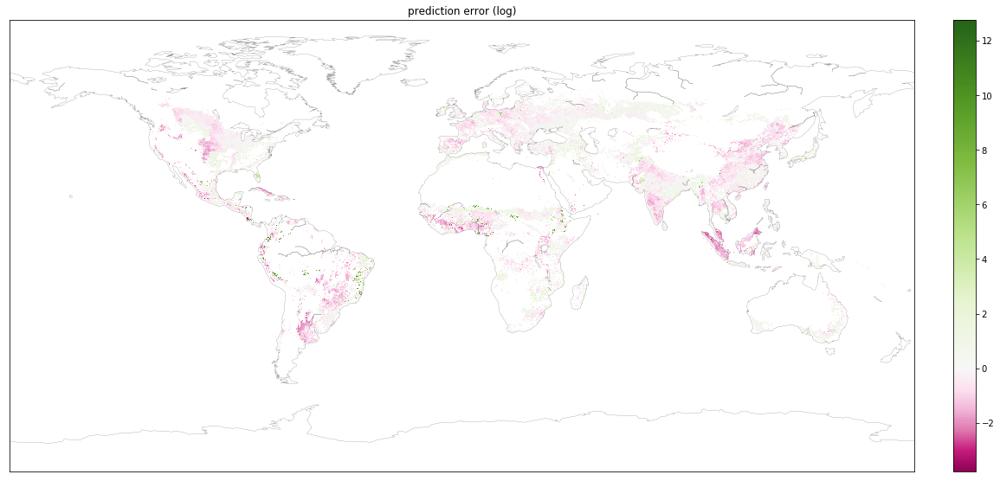

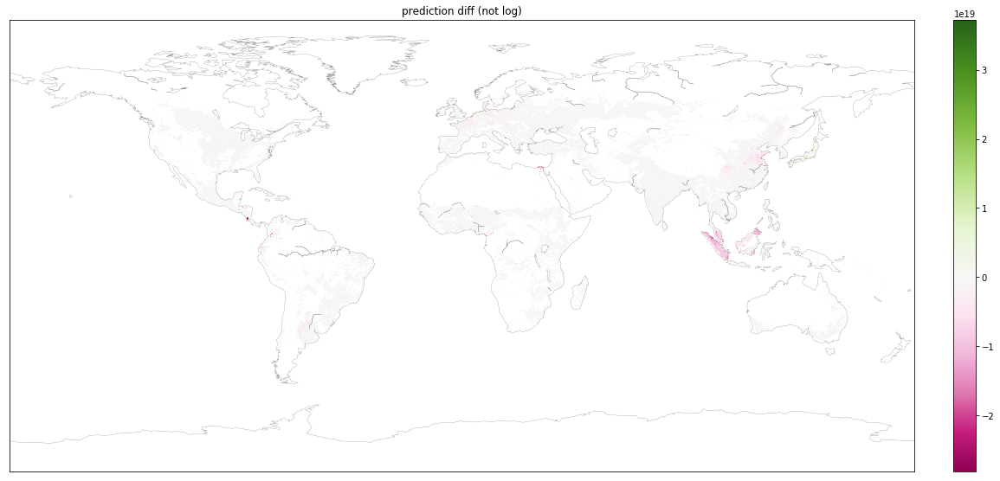

Maps & rasters done

Regression:
Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, random_state=None, solver='auto', tol=1e-06)
Scatterplots done


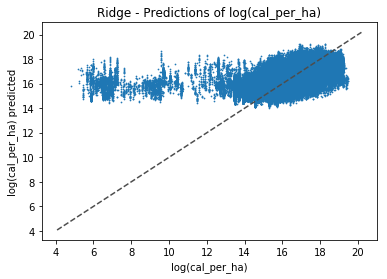

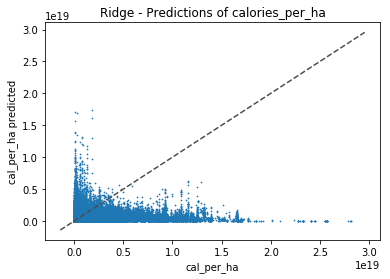

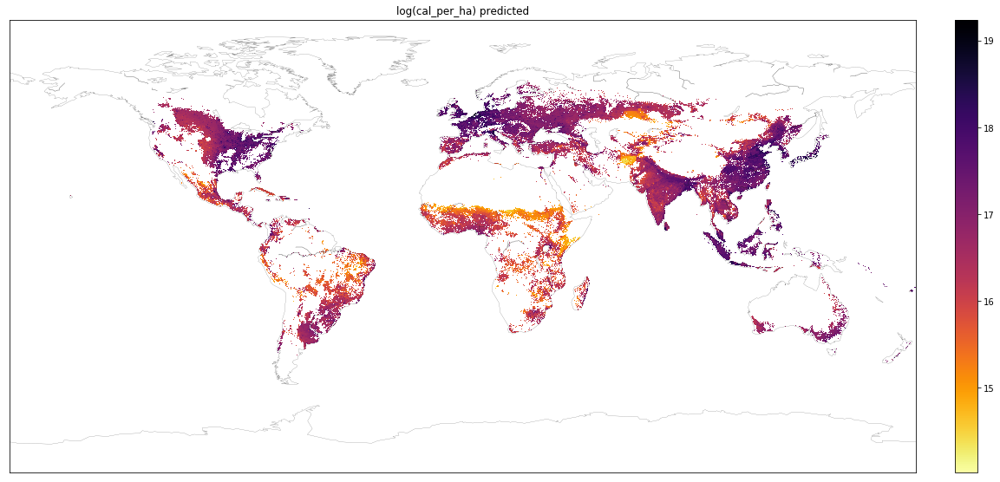

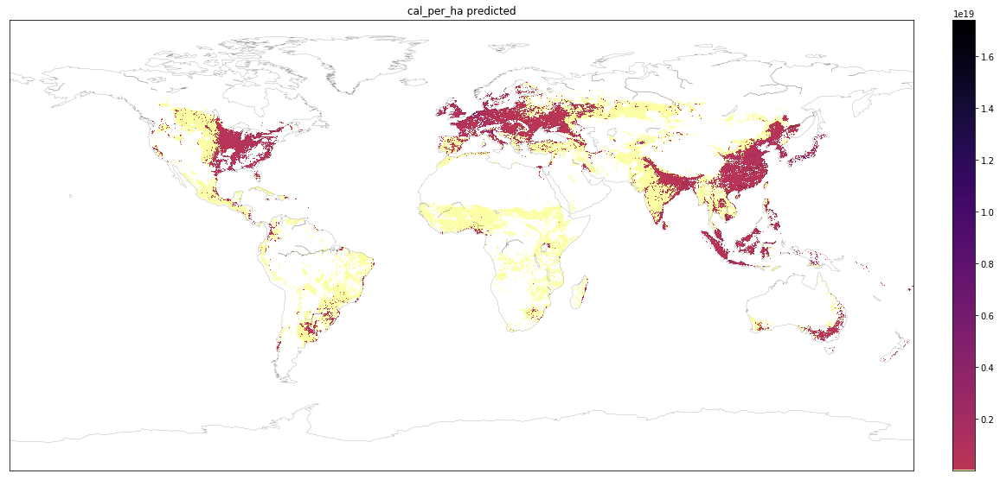

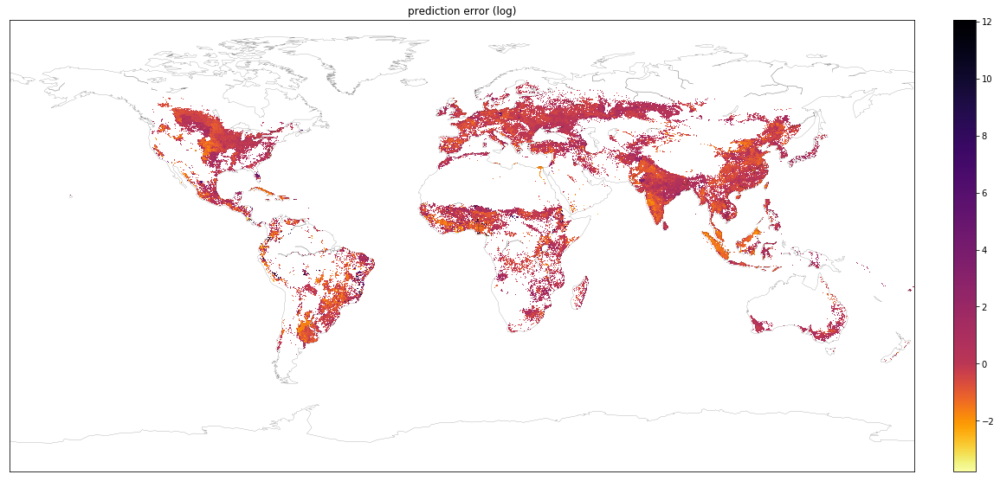

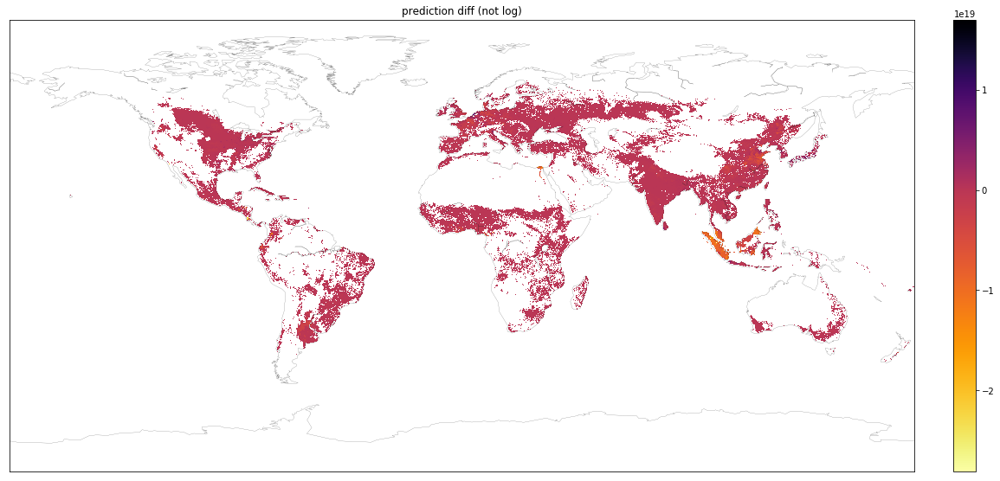

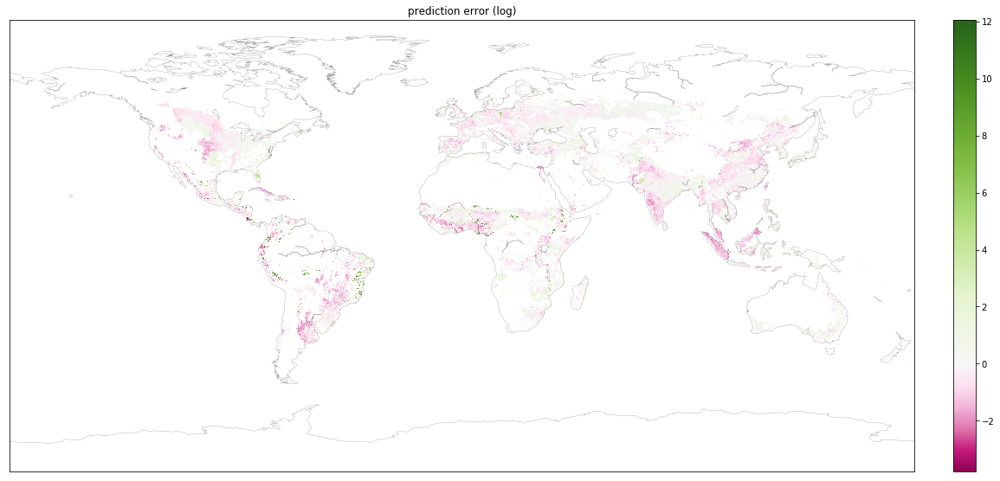

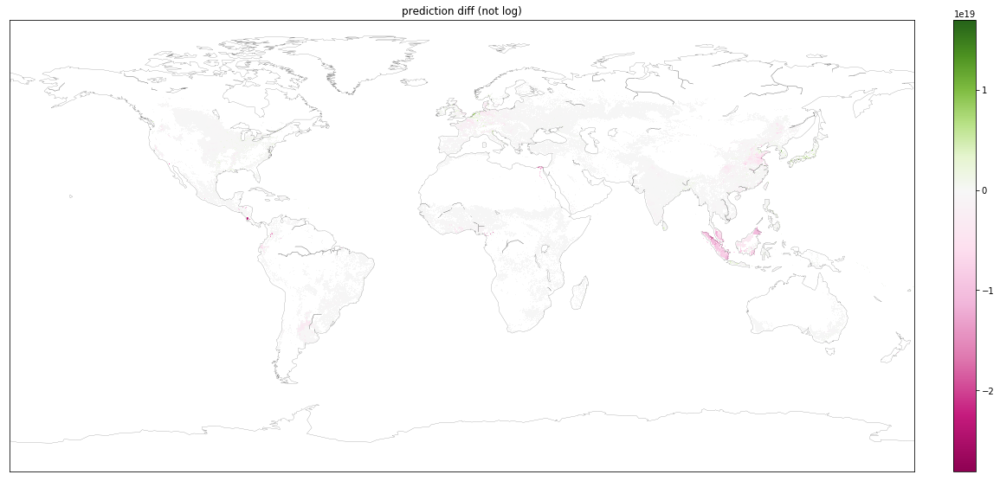

Maps & rasters done

Regression:
Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, random_state=None, solver='auto', tol=1e-06)
Scatterplots done


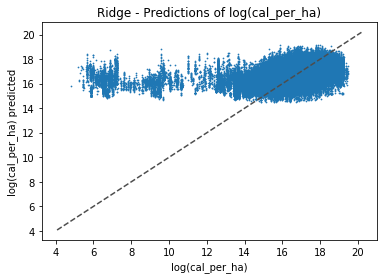

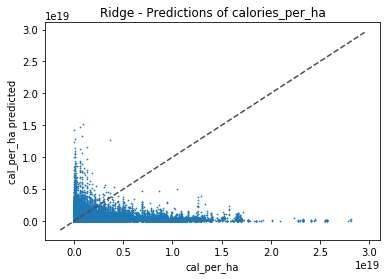

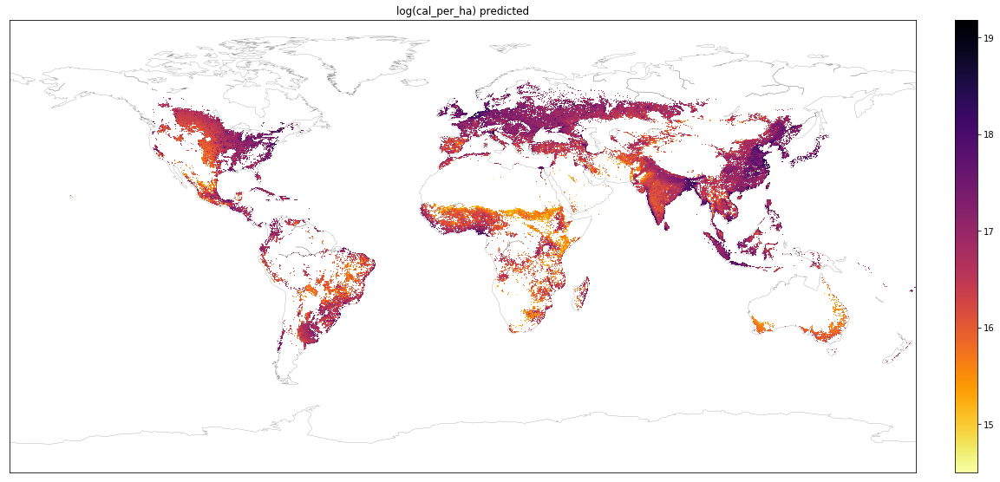

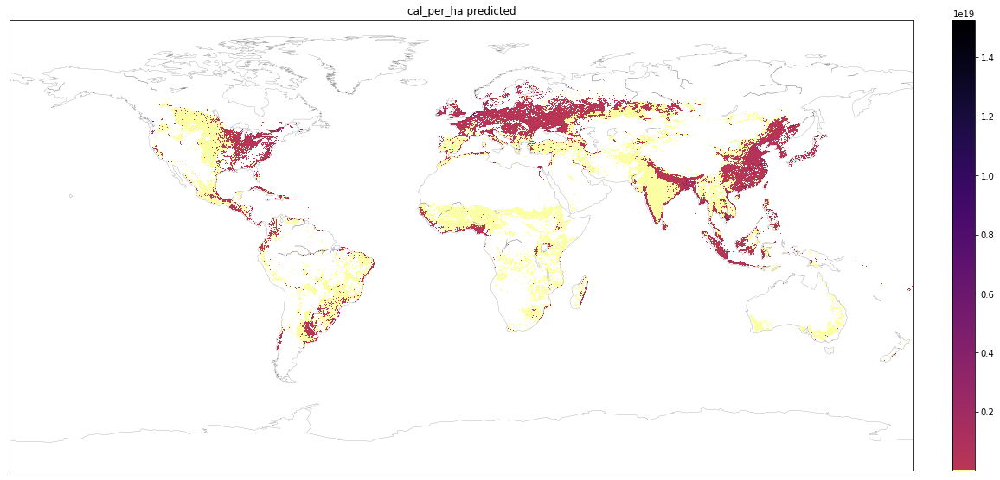

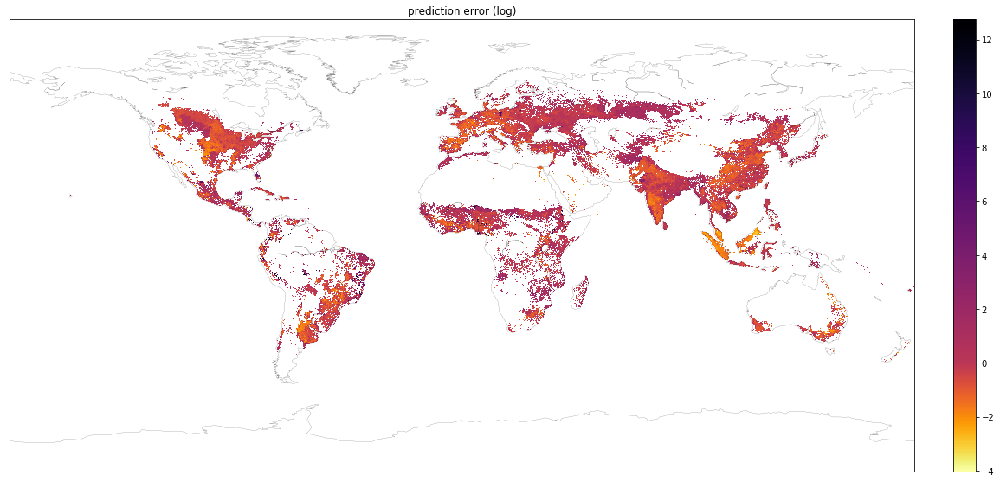

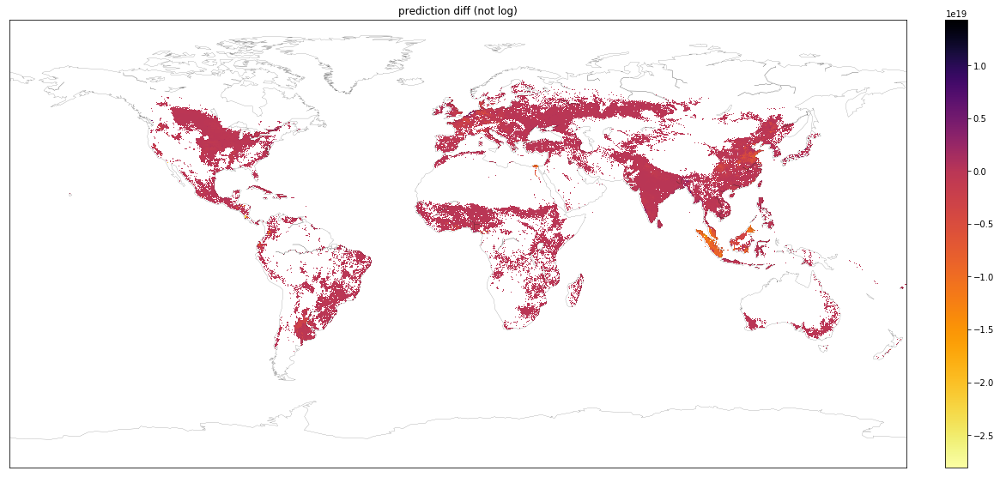

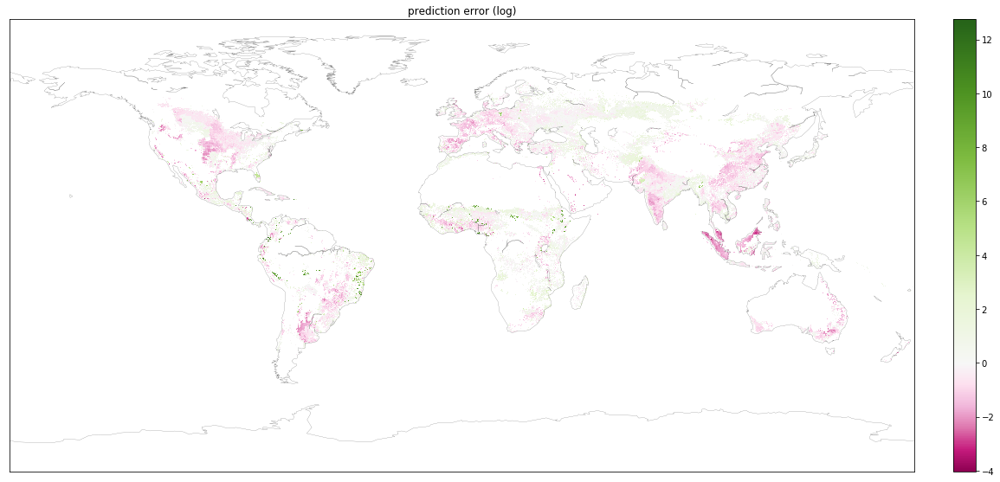

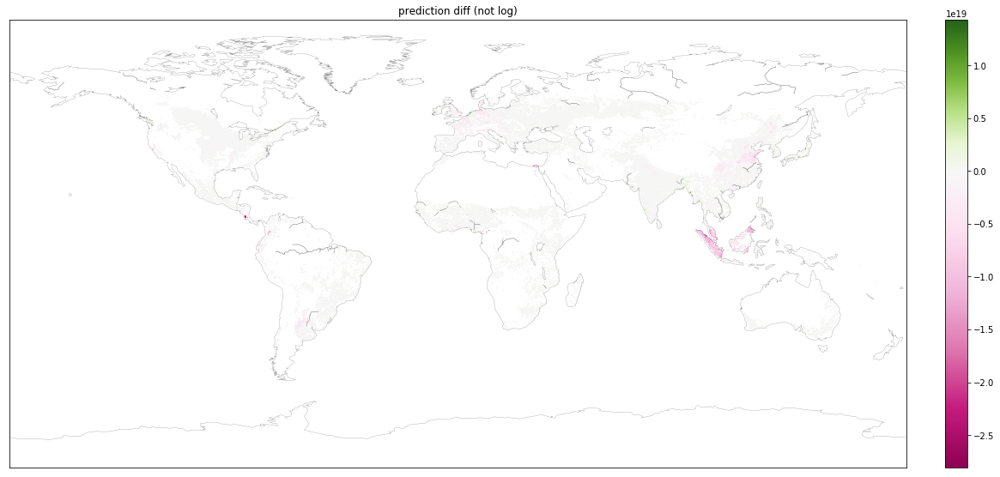

Maps & rasters done

Regression:
Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, random_state=None, solver='auto', tol=1e-06)
Scatterplots done


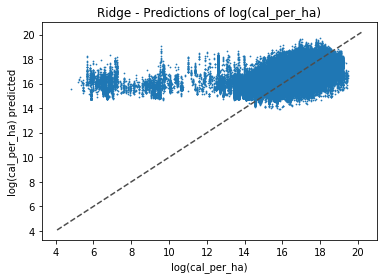

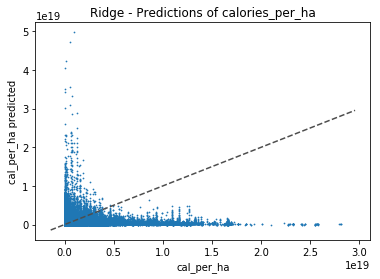

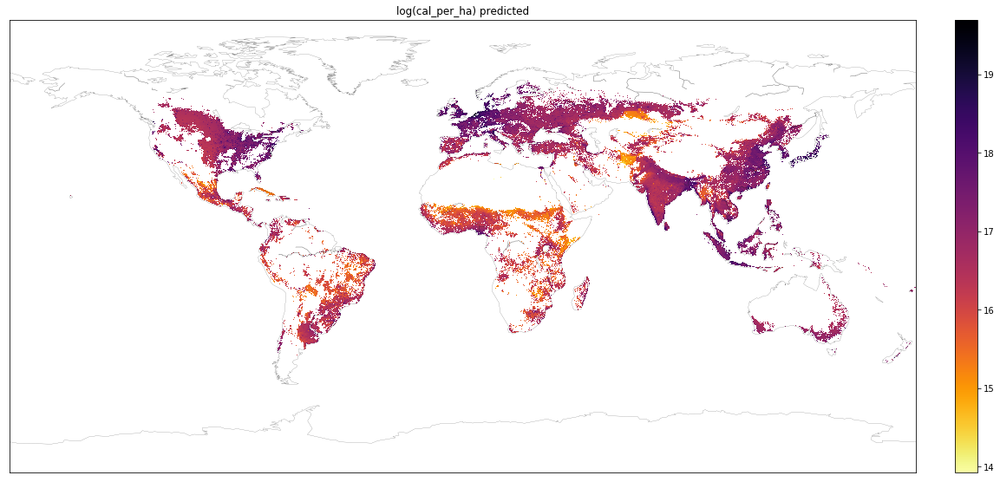

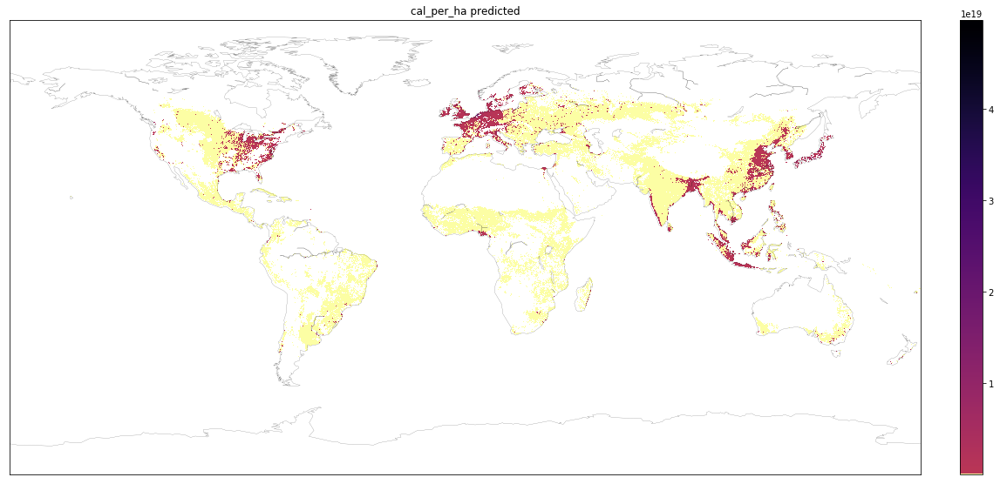

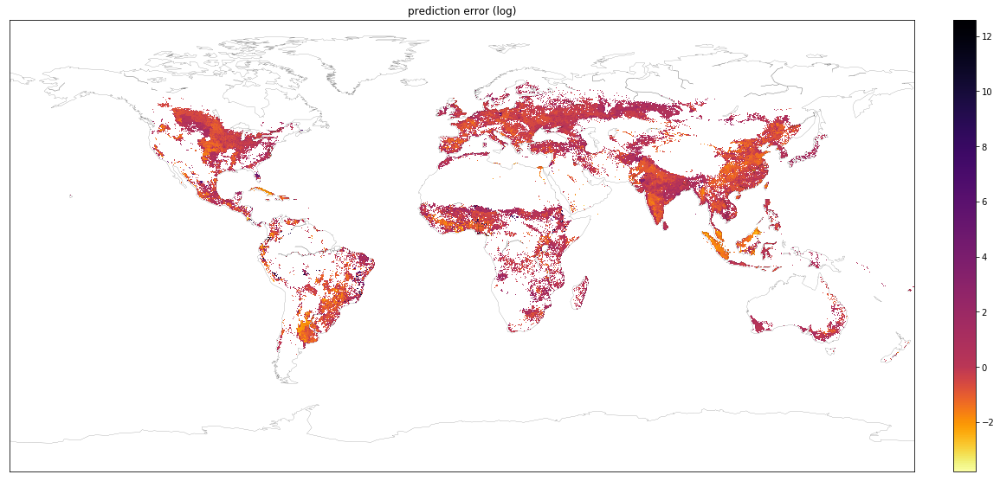

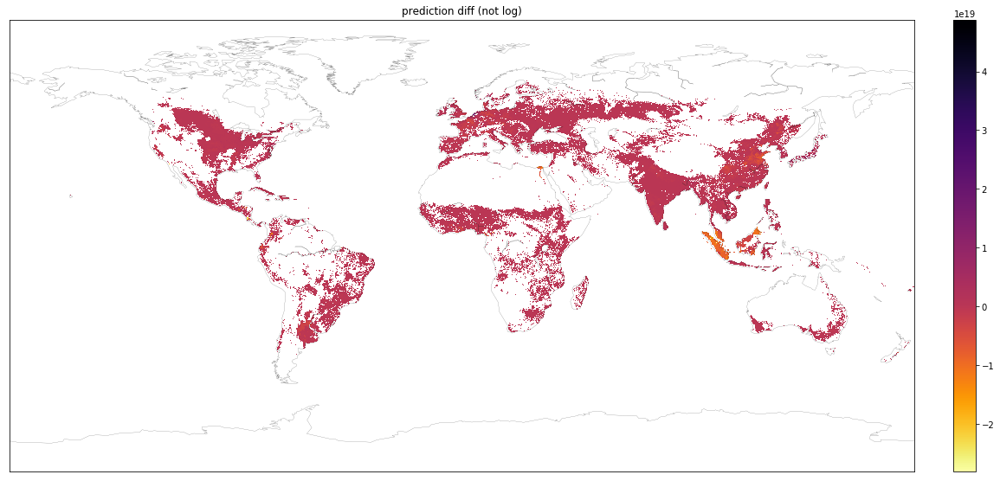

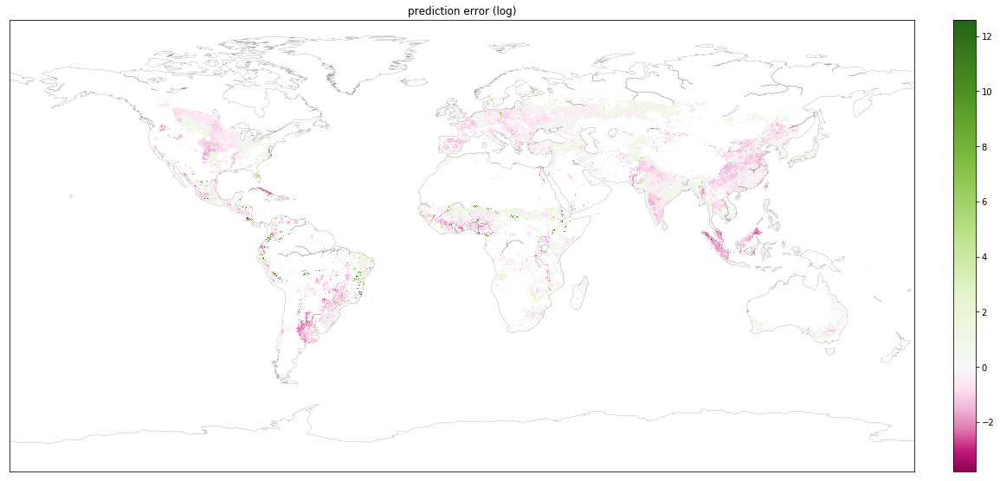

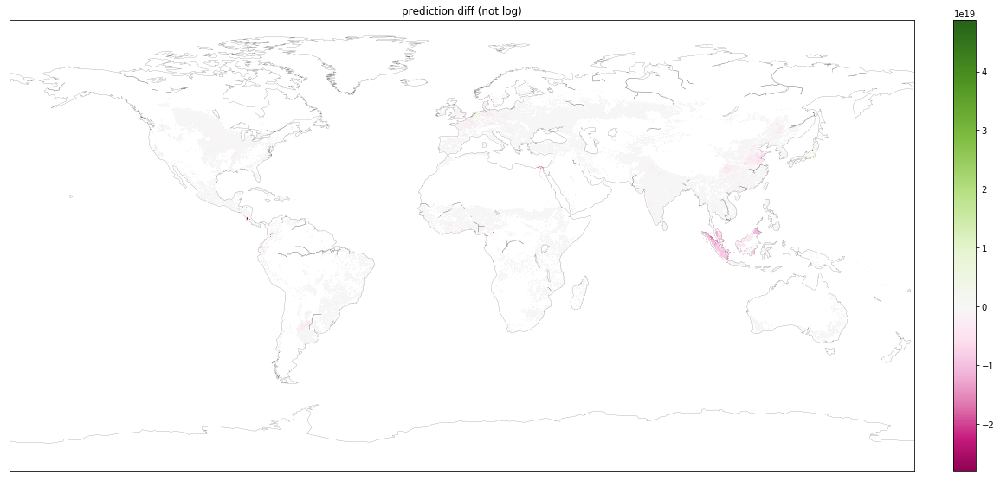

Maps & rasters done

Regression:
Ridge(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, random_state=None, solver='auto', tol=1e-06)
Scatterplots done


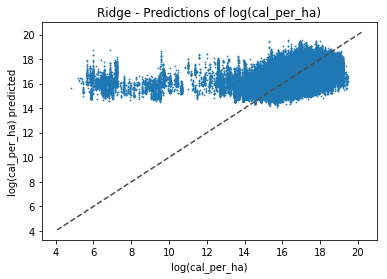

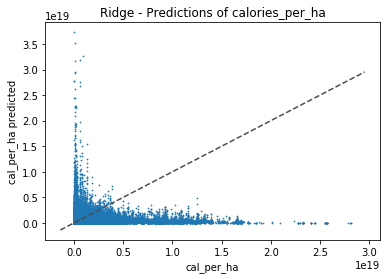

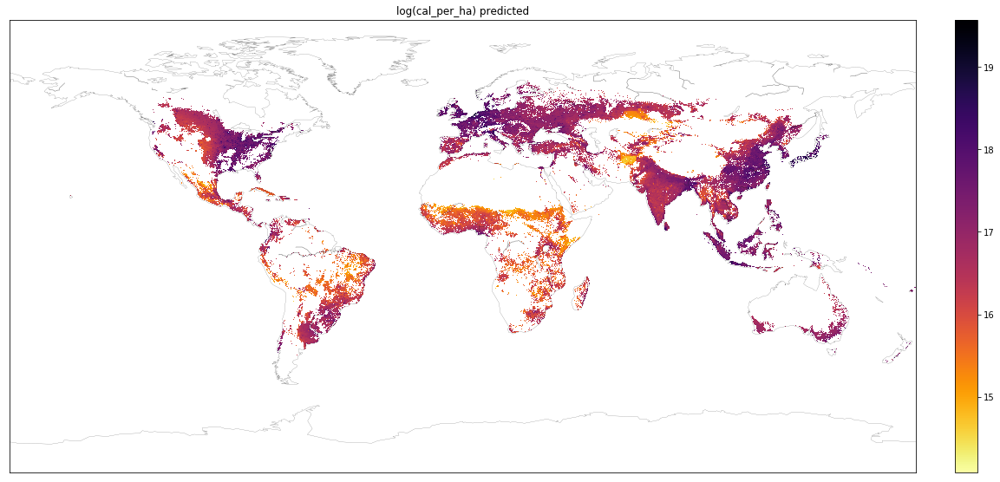

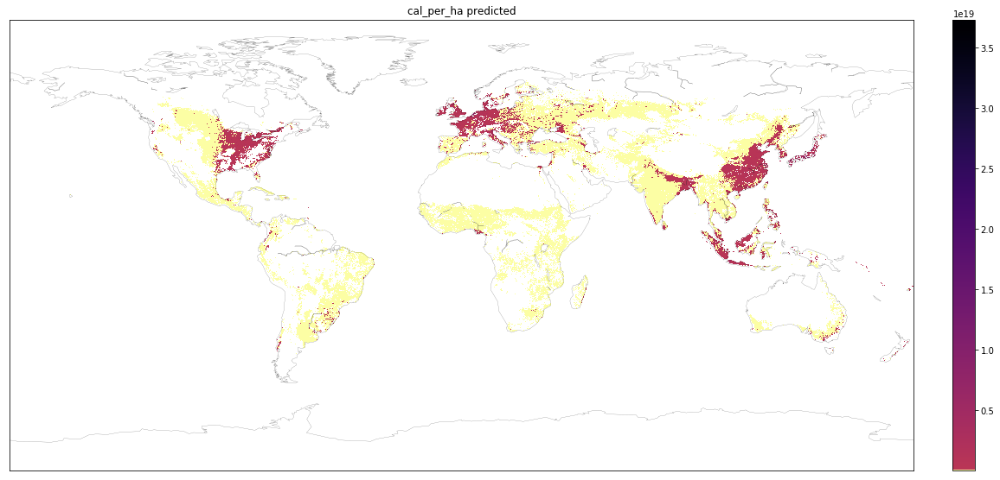

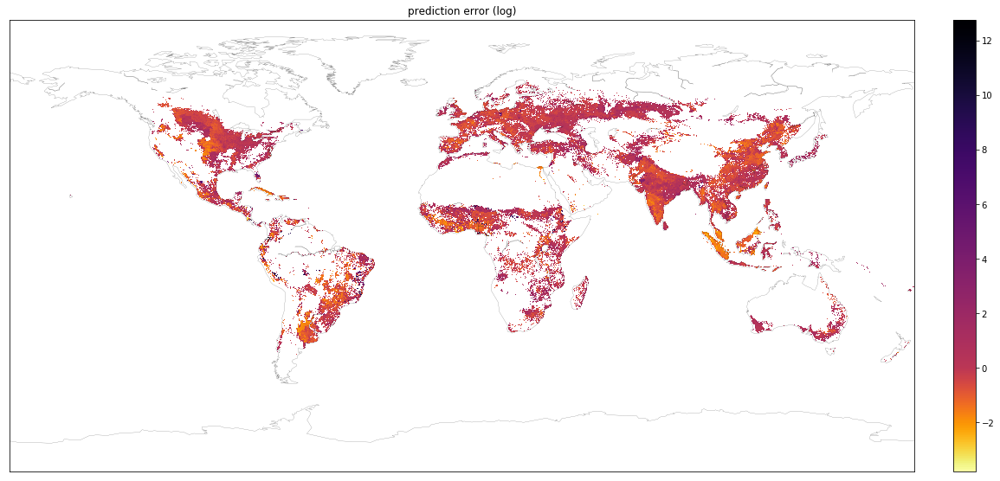

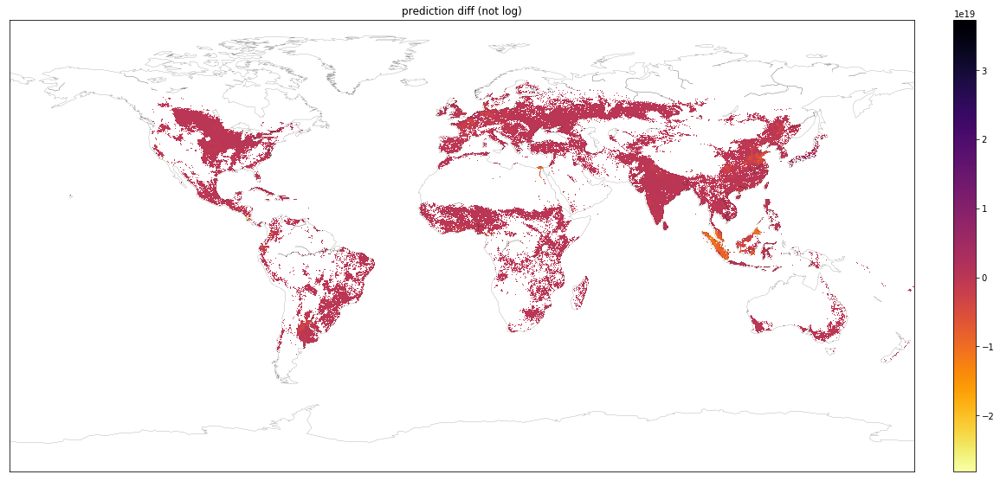

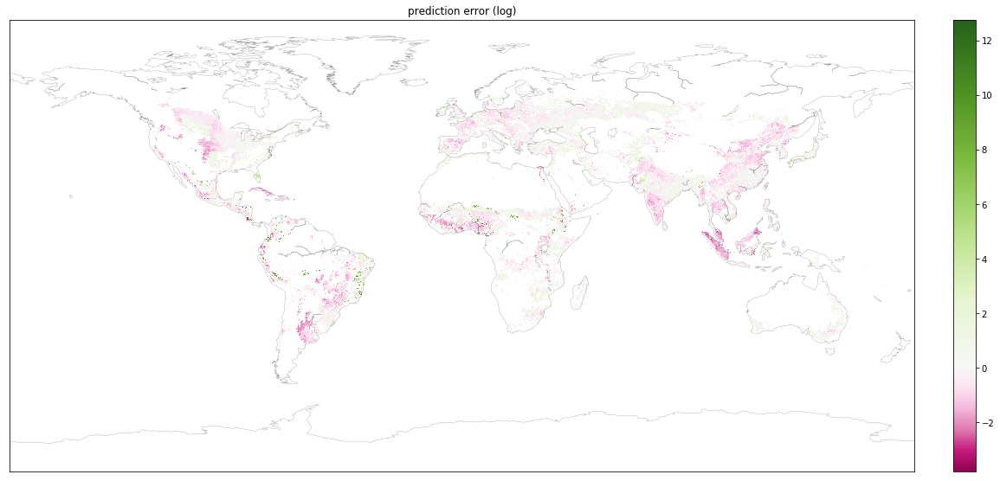

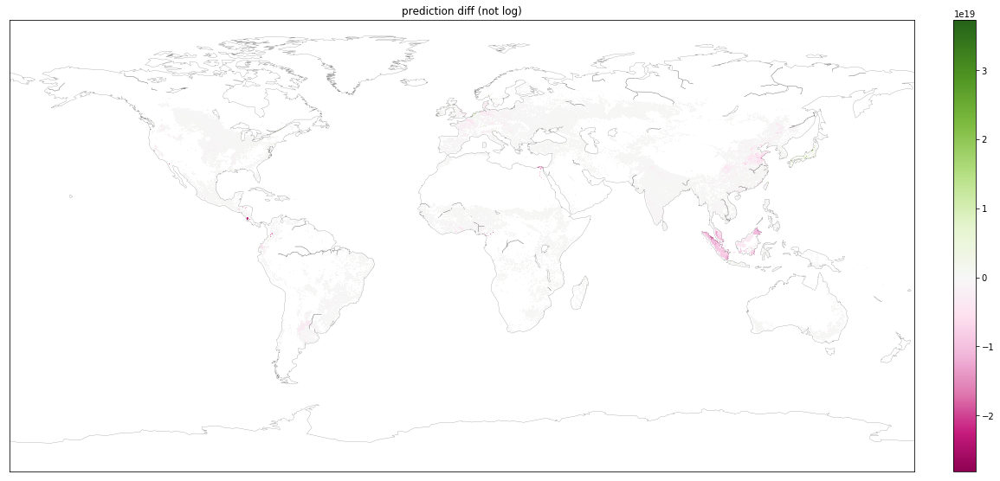

Maps & rasters done

Regression:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)
Scatterplots done


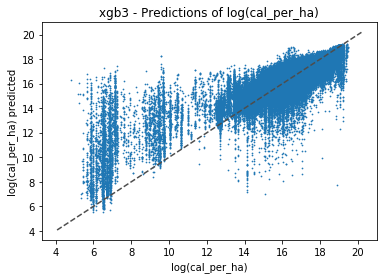

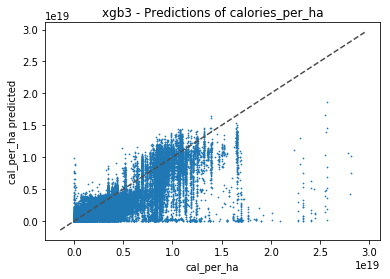

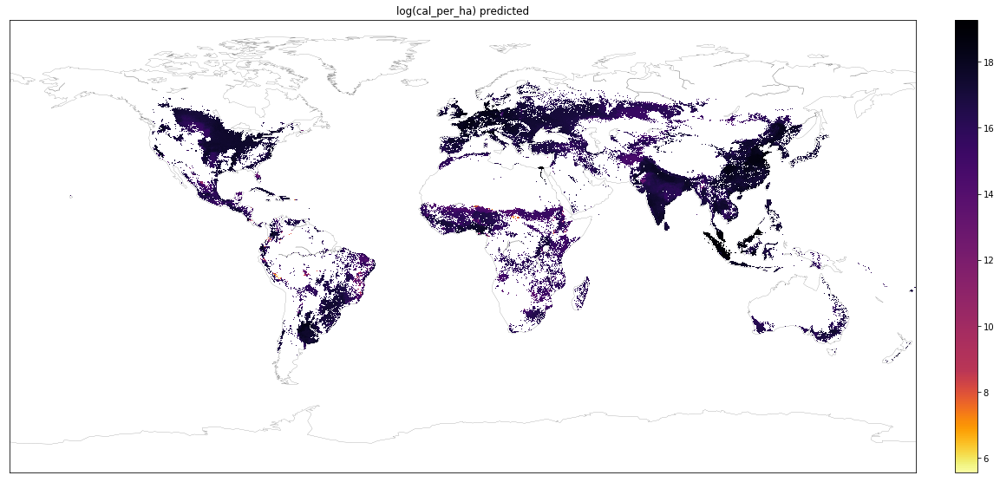

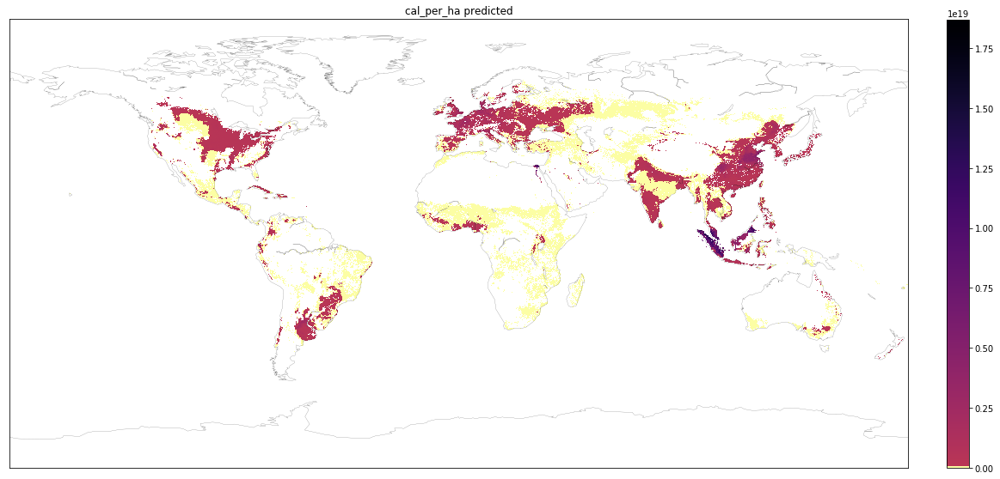

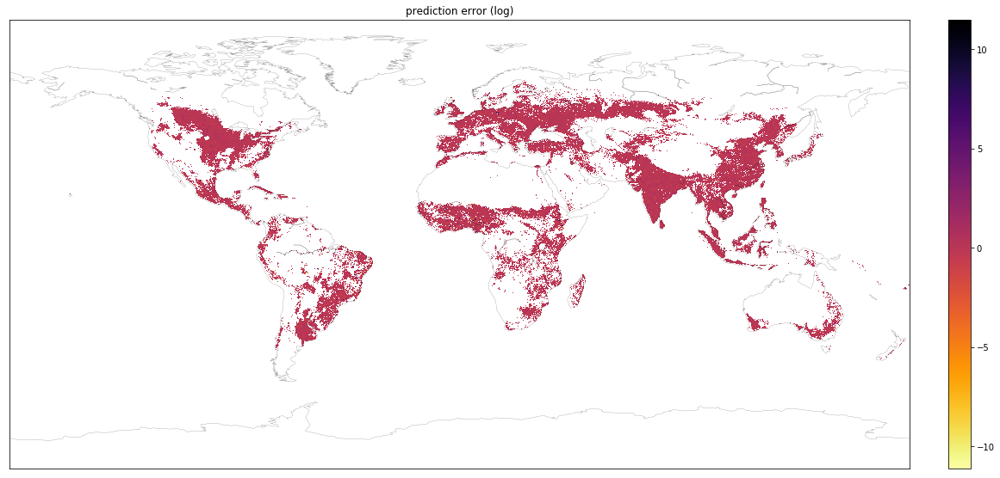

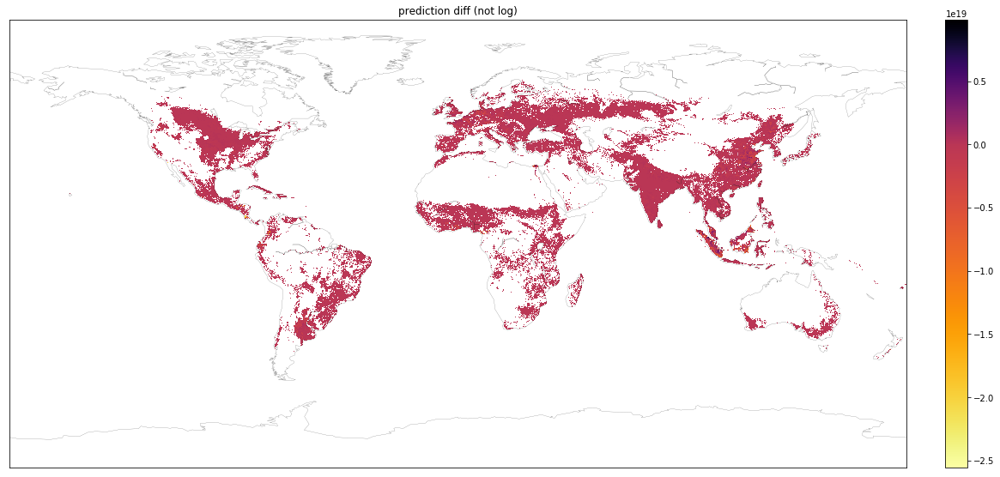

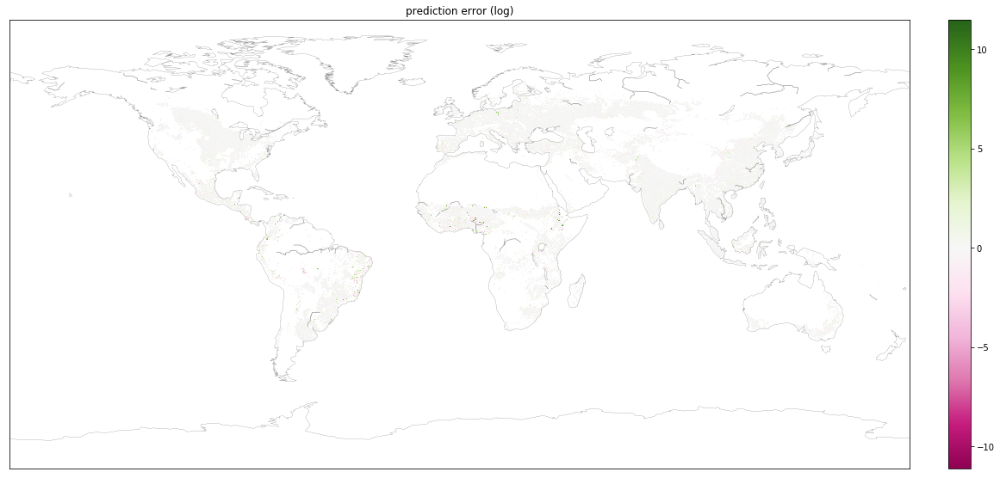

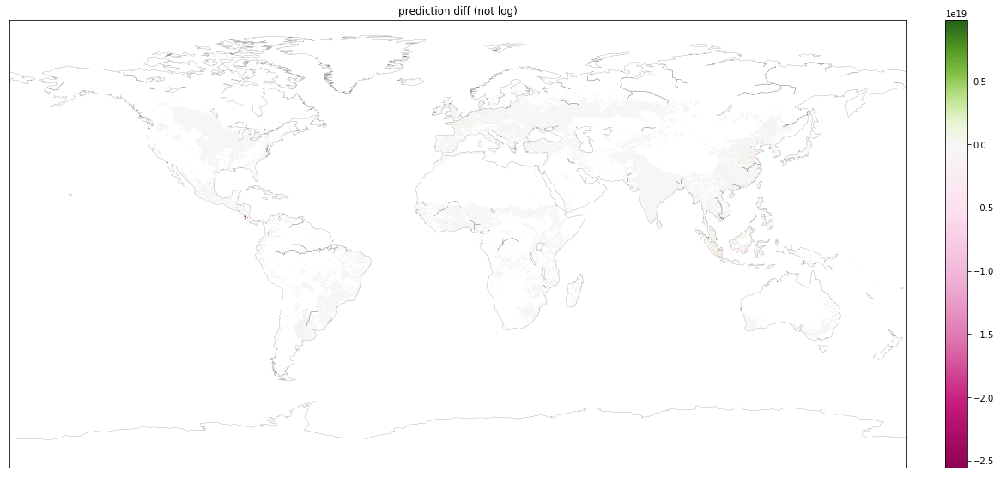

Maps & rasters done

Regression:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)
Scatterplots done


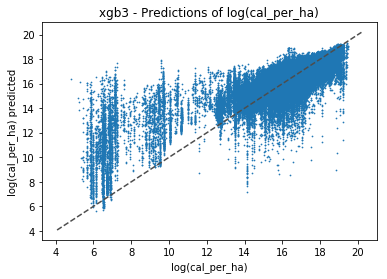

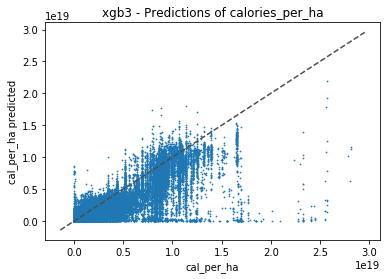

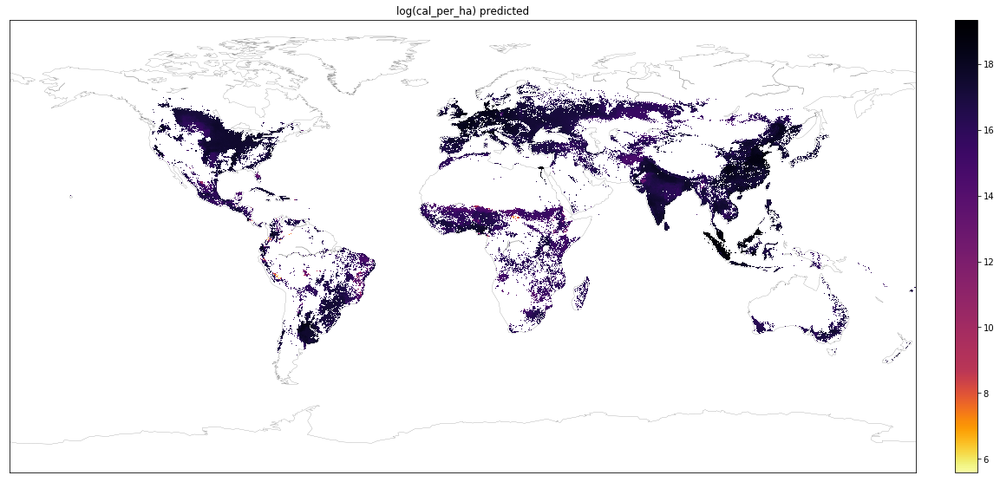

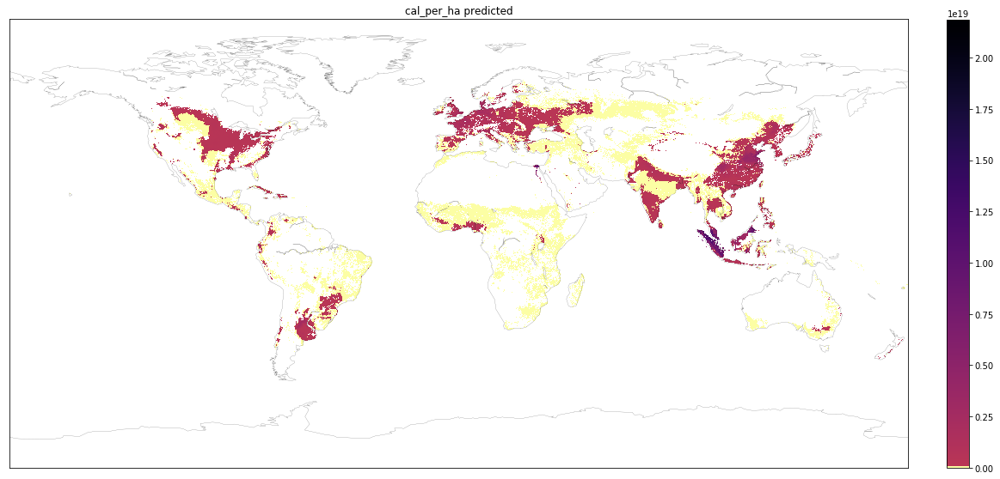

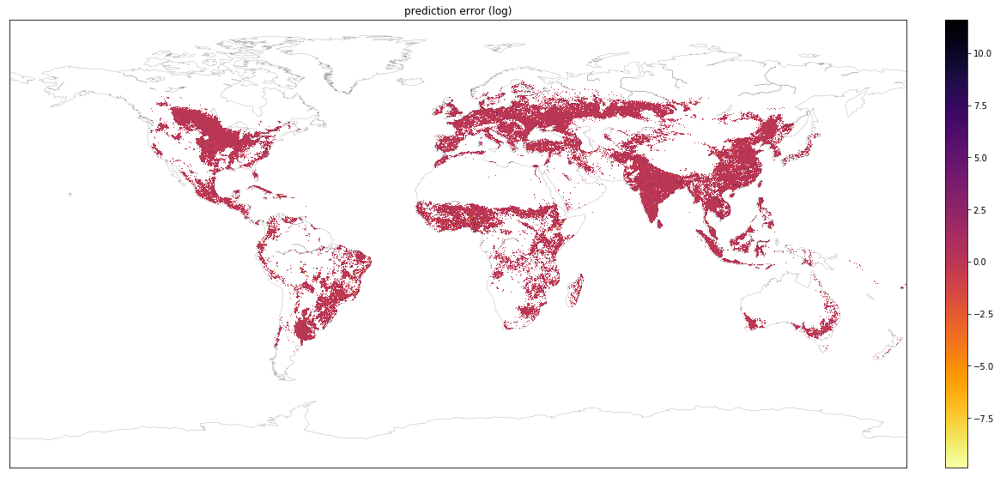

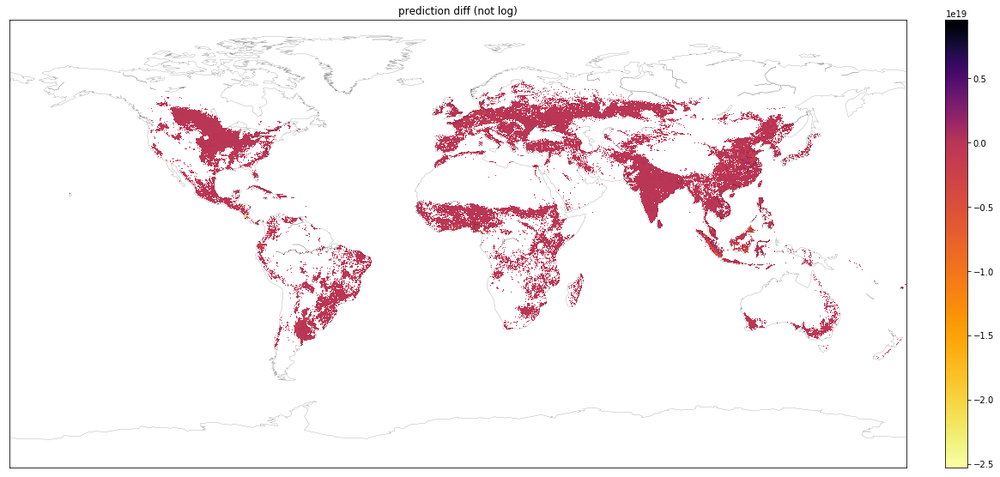

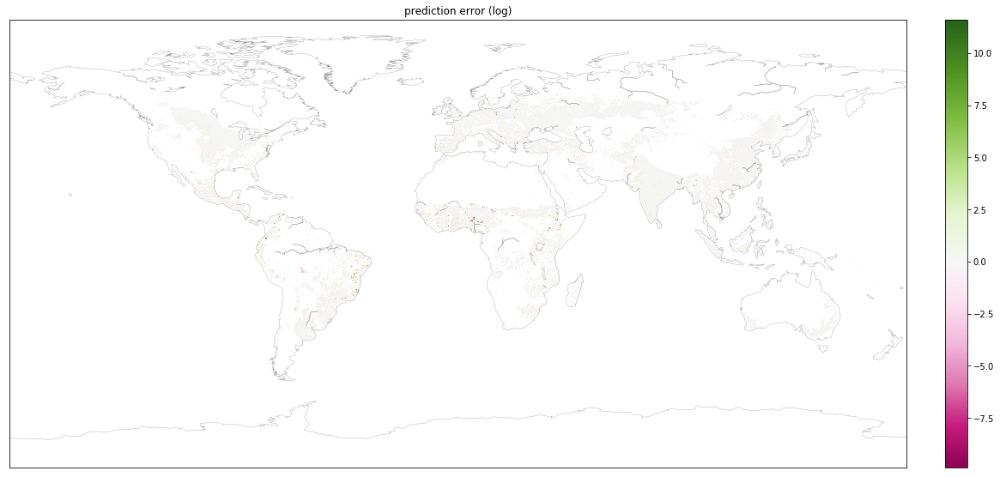

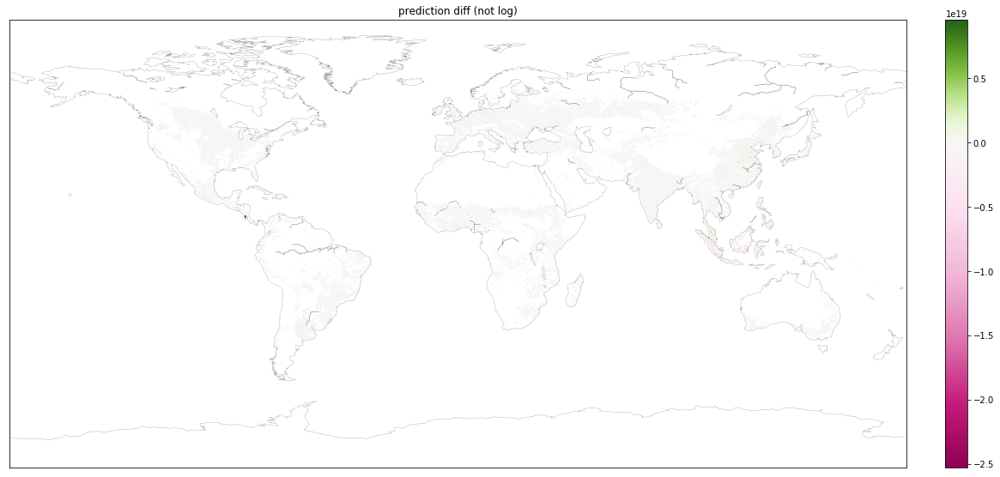

Maps & rasters done

Regression:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)
Scatterplots done


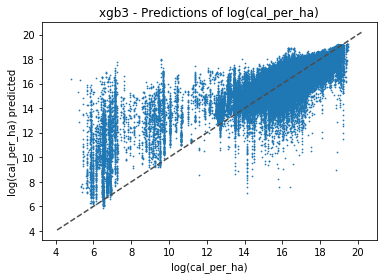

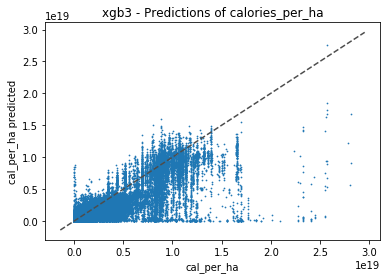

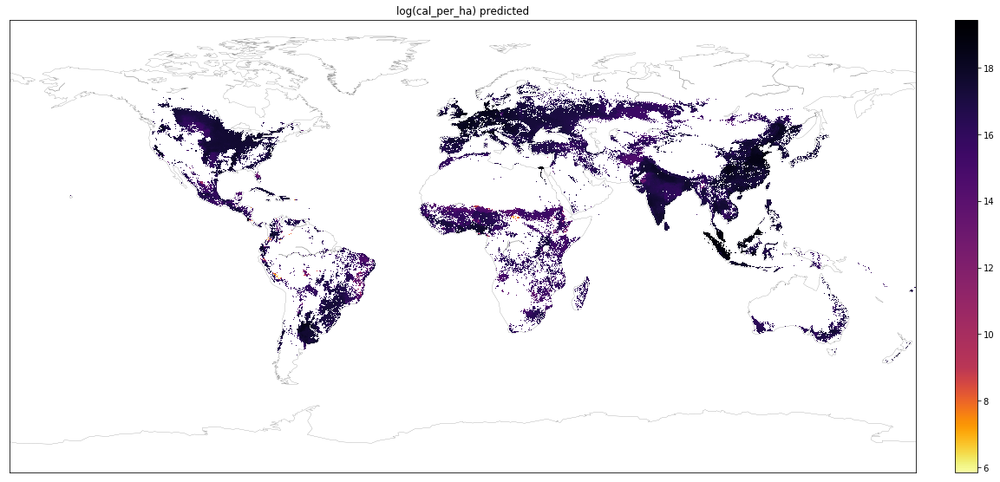

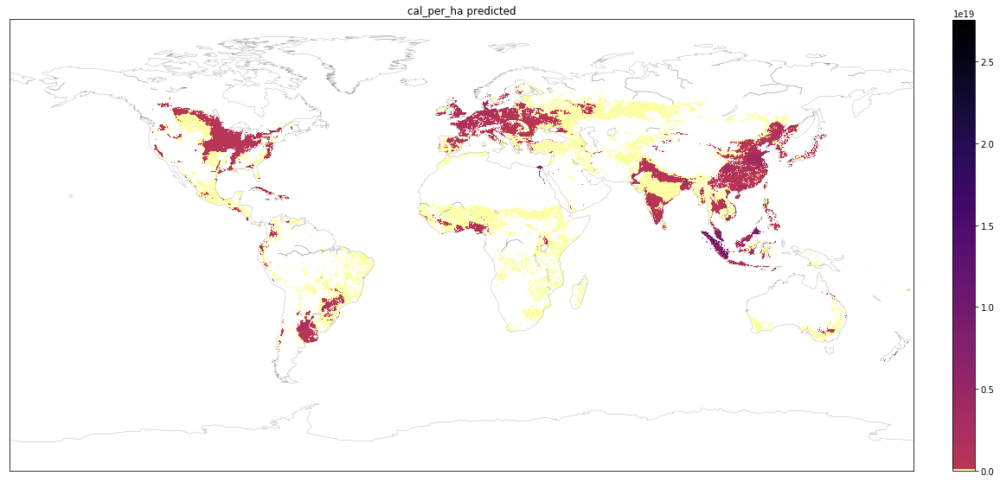

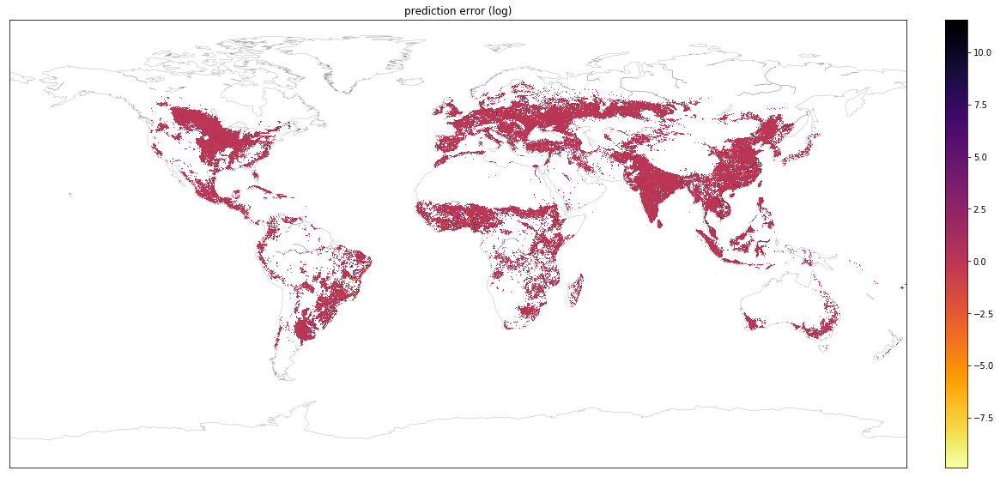

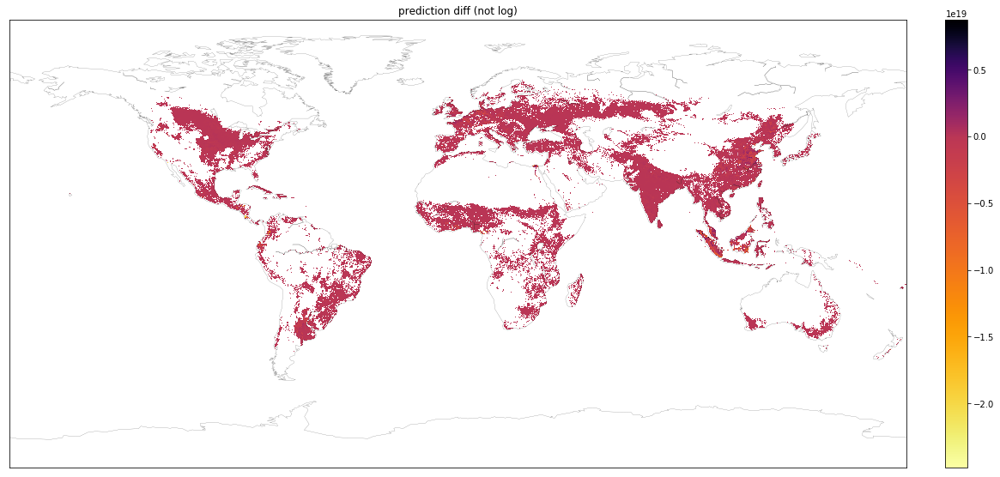

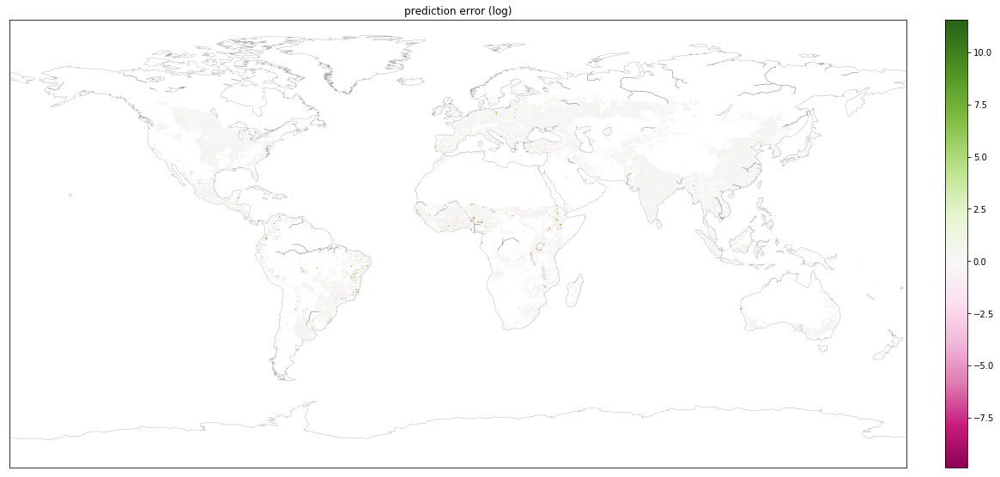

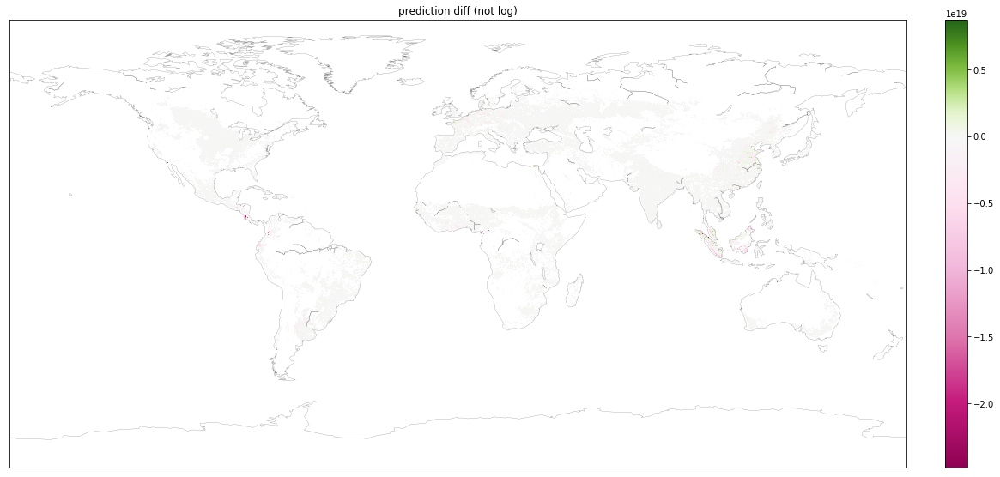

Maps & rasters done

Regression:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)
Scatterplots done


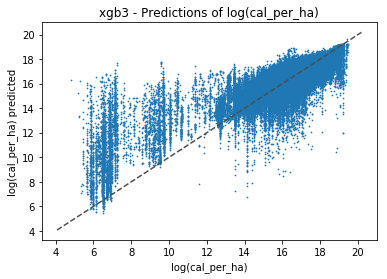

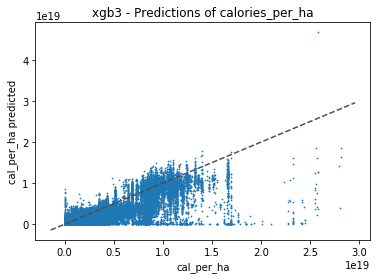

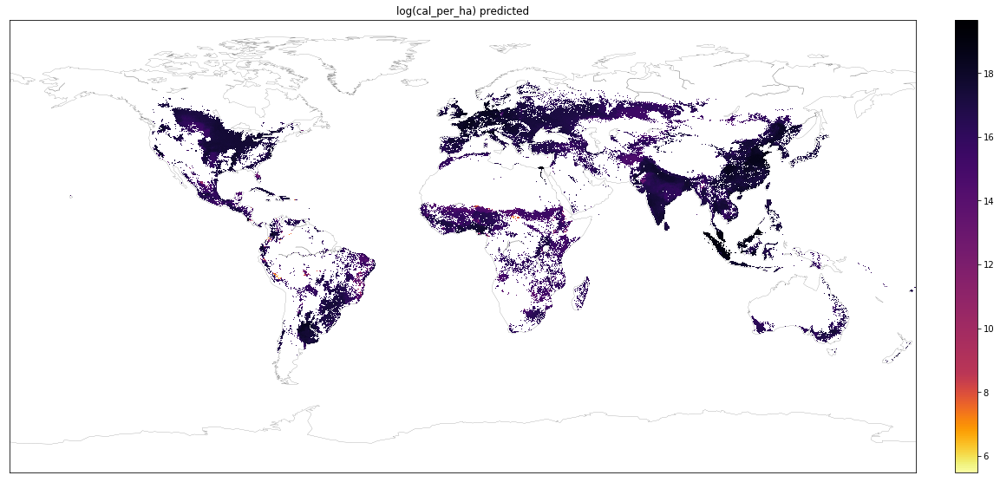

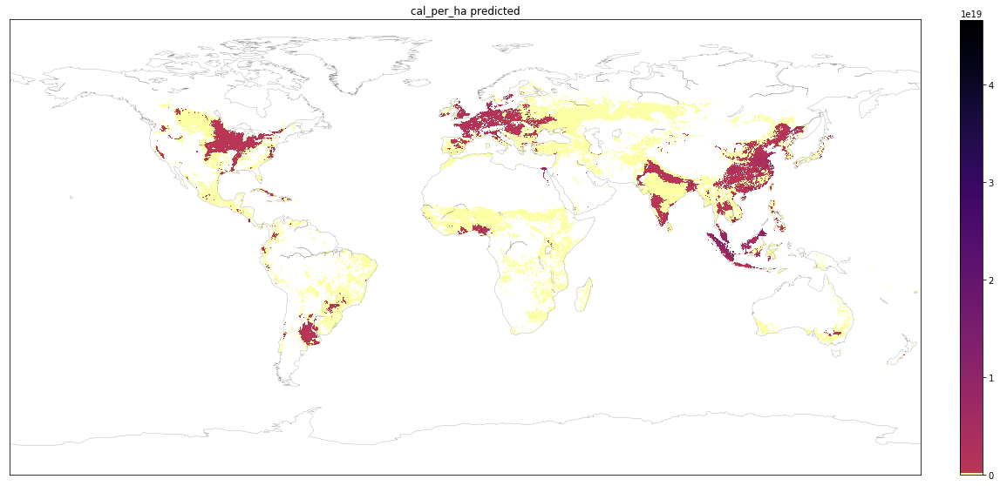

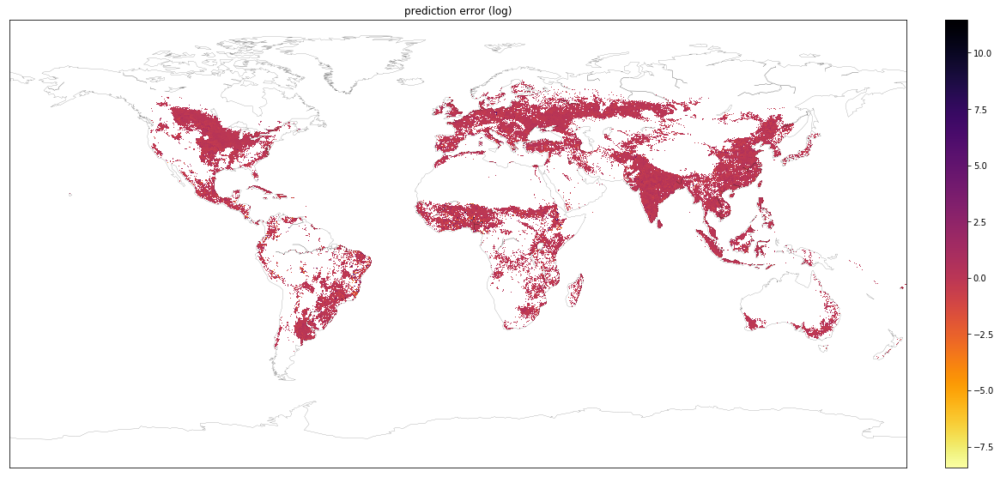

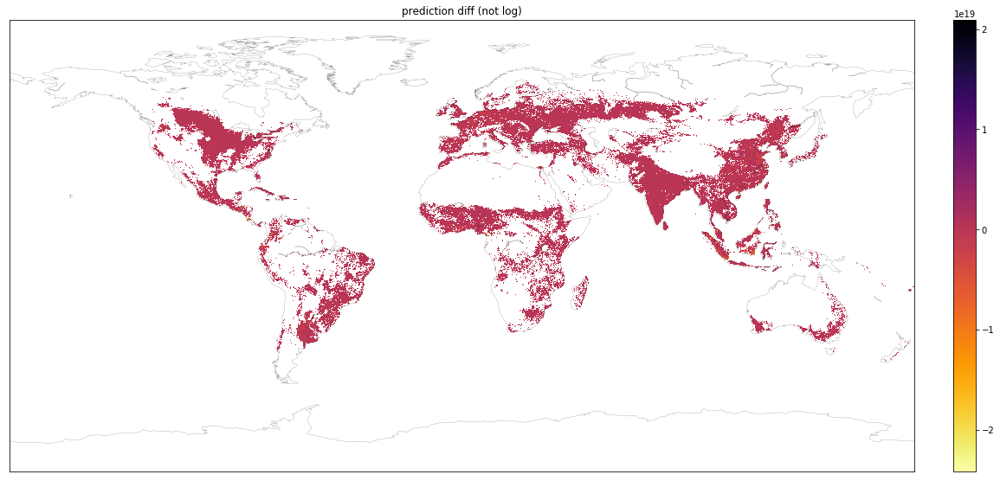

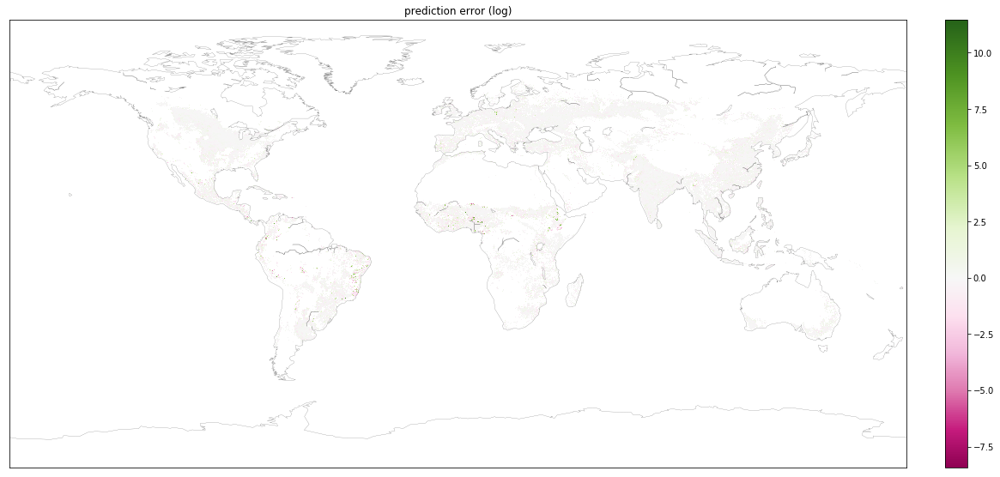

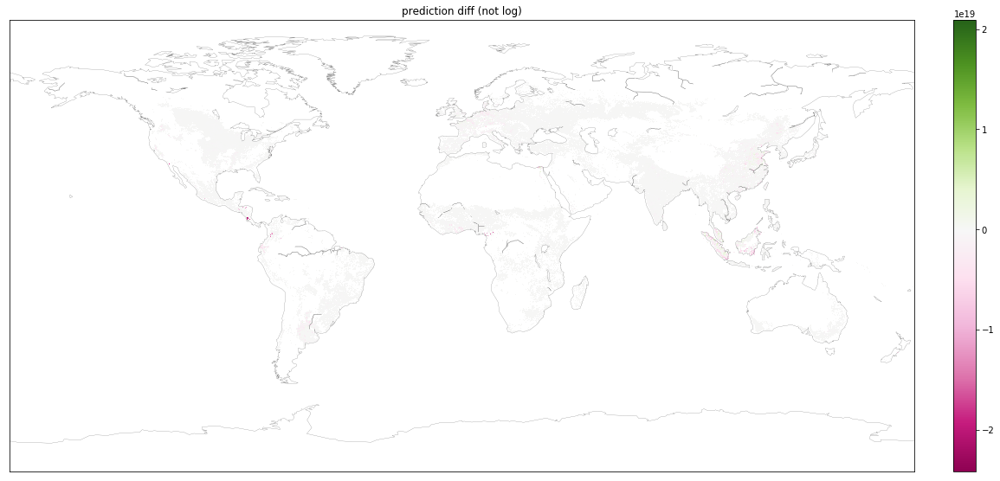

Maps & rasters done


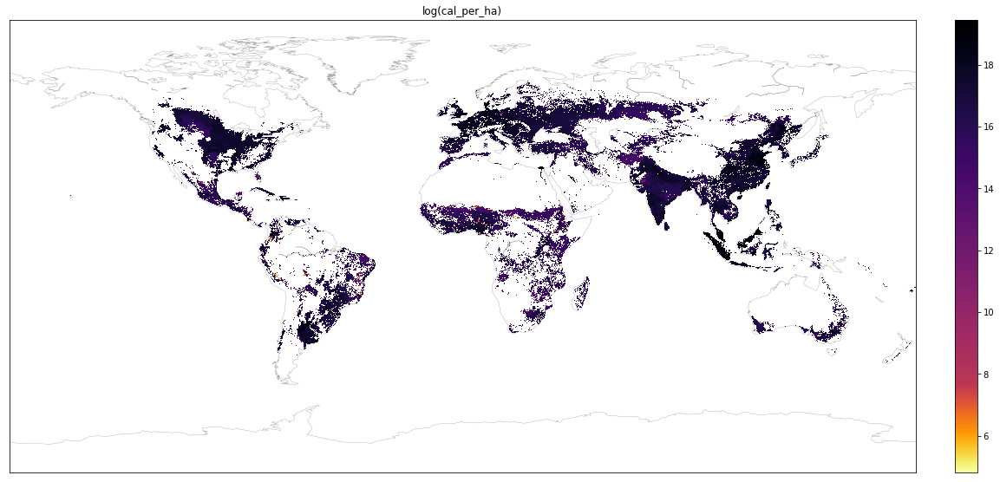

Baseline maps & rasters done


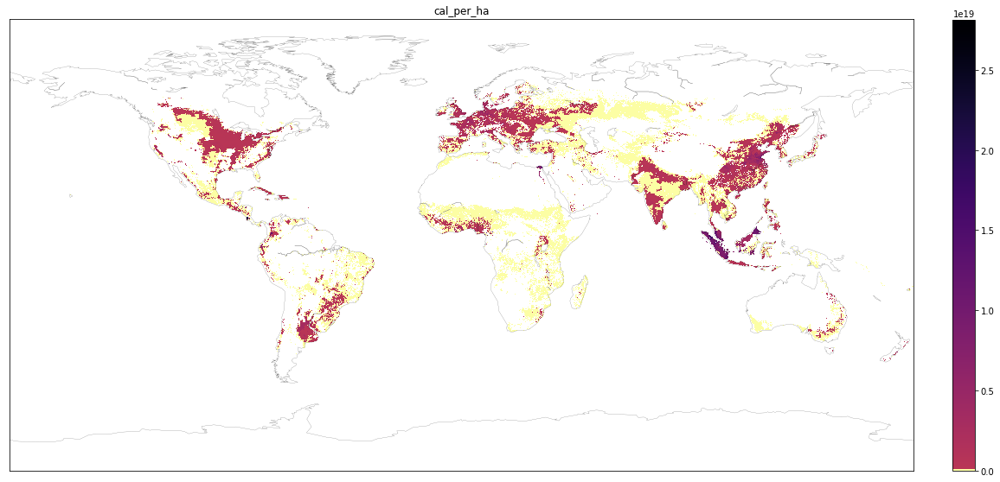

Baseline maps & rasters done


In [104]:
for model in ['Linear','Lasso','Ridge','xgb3']: # TO DO Poly
    for subset in ['','simplesubset','simplesubset_gdp','wo_climzones']:
        
        X = baseline_df.drop(['calories_per_ha'], axis=1)
        y = baseline_df['calories_per_ha']
            
        # Load model
        regression = load_regression(model+subset)
        print('\nRegression:')
        print(regression)

        # Subset 
        if subset == 'simplesubset':
            X_cols = [x for x in simple_subset if x !='calories_per_ha']
            X = X[X_cols]
        elif subset == 'simplesubset_gdp':
            X_cols = [x for x in simple_subset_gdp if x !='calories_per_ha']
            X = X[X_cols]
        elif subset == 'wo_climzones':
            X_cols = [x for x in columns_without_climatezones if x !='calories_per_ha']
            X = X[X_cols]

        # Apply model
        y_predicted = regression.predict(X)
        compare = predictions_df()

        # Save scatterplots
        ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title=(str(model)+' - Predictions of log(cal_per_ha)'));
        ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
        plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted_log---'+str(model)+'.png')


        ax = compare.plot.scatter(x='cal_per_ha',y='cal_per_ha predicted',s=0.5,title=(str(model)+' - Predictions of calories_per_ha'));
        ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
        plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted---'+str(model)+'.png')
        print('Scatterplots done')

        # Save maps + rasters (rasters TO DO fct export_raster)    
        for column in ['log(cal_per_ha) predicted','cal_per_ha predicted',
                      'prediction error (log)','prediction diff (not log)']:
            visualize_data(compare,column,colorscheme='sequential',
                       savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'--'+model+'.png')


            export_raster(compare,column,
                     savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'--'+model+'.png')
        
        for column in ['prediction error (log)','prediction diff (not log)']:
            visualize_data(compare,column,
                       savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'--'+model+'.png')


            export_raster(compare,column,
                     savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'--'+model+'.png')
        print('Maps & rasters done')
    
for column in ['log(cal_per_ha)','cal_per_ha']:       
    visualize_data(compare,column,colorscheme='sequential',
                   savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'.png')
    
    export_raster(compare,column,
                  savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'.png')
    print('Baseline maps & rasters done')
    

## Full Loop (breaks kernel) - Output scatterplots + maps for baseline & new climate scenarios

In [ ]:
for scenario_df in [baseline_df, rcp45_2050_df, rcp85_2050_df, rcp45_2070_df, rcp85_2070_df]:

    for model in ['Linear','Lasso','Ridge','xgb3','Poly']: 
        for subset in ['all_inputs','simplesubset','simplesubset_gdp','wo_climzones']:

            X = scenario_df.drop(['calories_per_ha'], axis=1)
            y = scenario_df['calories_per_ha']

            # Load model
            if subset == 'all_inputs':
                regression = load_regression(model)
            else:
                regression = load_regression(model+subset)
            print('\nRegression:')
            print(regression)

            # Subset 
            if subset == 'simplesubset':
                X_cols = [x for x in simple_subset if x !='calories_per_ha']
                X = X[X_cols]
            elif subset == 'simplesubset_gdp':
                X_cols = [x for x in simple_subset_gdp if x !='calories_per_ha']
                X = X[X_cols]
            elif subset == 'wo_climzones':
                X_cols = [x for x in columns_without_climatezones if x !='calories_per_ha']
                X = X[X_cols]

            # Apply model
            if model == 'Poly':
                df_to_make_poly = X.merge(pd.DataFrame(y),right_index=True,left_index=True)
                df_poly = make_polynomial(df_to_make_poly)
                X = df_poly.drop(['calories_per_ha'], axis=1)
                
            y_predicted = regression.predict(X)
            compare = predictions_df()

            # Save scatterplots
            ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title=(str(model)+' - Predictions of log(cal_per_ha)'));
            ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
            plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/y_predicted_log---'+scenario_df.name+'.png')


            ax = compare.plot.scatter(x='cal_per_ha',y='cal_per_ha predicted',s=0.5,title=(str(model)+' - Predictions of calories_per_ha'));
            ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");
            plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/y_predicted---'+scenario_df.name+'.png')
            print('Scatterplots done')

            # Save maps + rasters (rasters TO DO fct export_raster)    
            for column in ['log(cal_per_ha) predicted','cal_per_ha predicted']:
                visualize_data(compare,column,colorscheme='sequential',
                           savefig = '../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/Map'+column+'---'+scenario_df.name+'.png')


                export_raster(compare,column,
                         savefig = '../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/Raster'+column+'---'+scenario_df.name+'.png')

            ####TODO CA N'A PAS DE SENS DE FAIRE PREDICTION ERROR FOR NEW CLIMATE DATA BC LE Y EST LE BASELINE Y!!!
            #### EN FAIT IL FAUT FAIRE CHANGE IN LOG_CAL_PER_HA = (MODELED NEW CLIMATE) - (MODELED 2015) 
            for column in ['prediction error (log)','prediction diff (not log)']:
                visualize_data(compare,column,
                           savefig = '../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/Map'+column+'---'+scenario_df.name+'.png')


                export_raster(compare,column,
                         savefig = '../ipbes_invest_crop_yield_project/output/Figures/'+model+'-'+subset+'/Raster'+column+'---'+scenario_df.name+'.png')
            print('Maps & rasters done')

for column in ['log(cal_per_ha)','cal_per_ha']:       
    visualize_data(compare,column,colorscheme='sequential',
                   savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_'+column+'.png')
    
    export_raster(compare,column,
                  savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_'+column+'.png')
    print('Baseline maps & rasters done')
    

# Load model

In [7]:
def load_regression(model):
    model_filename = '../ipbes_invest_crop_yield_project/output/Models/'+model+'.sav'
    regression = pickle.load(open(model_filename, 'rb'))
    return regression

# Apply model

In [16]:
y_predicted = regression.predict(X)

# Store results in a df

In [9]:
def make_results_df(model):
    regression = load_regression(model)
    y_predicted = regression.predict(X)
    compare = predictions_df(y_predicted)
    return compare

In [10]:
compare_lr = make_results_df('Linear')
#compare_xgb =  make_results_df('xgb3')

compare_lasso = make_results_df('Lasso')
compare_ridge = make_results_df('Ridge')

In [11]:
compare_xgb =  make_results_df('xgb3')

In [ ]:
model= 'Poly'
if model == 'Poly':
    df_to_make_poly = X.merge(pd.DataFrame(y),right_index=True,left_index=True)
    df_poly = make_polynomial(df_to_make_poly)
    X_poly = df_poly.drop(['calories_per_ha'], axis=1)
else:
    X = baseline_df.drop(['calories_per_ha'], axis=1)
             
regression = load_regression(model)
y_predicted = regression.predict(X_poly)
compare_poly = predictions_df(y_predicted)

In [8]:
def predictions_df(y_predicted):
    compare = pd.DataFrame()

    compare['log(cal_per_ha)'] = y
    compare['log(cal_per_ha) predicted'] = y_predicted

    compare['cal_per_ha'] = compare['log(cal_per_ha)'].apply(lambda x: pow(10,x))
    compare['cal_per_ha predicted'] = compare['log(cal_per_ha) predicted'].apply(lambda x: pow(10,x))

    compare['prediction error (log)'] = compare['log(cal_per_ha) predicted'] - compare['log(cal_per_ha)']
    compare['prediction diff (not log)'] = compare['cal_per_ha predicted'] - compare['cal_per_ha']
    
    return compare

# Plot modeled results

In [ ]:
## Do I really match y and y_predicted correctly here????

## Interesting things (modeled_y)

In [71]:
modeled_y = pd.DataFrame()

model = 'xgb3'
subset = 'all_inputs'
regression = load_regression(model)

for scenario_df in [baseline_df, rcp45_2050_df, rcp85_2050_df, rcp45_2070_df, rcp85_2070_df]:

    X = scenario_df.drop(['calories_per_ha'], axis=1)
    y = scenario_df['calories_per_ha']
    
    y_predicted = regression.predict(X)

    modeled_y[scenario_df.name] = y_predicted
    
modeled_y = modeled_y.merge(baseline_df['calories_per_ha'].reset_index(), right_index=True,left_index=True)
modeled_y = modeled_y.set_index('pixel_id')

In [73]:
for scenario_df in [rcp45_2050_df, rcp85_2050_df, rcp45_2070_df, rcp85_2070_df]:
    modeled_y['Change_'+scenario_df.name] = modeled_y[scenario_df.name] - modeled_y['baseline']
    
    # Un-logged
    modeled_y[scenario_df.name+'_unlogged'] = modeled_y[scenario_df.name].apply(lambda x:pow(10,x))
    modeled_y['baseline_unlogged'] =  modeled_y['baseline'].apply(lambda x:pow(10,x))
    modeled_y['Change_'+scenario_df.name+'_unlogged'] = modeled_y[scenario_df.name+'_unlogged'] - modeled_y['baseline_unlogged'] 

In [76]:
for scenario_df in [rcp45_2050_df, rcp85_2050_df, rcp45_2070_df, rcp85_2070_df]:
    modeled_y['Change_'+scenario_df.name] = modeled_y[scenario_df.name] - modeled_y['baseline']
    

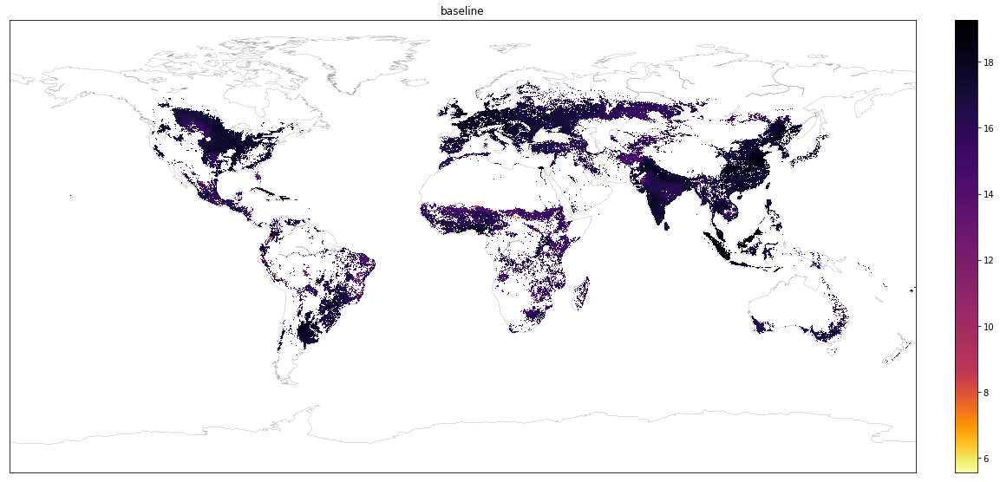

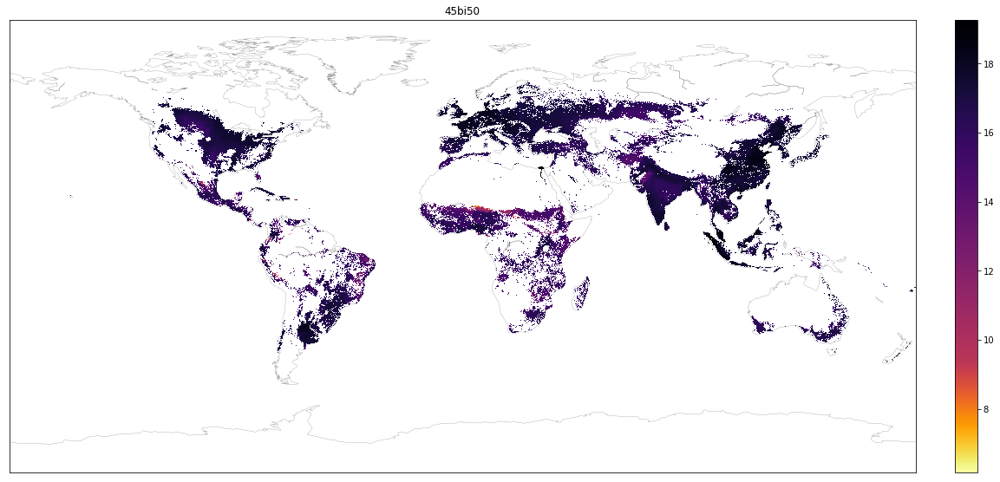

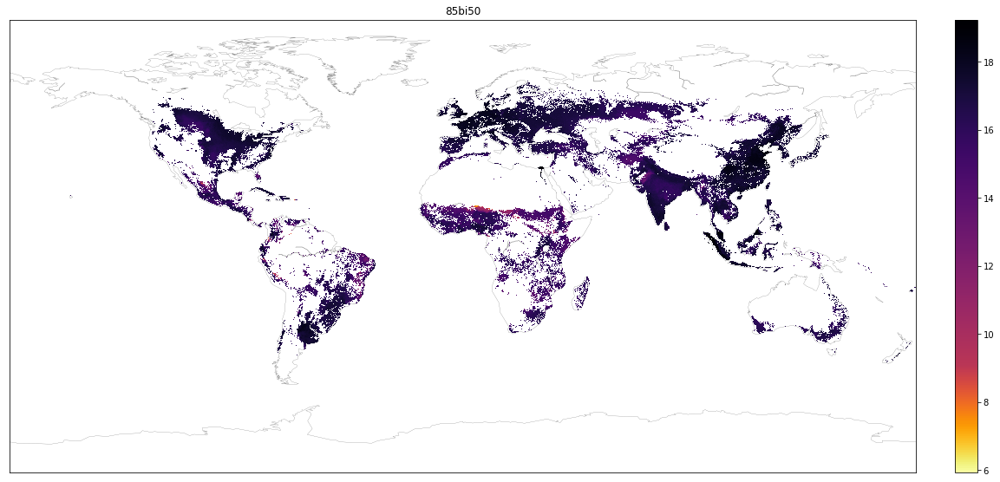

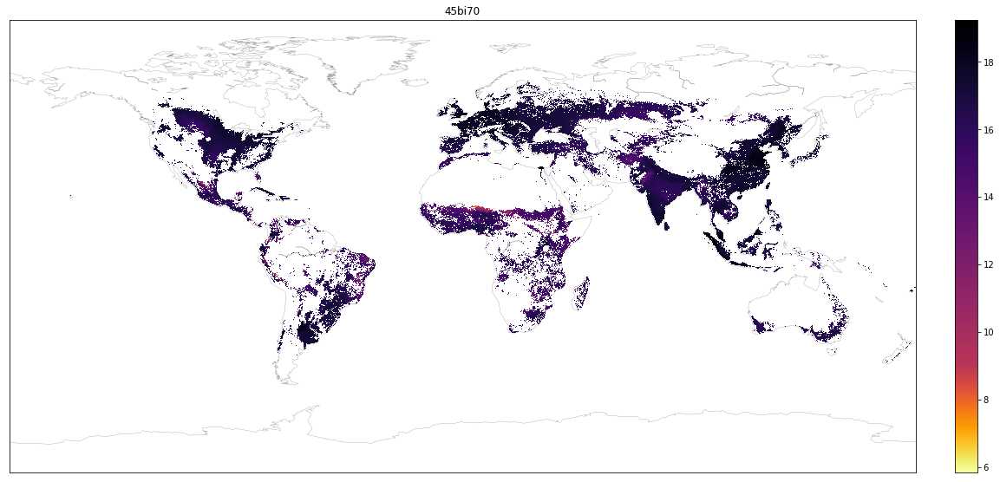

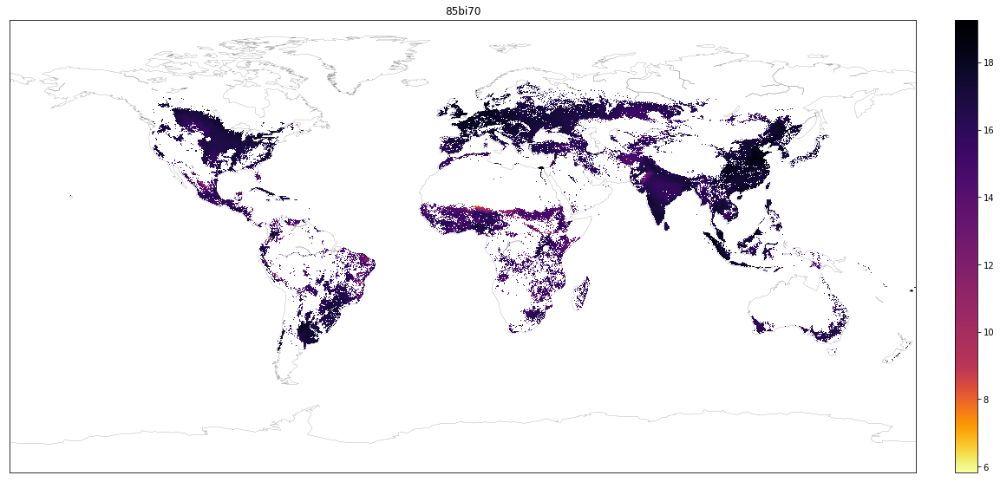

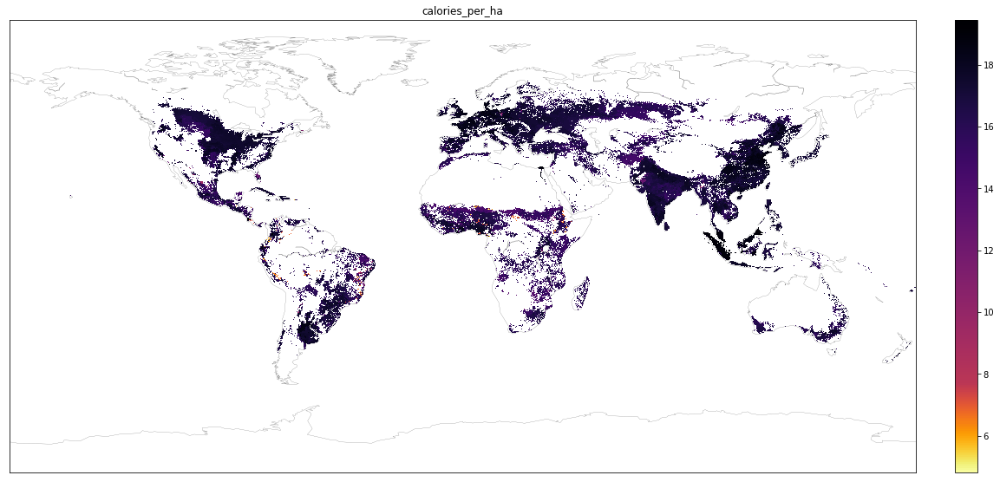

In [380]:
for col in modeled_y.columns:
    visualize_data(modeled_y,col,colorscheme='sequential')

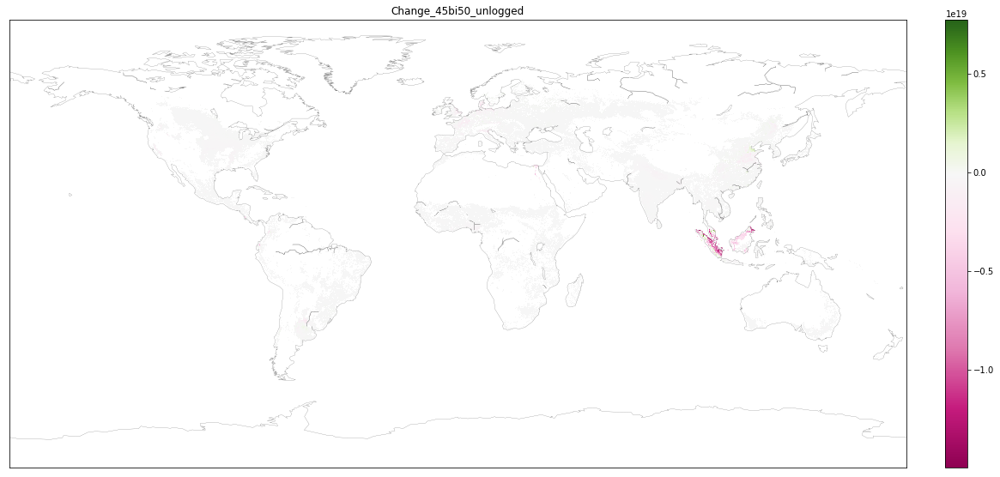

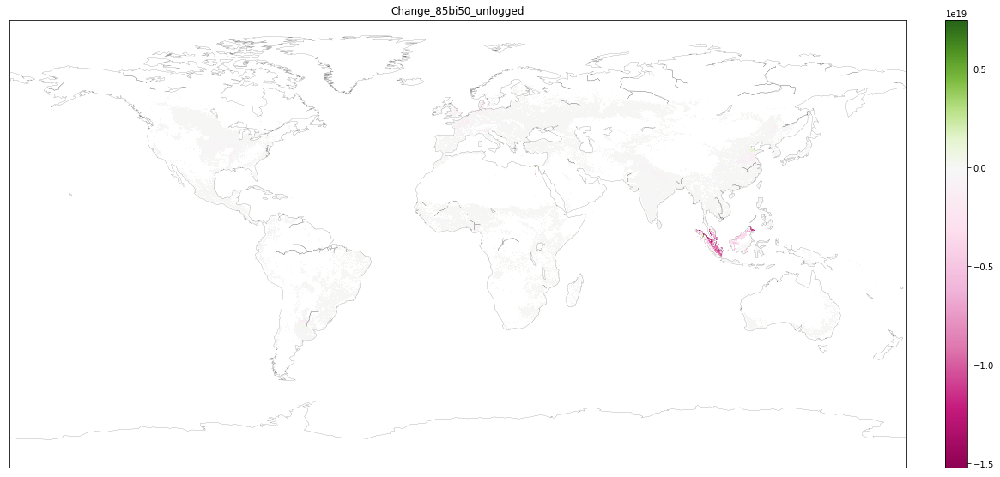

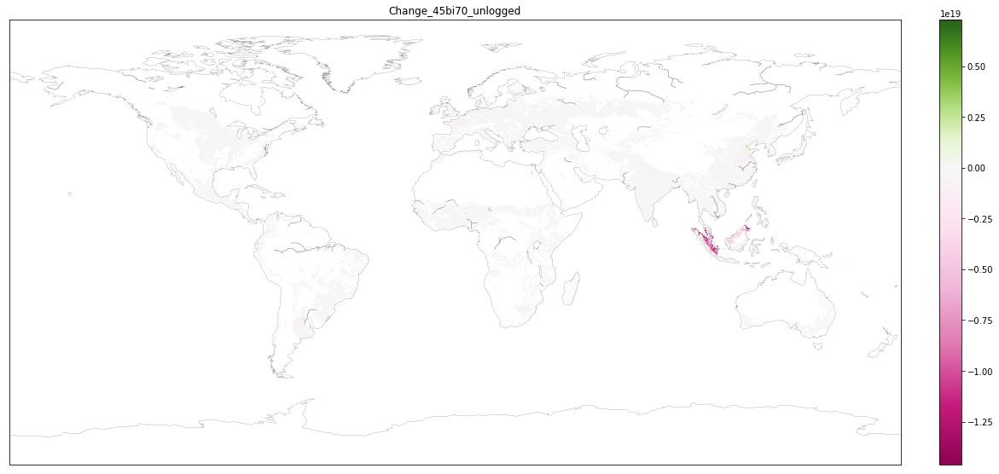

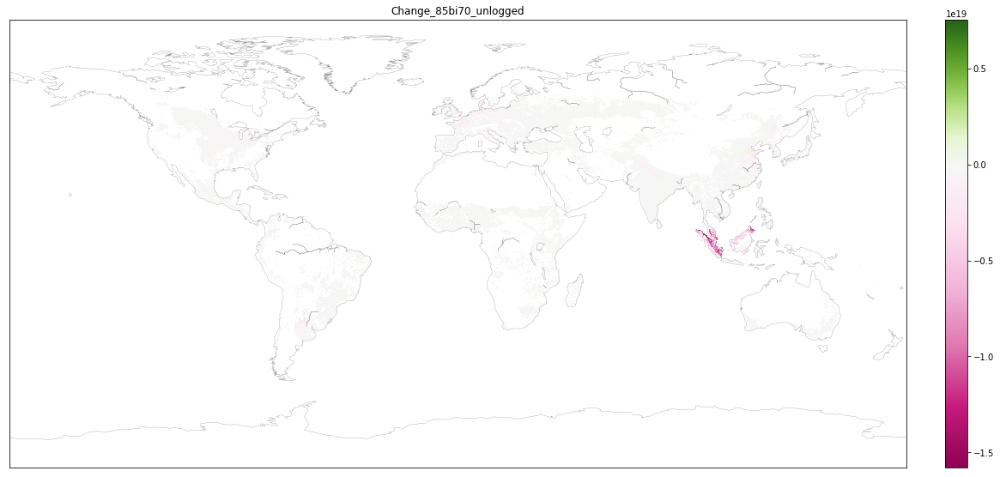

In [406]:
for col in modeled_y.columns:
    if ("Change" in col) and ('_unlogged' in col): 
        visualize_data(modeled_y,col)

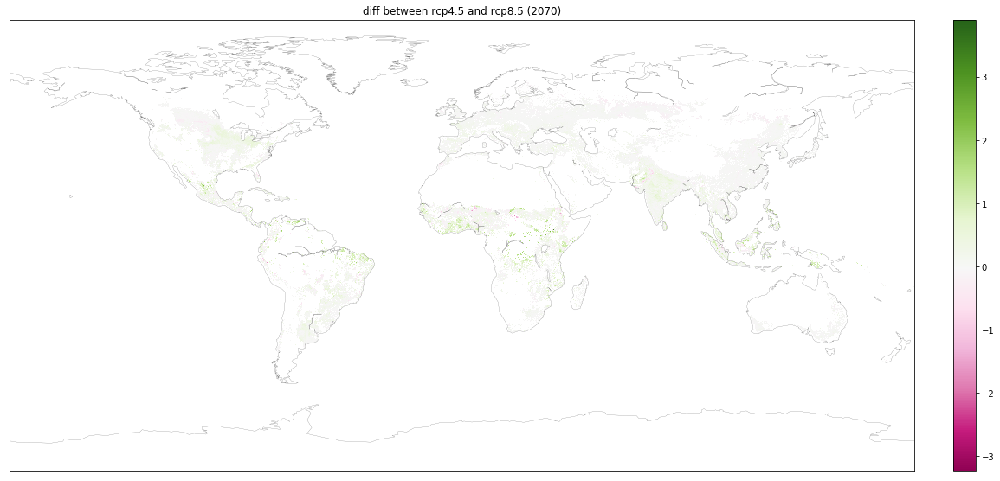

In [83]:
modeled_y['Change_45bi70 - Change_85bi70'] = modeled_y['Change_45bi70'] - modeled_y['Change_85bi70']
visualize_data(modeled_y,'Change_45bi70 - Change_85bi70',title='diff between rcp4.5 and rcp8.5 (2070)')

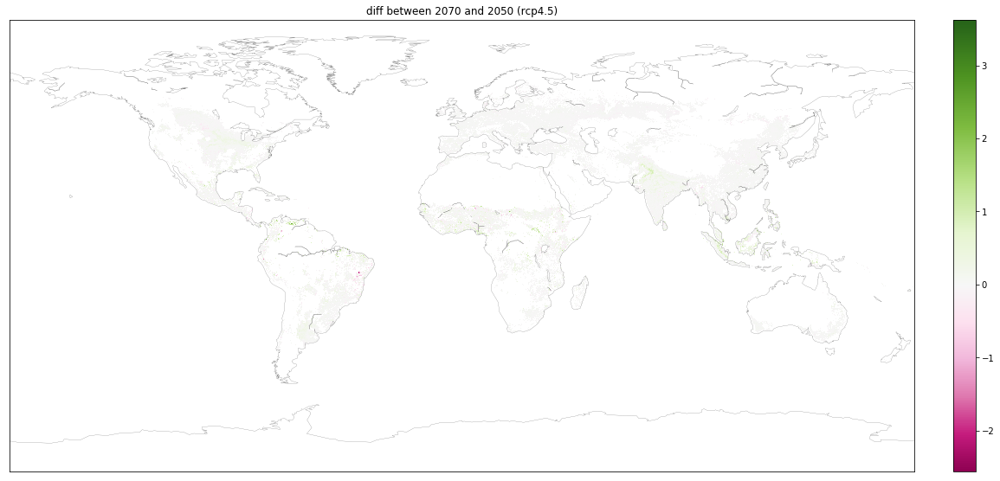

In [85]:
modeled_y['Change_45bi50 - Change_45bi70'] = modeled_y['Change_45bi50'] - modeled_y['Change_45bi70']
visualize_data(modeled_y,'Change_45bi50 - Change_45bi70',title='diff between 2070 and 2050 (rcp4.5)')

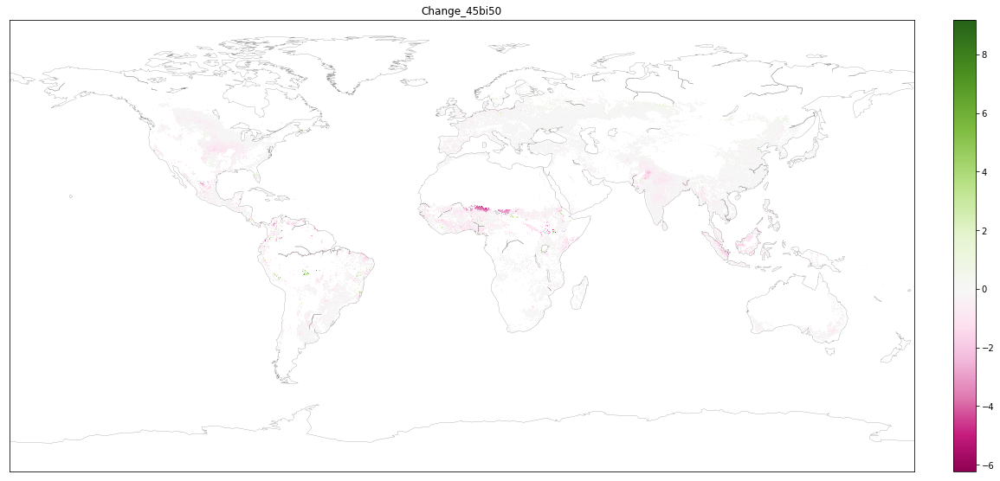

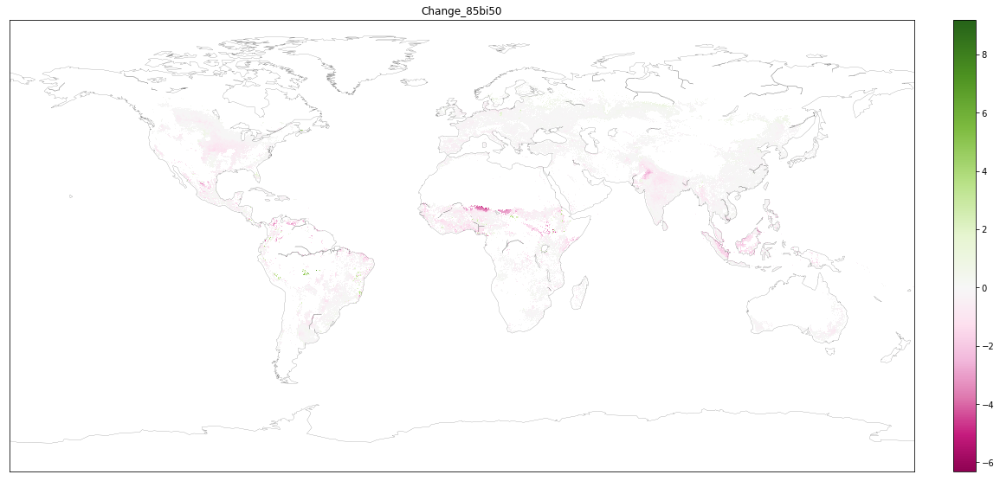

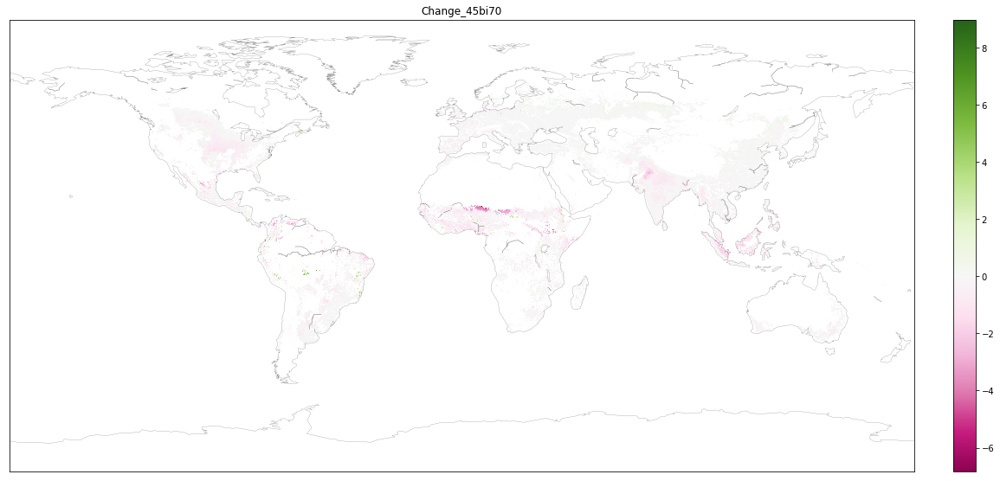

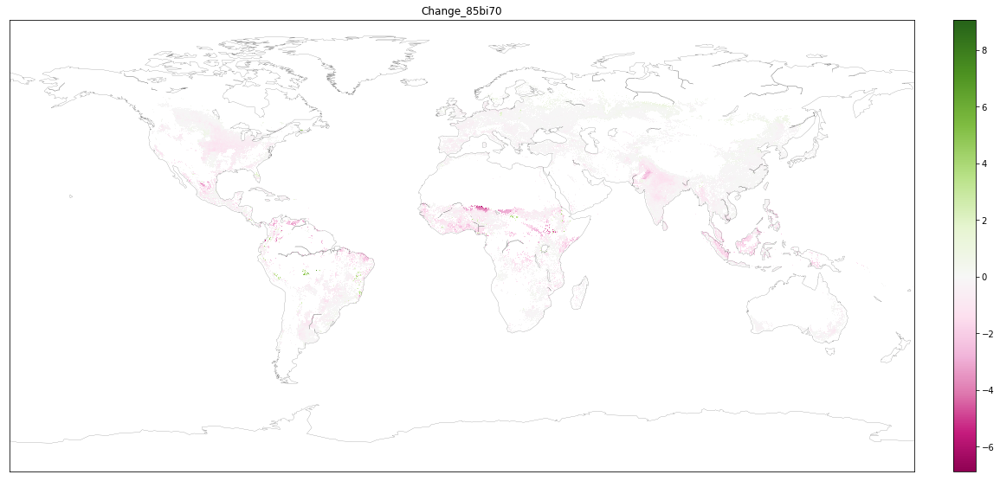

In [388]:
for col in modeled_y.columns:
    if "Change" in col: 
        visualize_data(modeled_y,col)

In [400]:
## Are they the same input data WTF ?! ##No


## Heatmaps instead of scatterplots

In [158]:
regression = load_regression('xgb3')
print(regression
     )


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.85, gamma=0, learning_rate=0.02,
       max_delta_step=0, max_depth=10, min_child_weight=3, missing=nan,
       n_estimators=700, n_jobs=1, nthread=4, objective='reg:linear',
       random_state=0, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
       seed=None, silent=1, subsample=0.85)


In [159]:
#POLYNOMIAL
model = 'Linear'
regression = load_regression('Linear')
if model == 'Poly':
                df_to_make_poly = X.merge(pd.DataFrame(y),right_index=True,left_index=True)
                df_poly = make_polynomial(df_to_make_poly)
                X = df_poly.drop(['calories_per_ha'], axis=1)
                
y_predicted = regression.predict(X)
compare= predictions_df()




In [18]:
compare_ridge

,log(cal_per_ha),log(cal_per_ha) predicted,cal_per_ha,cal_per_ha predicted,prediction error (log),prediction diff (not log)
pixel_id,,,,,,
1090988,17.116737,17.283668,1.308389e+17,1.921620e+17,0.166931,6.132314e+16
1112598,17.461977,17.285601,2.897192e+17,1.930193e+17,-0.176376,-9.669985e+16
1121218,17.461977,17.286382,2.897192e+17,1.933667e+17,-0.175596,-9.635252e+16
1121236,17.461977,16.868229,2.897192e+17,7.382929e+16,-0.593749,-2.158899e+17
1181705,17.461977,17.084837,2.897192e+17,1.215730e+17,-0.377140,-1.681462e+17
1246474,17.392149,17.512306,2.466887e+17,3.253166e+17,0.120157,7.862792e+16
1272549,16.312744,16.462510,2.054677e+16,2.900747e+16,0.149766,8.460696e+15
1276867,16.889301,16.674297,7.749992e+16,4.723863e+16,-0.215004,-3.026130e+16
1276868,16.312744,16.602135,2.054677e+16,4.000695e+16,0.289392,1.946018e+16


In [12]:
compare_lr

,log(cal_per_ha),log(cal_per_ha) predicted,cal_per_ha,cal_per_ha predicted,prediction error (log),prediction diff (not log)
pixel_id,,,,,,
1090988,17.116737,17.295717,1.308389e+17,1.975681e+17,0.178980,6.672926e+16
1112598,17.461977,17.297556,2.897192e+17,1.984067e+17,-0.164421,-9.131251e+16
1121218,17.461977,17.298954,2.897192e+17,1.990463e+17,-0.163023,-9.067290e+16
1121236,17.461977,16.881792,2.897192e+17,7.617143e+16,-0.580185,-2.135478e+17
1181705,17.461977,17.096620,2.897192e+17,1.249166e+17,-0.365357,-1.648026e+17
1246474,17.392149,17.519073,2.466887e+17,3.304251e+17,0.126924,8.373641e+16
1272549,16.312744,16.479971,2.054677e+16,3.019749e+16,0.167227,9.650718e+15
1276867,16.889301,16.684022,7.749992e+16,4.830837e+16,-0.205279,-2.919155e+16
1276868,16.312744,16.612266,2.054677e+16,4.095116e+16,0.299523,2.040439e+16


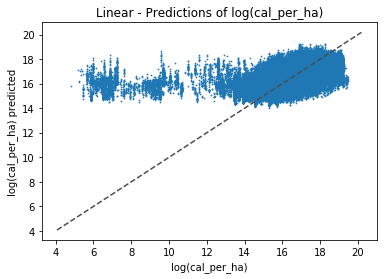

In [16]:
ax = compare_lasso.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title='Linear - Predictions of log(cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");

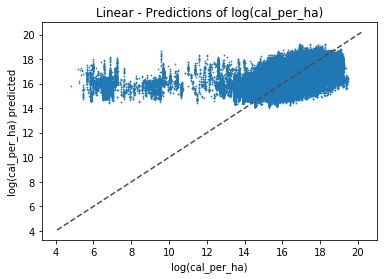

In [22]:
ax = compare_ridge.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title='Linear - Predictions of log(cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");

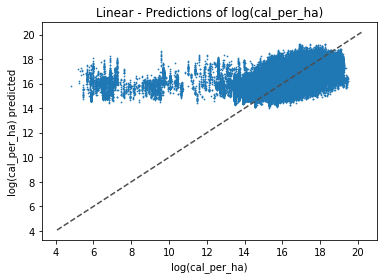

In [14]:
ax = compare_lr.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title='Linear - Predictions of log(cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");

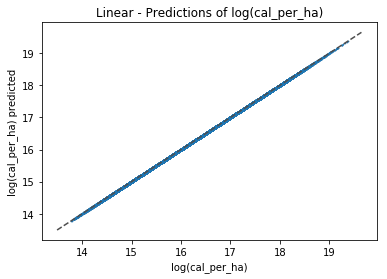

In [150]:
ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title='Linear - Predictions of log(cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");

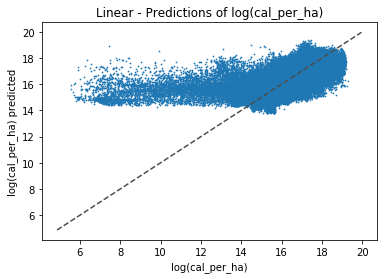

In [148]:
ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title='Linear - Predictions of log(cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls ="--", c=".3");

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


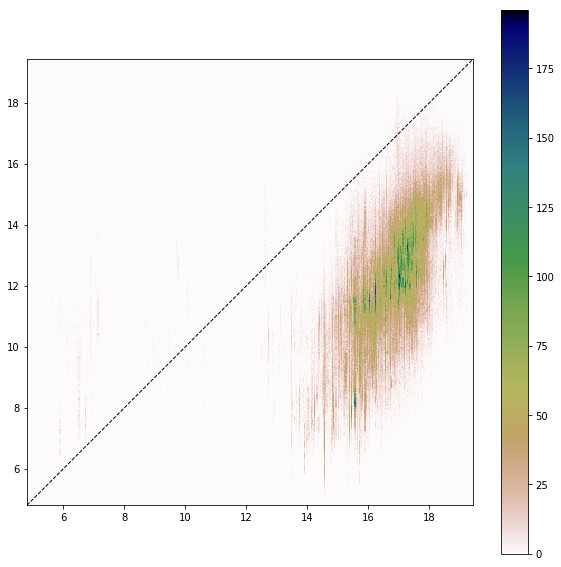

In [21]:
x = compare_ridge['log(cal_per_ha)']
y = compare_ridge['log(cal_per_ha) predicted']

fig,ax = plt.subplots(1,1,figsize=(10,10))

heatmap, xedges, yedges = np.histogram2d(x, y, bins=400)
upper = max(xedges[-1],yedges[-1])
lower = min(xedges[0],yedges[0])
extent = [lower, upper, lower, upper]

hm = plt.imshow(heatmap.T, extent=extent, origin='lower',cmap='gist_earth_r') #transparence = beaucoup !!
cbar = plt.colorbar(hm, orientation='vertical')#,fraction=0.0234, pad=0.04)

line = ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3",color='black',linewidth=1);

plt.show()

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


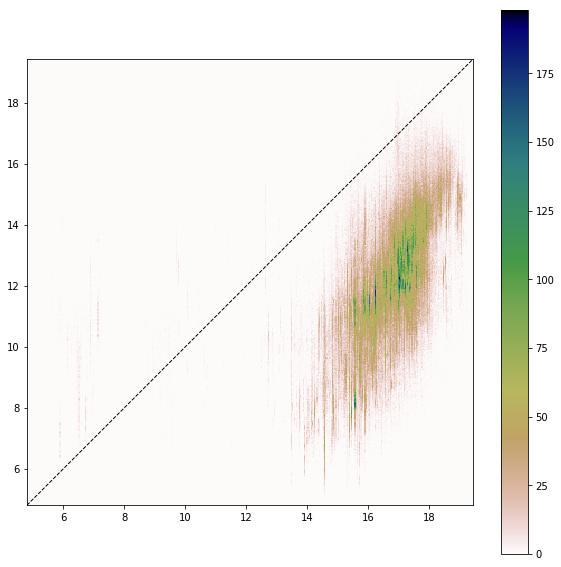

In [20]:
x = compare_lr['log(cal_per_ha)']
y = compare_lr['log(cal_per_ha) predicted']

fig,ax = plt.subplots(1,1,figsize=(10,10))

heatmap, xedges, yedges = np.histogram2d(x, y, bins=400)
upper = max(xedges[-1],yedges[-1])
lower = min(xedges[0],yedges[0])
extent = [lower, upper, lower, upper]

hm = plt.imshow(heatmap.T, extent=extent, origin='lower',cmap='gist_earth_r') #transparence = beaucoup !!
cbar = plt.colorbar(hm, orientation='vertical')#,fraction=0.0234, pad=0.04)

line = ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3",color='black',linewidth=1);

plt.show()

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


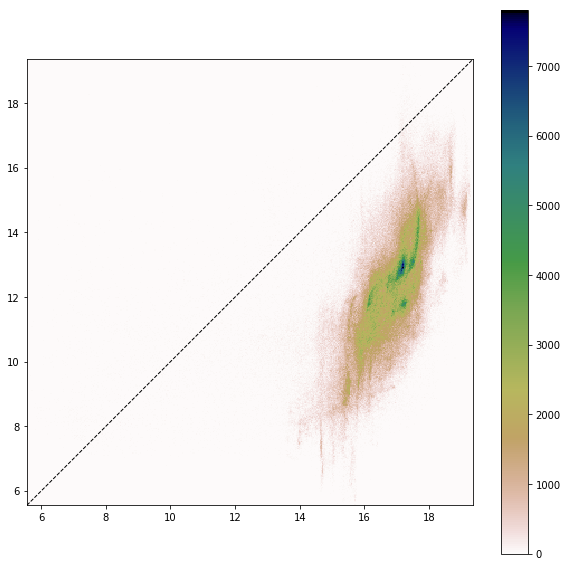

In [146]:
# Plot below done with Linear

x = compare['log(cal_per_ha)']
y = compare['log(cal_per_ha) predicted']

fig,ax = plt.subplots(1,1,figsize=(10,10))

heatmap, xedges, yedges = np.histogram2d(x, y, bins=400)
upper = max(xedges[-1],yedges[-1])
lower = min(xedges[0],yedges[0])
extent = [lower, upper, lower, upper]

heatmap = plt.imshow(heatmap.T, extent=extent, origin='lower',cmap='gist_earth_r') #transparence = beaucoup !!
cbar = plt.colorbar(hm, orientation='vertical')#,fraction=0.0234, pad=0.04)

line = ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3",color='black',linewidth=1);

plt.show()

In [48]:
flights = sns.load_dataset("flights")
flights.pivot("month", "year", "passengers")

year,1949,1950,1951,1952,1953,1954,1955,1956,1957,1958,1959,1960
month,,,,,,,,,,,,
January,112,115,145,171,196,204,242,284,315,340,360,417
February,118,126,150,180,196,188,233,277,301,318,342,391
March,132,141,178,193,236,235,267,317,356,362,406,419
April,129,135,163,181,235,227,269,313,348,348,396,461
May,121,125,172,183,229,234,270,318,355,363,420,472
June,135,149,178,218,243,264,315,374,422,435,472,535
July,148,170,199,230,264,302,364,413,465,491,548,622
August,148,170,199,242,272,293,347,405,467,505,559,606
September,136,158,184,209,237,259,312,355,404,404,463,508


In [107]:
from matplotlib.colors import ListedColormap

# Choose colormap
cmap = plt.cm.gist_earth_r

# Get the colormap colors
my_cmap = cmap(np.arange(cmap.N))

# Set alpha
my_cmap[:,-1] = np.linspace(0, 1, cmap.N)

# Create new colormap
my_cmap = ListedColormap(my_cmap)

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


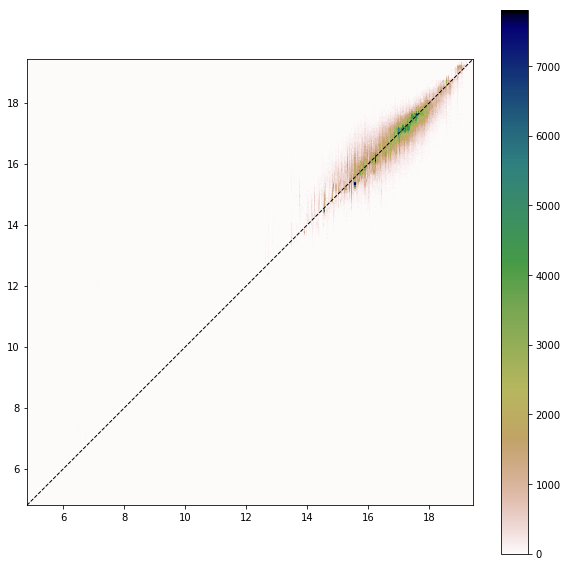

In [119]:
x = compare['log(cal_per_ha)']
y = compare['log(cal_per_ha) predicted']

fig,ax = plt.subplots(1,1,figsize=(10,10))

heatmap, xedges, yedges = np.histogram2d(x, y, bins=400)
upper = max(xedges[-1],yedges[-1])
lower = min(xedges[0],yedges[0])
extent = [lower, upper, lower, upper]

heatmap = plt.imshow(heatmap.T, extent=extent, origin='lower',cmap='gist_earth_r') #transparence = beaucoup !!
cbar = plt.colorbar(hm, orientation='vertical')#,fraction=0.0234, pad=0.04)

line = ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3",color='black',linewidth=1);

plt.show()

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


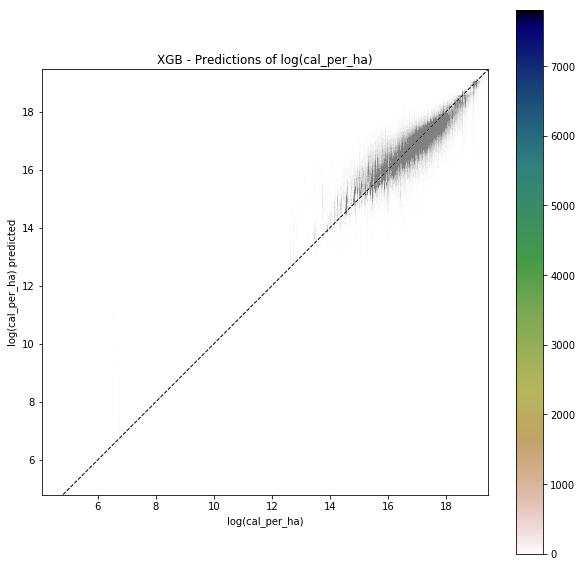

In [114]:
x = compare['log(cal_per_ha)']
y = compare['log(cal_per_ha) predicted']

fig,ax = plt.subplots(1,1,figsize=(10,10))

heatmap, xedges, yedges = np.histogram2d(x, y, bins=1000)
upper = max(xedges[-1],yedges[-1])
lower = min(xedges[0],yedges[0])
extent = [lower, upper, lower, upper]


compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.02,
                     ax=ax,zorder=10,alpha=0.01,color='grey',
                     title='XGB - Predictions of log(cal_per_ha)');

heatmap = plt.imshow(heatmap.T, extent=extent, origin='lower',cmap=my_cmap) #transparence = beaucoup !!
cbar = plt.colorbar(hm, orientation='vertical')#,fraction=0.0234, pad=0.04)

line = ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3",color='black',linewidth=1);

plt.show()

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:2446: UserWarning: Saw kwargs ['c', 'color'] which are all aliases for 'color'.  Kept value from 'color'
  seen=seen, canon=canonical, used=seen[-1]))


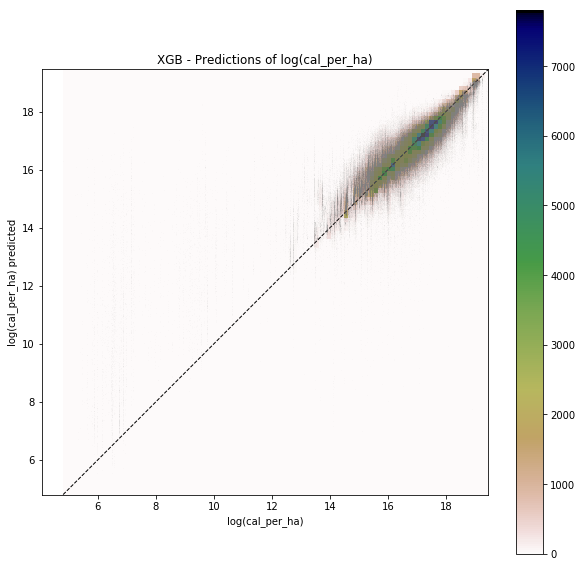

In [105]:
x = compare['log(cal_per_ha)']
y = compare['log(cal_per_ha) predicted']

fig,ax = plt.subplots(1,1,figsize=(10,10))

heatmap, xedges, yedges = np.histogram2d(x, y, bins=100)
upper = max(xedges[-1],yedges[-1])
lower = min(xedges[0],yedges[0])
extent = [lower, upper, lower, upper]

compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.02,
                     ax=ax,zorder=10,alpha=0.05,color='grey',
                     title='XGB - Predictions of log(cal_per_ha)');

heatmap = plt.imshow(heatmap.T, extent=extent, origin='lower',cmap='gist_earth_r') #transparence = beaucoup !!
cbar = plt.colorbar(hm, orientation='vertical')#,fraction=0.0234, pad=0.04)

line = ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3",color='black',linewidth=1);

plt.show()

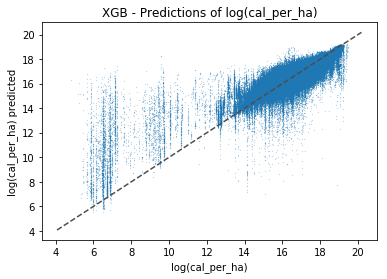

In [56]:
#Predictions of log(calories_per_ha)
ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.01,title='XGB - Predictions of log(cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");

#plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted_log--Linear_simplesubset.png')

## Scatterplots examples

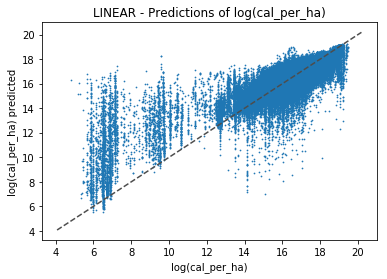

In [283]:
#Predictions of log(calories_per_ha)
ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title='XGB - Predictions of log(cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");

#plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted_log--Linear_simplesubset.png')

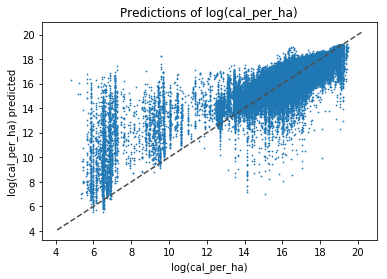

In [282]:
#Predictions of log(calories_per_ha)
ax = compare.plot.scatter(x='log(cal_per_ha)',y='log(cal_per_ha) predicted',s=0.5,title='Predictions of log(cal_per_ha)');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");


#plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted_log--Linear_simplesubset.png')

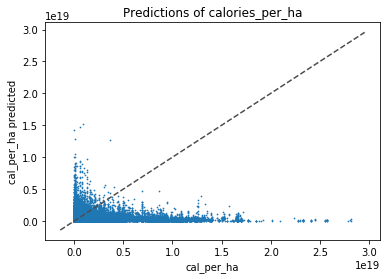

In [273]:
#Predictions of calories_per_ha
ax = compare.plot.scatter(x='cal_per_ha',y='cal_per_ha predicted',s=0.5,title='Predictions of calories_per_ha');
ax.plot(ax.get_xlim(), ax.get_xlim(), ls="--", c=".3");

#plt.savefig('../ipbes_invest_crop_yield_project/output/Figures/Model_results/y_predicted--Linear_simplesubset.png')

## Maps examples

In [14]:
compare = predictions_df()

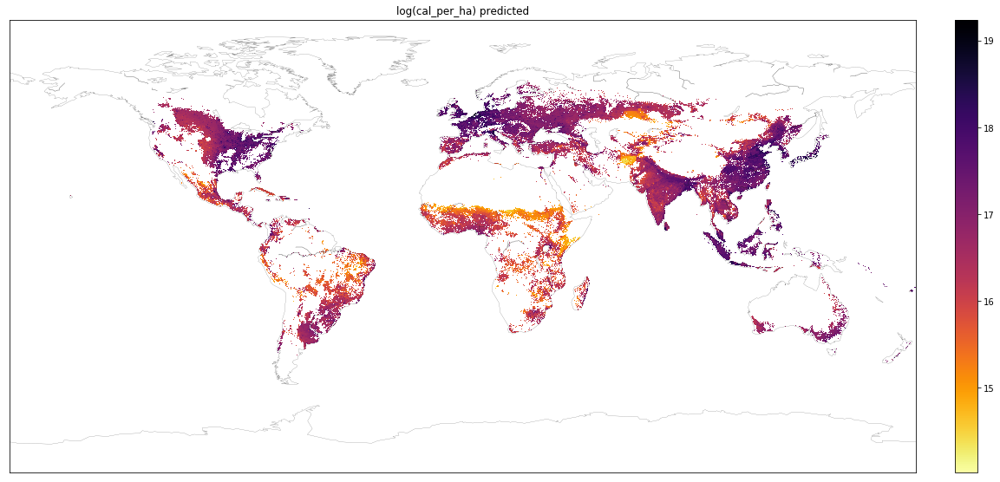

In [83]:
visualize_data(compare,'log(cal_per_ha) predicted',colorscheme='sequential',
               savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Map_log(cal_per_ha)_pred--'+model+'.png')

export_raster(compare,'log(cal_per_ha) predicted',
             savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/Raster_log(cal_per_ha)_pred--'+model+'.png')

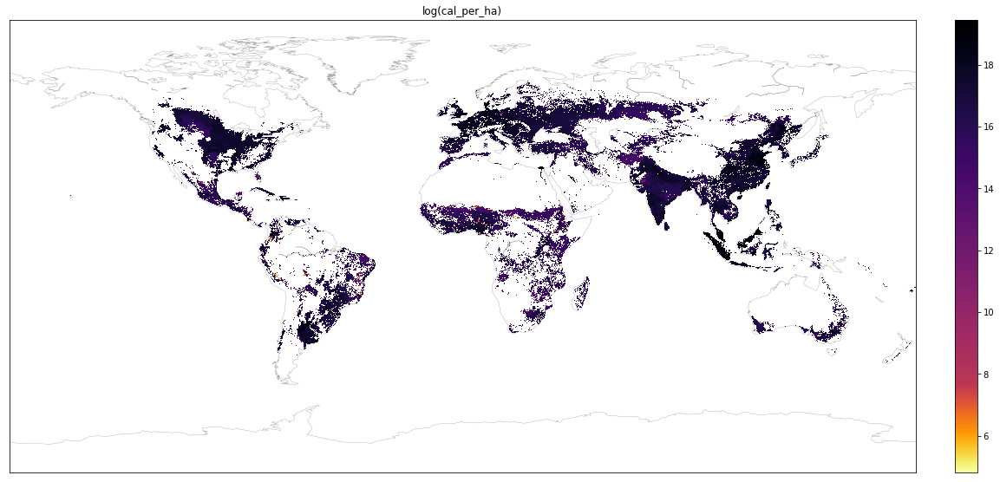

FileNotFoundError: [Errno 2] No such file or directory: '../ipbes_invest_crop_yield_project/output/Figures/test/test/test.png'

In [203]:
visualize_data(compare,'log(cal_per_ha)',colorscheme='sequential')
              #savefig='../ipbes_invest_crop_yield_project/output/Figures/test/test/test.png')


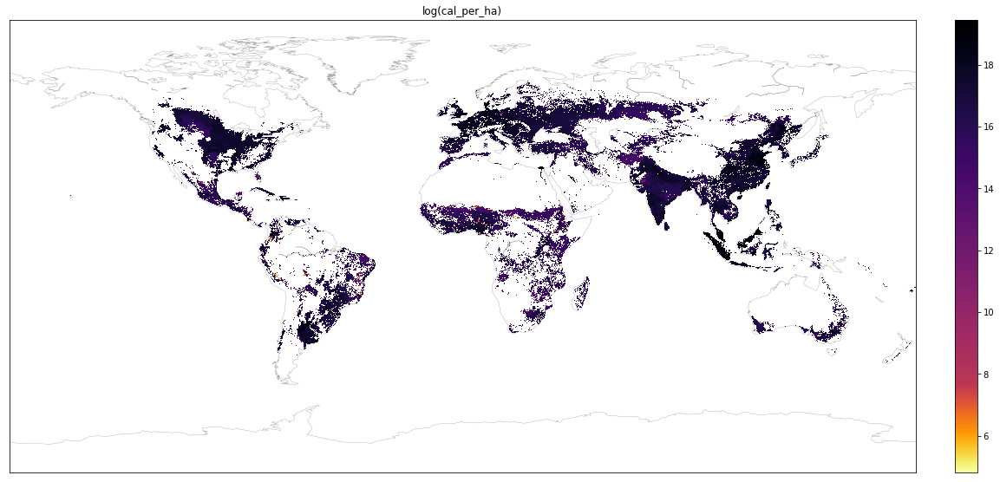

In [24]:
visualize_data(compare,'log(cal_per_ha)',colorscheme='sequential')
               #savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/cal_per_ha--Linear_simplesubset.png')

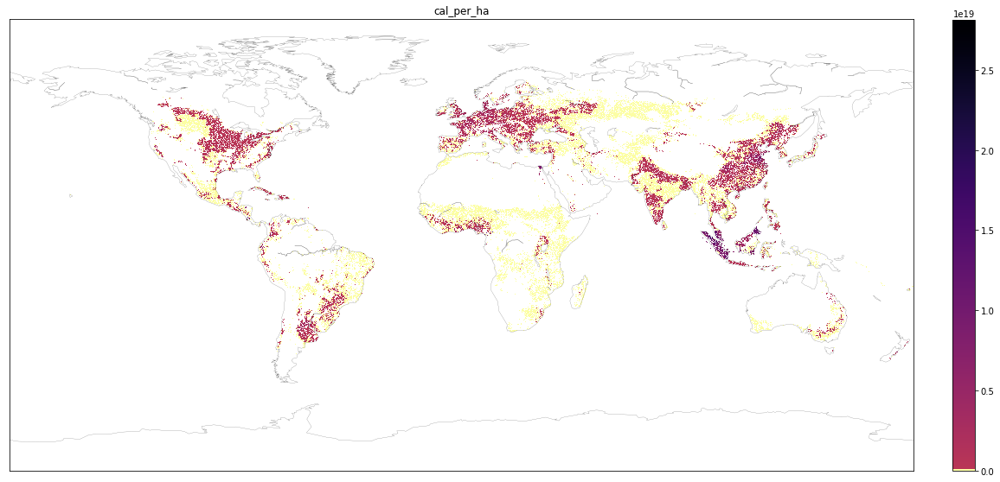

In [436]:
visualize_data(compare,'cal_per_ha',colorscheme='sequential')
               #savefig = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/cal_per_ha--Linear_simplesubset.png')

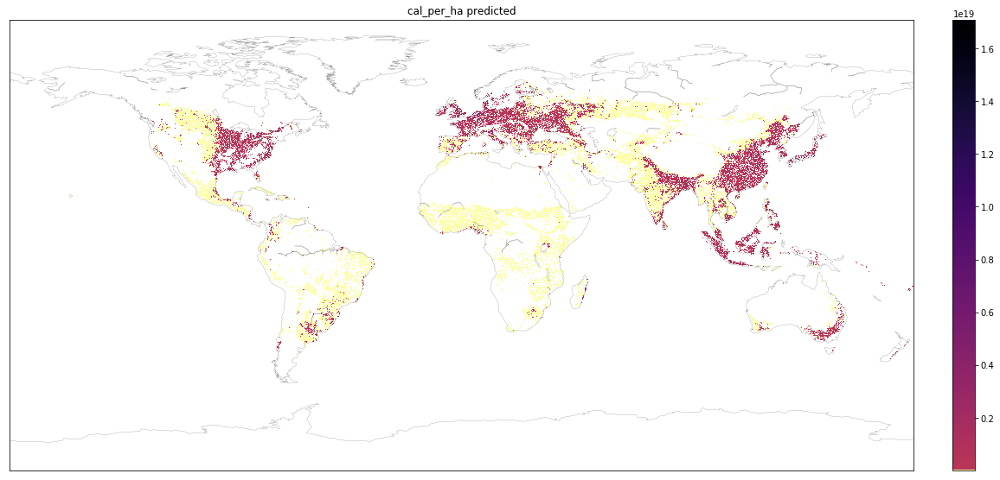

In [435]:
visualize_data(compare,'cal_per_ha predicted',colorscheme='sequential')

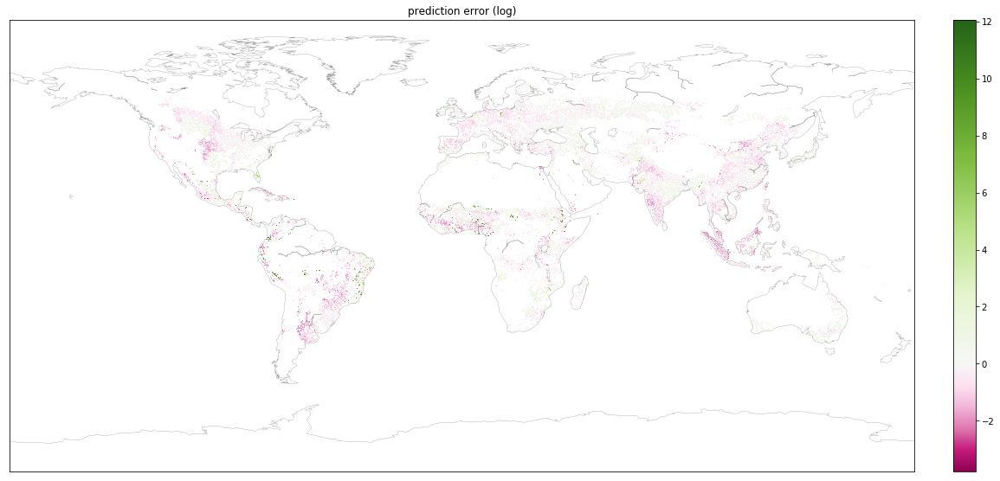

In [424]:
visualize_data(compare,'prediction error (log)')

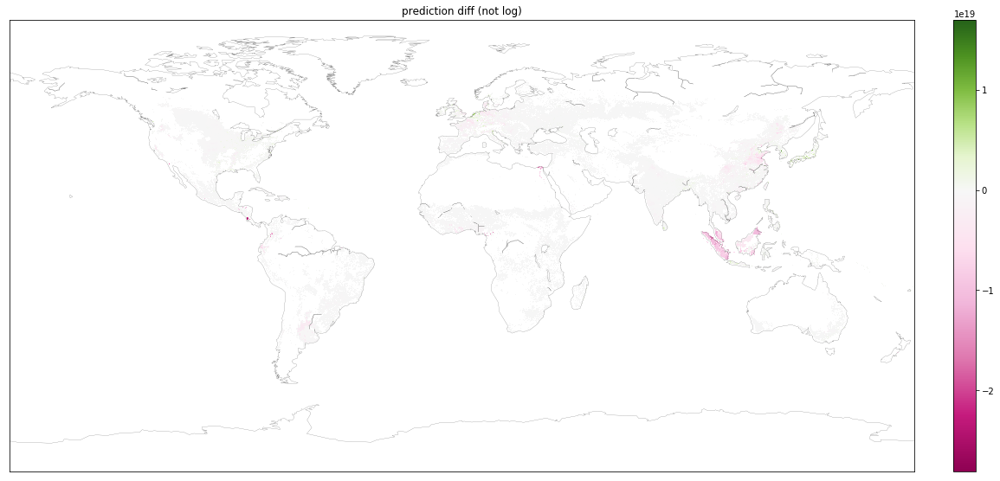

In [89]:
visualize_data(compare,'prediction diff (not log)')

In [329]:
compare['prediction error'].describe()

count    4.346420e+05
mean    -3.070626e+17
std      1.346949e+18
min     -2.813308e+19
25%     -1.500159e+17
50%     -4.781020e+15
75%      1.671065e+16
max      1.700098e+19
Name: prediction error, dtype: float64

In [337]:
start = 1 / (serie.quantile(0.1) / serie.min() )
stop =  1 / (serie.quantile(0.9) / serie.max() )

45.01891102906629

## Visualisation functions

In [ ]:
visualize_data(compare,'log(cal_per_ha)',colorscheme='sequential')



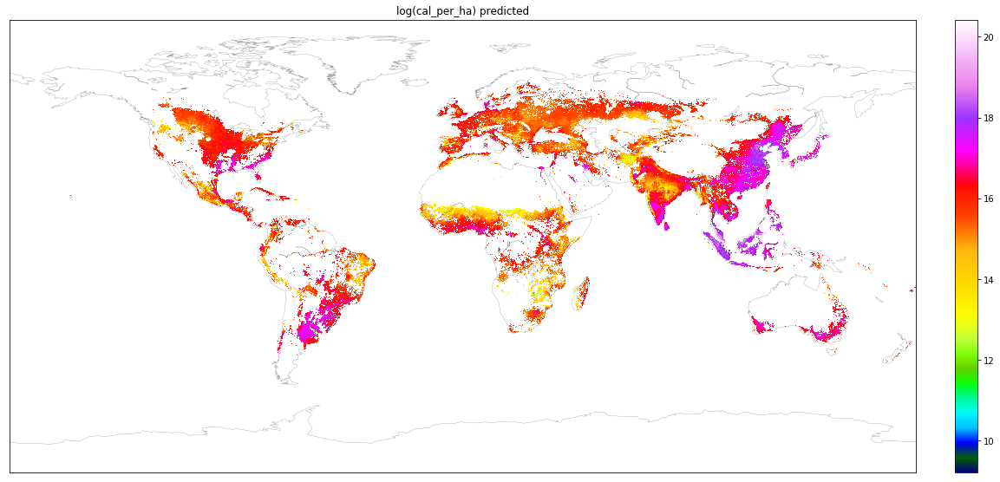

In [361]:
visualize_data(compare,'log(cal_per_ha) predicted',colorscheme='sequential')

In [165]:
compare['prediction error (log)'].describe()

count    579523.0
mean          0.0
std           0.0
min           0.0
25%           0.0
50%           0.0
75%           0.0
max           0.0
Name: prediction error (log), dtype: float64

In [166]:
visualize_data(compare,'prediction diff (not log)')


/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/ipykernel/__main__.py:6: RuntimeWarning: invalid value encountered in double_scalars


ValueError: data mapping points must start with x=0 and end with x=1

<Figure size 1440x1080 with 2 Axes>

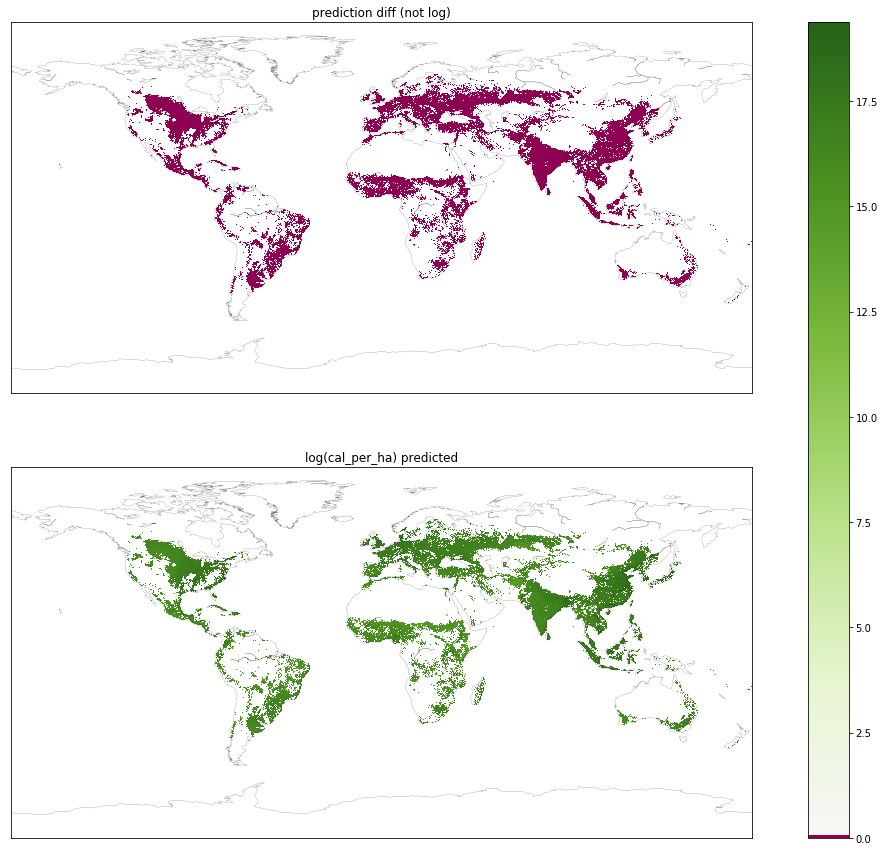

In [167]:
visualize_2_maps(compare,'prediction diff (not log)','log(cal_per_ha) predicted')


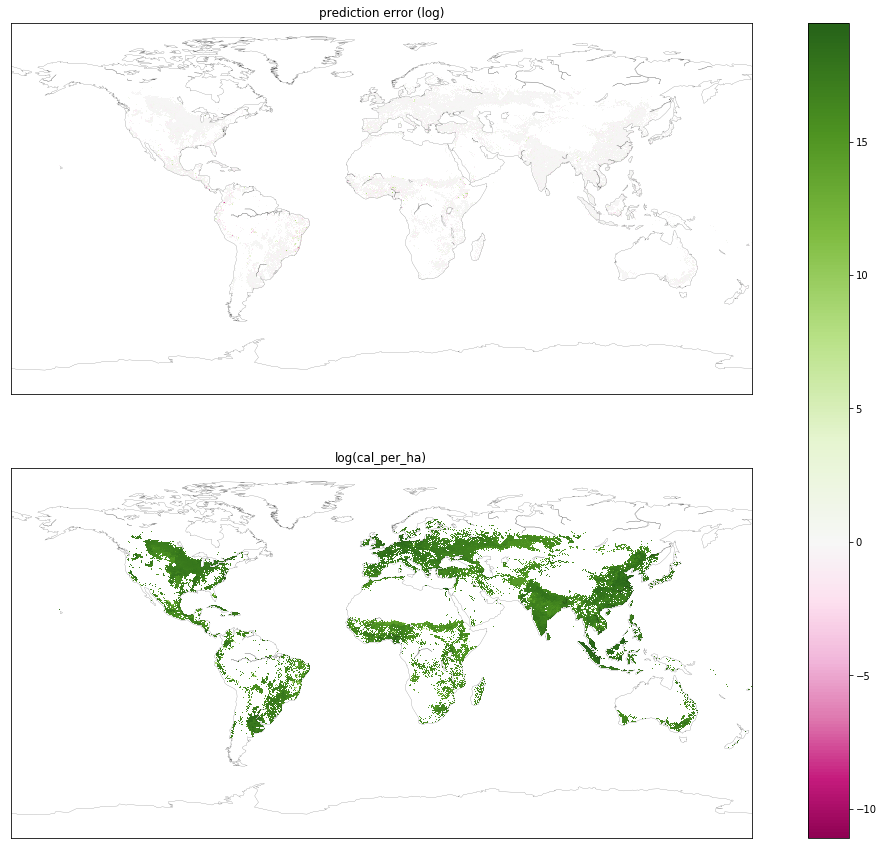

In [133]:
visualize_2_maps(compare,'prediction error (log)','log(cal_per_ha) predicted')



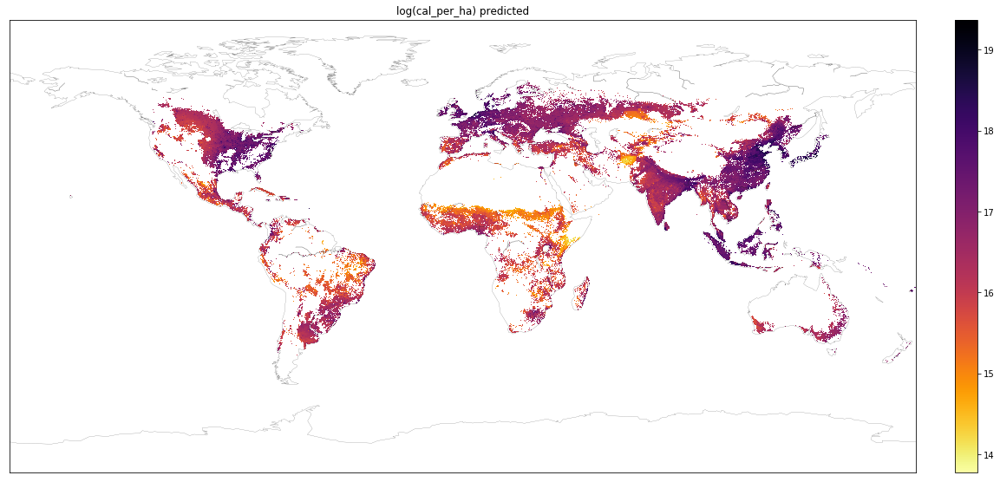

In [169]:
visualize_data(compare,'log(cal_per_ha) predicted',colorscheme='sequential')



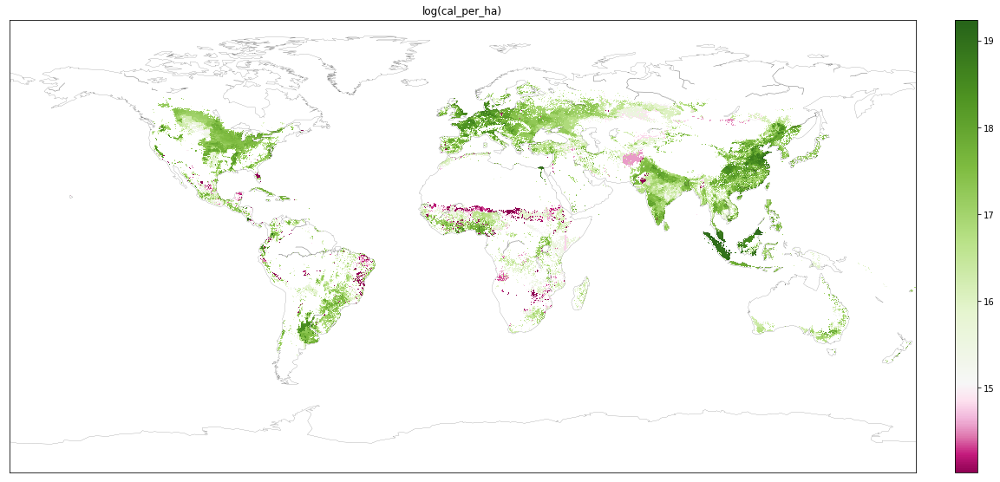

In [394]:
visualize_data(compare,'log(cal_per_ha)')

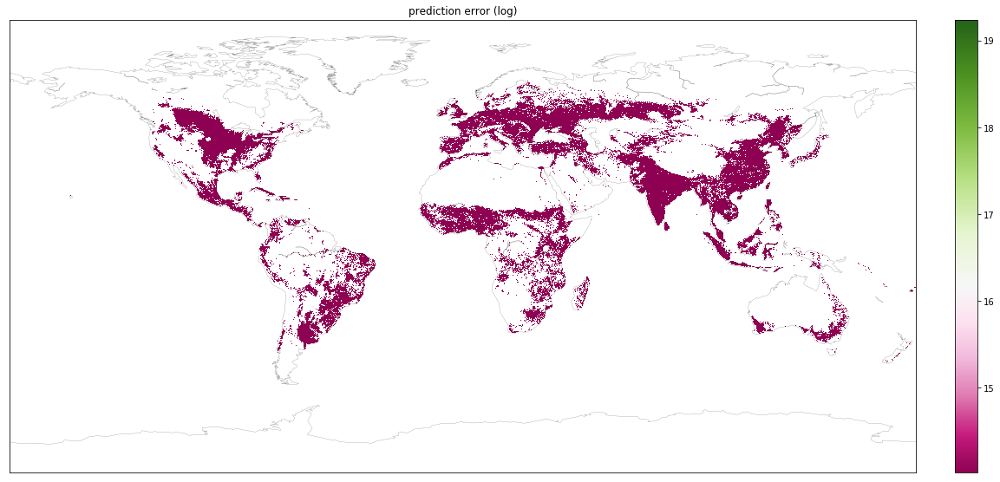

In [395]:
visualize_data(compare,'prediction error (log)')

### Attempts to export raster

In [117]:
def export_raster(df,col_name,savefig=False):
    
    #Make a zeros_df of length 9331200
    country_ids_raster_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
    match_af = hb.ArrayFrame(country_ids_raster_path)
    zeros_array = np.zeros(match_af.size)
    zeros_df = pd.DataFrame(zeros_array)
    DF = df[col_name].reset_index()
    ### Merge with zeros_df to include non-ag pixels
    full_df = pd.merge(zeros_df, DF, left_index=True, right_on='pixel_id', how='outer')
    
    
    ### to do transform df to array to raster
    
    
    if savefig != False:
        print('d')#save raster at savefig location
    else:
        pass
    
    return full_df
    

In [278]:
match_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
match = gdal.Open(match_path)
gt =match.GetGeoTransform()
gt[1]
#ixelSizeY =-gt[5]
match.RasterYSize
match.RasterXSize

4320

In [279]:
values = full_df['log(cal_per_ha)'].as_matrix().reshape((2160, 4320)).astype(np.float32)

target_path = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/raster/test.tif'
x_pixels = 4320  # = match.RasterXSize
y_pixels = 2160  # = match.RasterYSize
driver = gdal.GetDriverByName('GTiff')
output = driver.Create(target_path,x_pixels, y_pixels, 1 ,gdal.GDT_Float32)
output.GetRasterBand(1).WriteArray(values)

match_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
match = gdal.Open(match_path)
geotrans = match.GetProjection()
proj = match.GetGeoTransform()
output.SetGeoTransform(geotrans)
output.SetProjection(proj)
output.FlushCache()
#output.GetRasterBand(1).SetNoDataValue(np.nan)
output=None

TypeError: sequence must have length ##size

In [264]:
m = np.array([[1,2],[3,3],[99,99]])
m.shape

(3, 2)

In [244]:
#full_df = export_raster(compare,'log(cal_per_ha)')

values = full_df['log(cal_per_ha)'].as_matrix().reshape((2160, 4320)).astype(np.float32)
#values = full_df['log(cal_per_ha)'].as_matrix().astype(np.float32)

o= hb.new_raster_from_base(base_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif',
                        target_path = '../ipbes_invest_crop_yield_project/output/Figures/Model_results/raster/test.tif',
                        datatype = gdal.GDT_Float32,
                        band_nodata_list=[None],
                        fill_value_list= values,
                        n_rows=None,
                        n_cols=None,
                        gtiff_creation_options=hb.DEFAULT_GTIFF_CREATION_OPTIONS)
#(2160, 4320)
#(9331200,)

TypeError: in method 'Band_Fill', argument 2 of type 'double'

In [227]:
from osgeo import gdal
gtif = gdal.Open( '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif')
print(gtif.GetMetadata)

<bound method MajorObject.GetMetadata of <osgeo.gdal.Dataset; proxy of <Swig Object of type 'GDALDatasetShadow *' at 0x1c260137b0> >>


In [228]:
fp = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
import rasterio
raster = rasterio.open(fp)
raster.meta

{'driver': 'GTiff',
 'dtype': 'float64',
 'nodata': -9999.0,
 'width': 4320,
 'height': 2160,
 'count': 1,
 'crs': CRS({'init': 'epsg:4326'}),
 'transform': (-179.99999491609228,
  0.08333333804392655,
  0.0,
  90.00000254430942,
  0.0,
  -0.0833333356891754),
 'affine': Affine(0.08333333804392655, 0.0, -179.99999491609228,
        0.0, -0.0833333356891754, 90.00000254430942)}

### Mapping functions

In [135]:
## Geographical visualization function
def visualize_data(df,col_name,savefig=False,colorscheme='diverging',
                   shape=(2160,4320),title=None):

    
    fig,axes = plt.subplots(1, 1, figsize=(20,15))

    # -- Prepare data --
    #Make a zeros_df of length 9331200
    country_ids_raster_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
    match_af = hb.ArrayFrame(country_ids_raster_path)
    zeros_array = np.zeros(match_af.size)
    zeros_df = pd.DataFrame(zeros_array)
    DF = df[col_name].reset_index()
    ### Merge with zeros_df to include non-ag pixels
    full_df = pd.merge(zeros_df, DF, left_index=True, right_on='pixel_id', how='outer')
    
    ## -- Plot column --
    
    #Colorscale
    if colorscheme == 'diverging':
        raw_cmap =  plt.get_cmap('PiYG')
        cmap = customColorMap(raw_cmap, full_df[col_name])
    elif colorscheme == 'sequential':
        raw_cmap = plt.get_cmap('inferno_r') #alternatively 'magma'
        cmap = customColorMap(raw_cmap, full_df[col_name])
    #else:
        #cmap = replicateColorMap(colorscheme,vmin=14.022869333967861,vmax=19.24083736317894)
        
    
    
    
    #Plot data
    data = np.array(full_df[col_name])
    bm = Basemap()
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    
    cbar = plt.colorbar(im, orientation='vertical',fraction=0.0234, pad=0.04)
    
    if title == None:
        plt.title(col_name)
    else:
        plt.title(title)
    plt.show()
  
    if savefig != False:
        fig.savefig(savefig)
        
   #if colorscheme != cmap:    
   #     return cmap


In [131]:
## Geographical visualization function
def visualize_2_maps(df,col_name1,col_name2,
                     savefig=False,colorscheme='diverging',
                     shape=(2160,4320)):

    fig, axes = plt.subplots(2, 1, figsize=(20,15))

    # -- Prepare data --
    #Make a zeros_df of length 9331200
    country_ids_raster_path = '../ipbes_invest_crop_yield_project/input/Cartographic/country_ids.tif'
    match_af = hb.ArrayFrame(country_ids_raster_path)
    zeros_array = np.zeros(match_af.size)
    zeros_df = pd.DataFrame(zeros_array)
    
    DF1 = df[col_name1].reset_index()
    DF2 = df[col_name2].reset_index()
    ### Merge with zeros_df to include non-ag pixels
    full_df1 = pd.merge(zeros_df, DF1, left_index=True, right_on='pixel_id', how='outer')
    full_df2 = pd.merge(zeros_df, DF2, left_index=True, right_on='pixel_id', how='outer')
    
    ## -- Plot column --
    
    #Colorscale
    if colorscheme == 'diverging':
        raw_cmap =  plt.get_cmap('PiYG')
        cmap = customColorMap2(raw_cmap, full_df1[col_name1],full_df2[col_name2])
    elif colorscheme == 'sequential':
        raw_cmap = plt.get_cmap('inferno_r') #alternatively 'magma'
        cmap = customColorMap2(raw_cmap, full_df1[col_name1],full_df2[col_name2])
    #else:
        #cmap = replicateColorMap(colorscheme,vmin=14.022869333967861,vmax=19.24083736317894)
        
    
    #let's see
    serie1 = full_df1[col_name1]
    serie2 = full_df2[col_name2]
    vmax1 = serie1.max()
    vmin1 = serie1.min()
    vmax2 = serie2.max()
    vmin2 = serie2.min()
    vmax = max(vmax1,vmax2)
    vmin = min(vmin1,vmin2)
    
    
    #Plot data
    data = np.array(full_df1[col_name1])
    bm = Basemap(ax=axes[0])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[0].set_title(col_name1)

    
    data = np.array(full_df2[col_name2])
    bm = Basemap(ax=axes[1])
    im = bm.imshow(np.flipud(data.reshape(shape)),cmap=cmap,vmin=vmin,vmax=vmax)
    bm.drawcoastlines(linewidth=0.15, color='0.1')
    axes[1].set_title(col_name2)

    
    #cbar = plt.colorbar(im, orientation='vertical',fraction=0.0234, pad=0.04)
    
    fig.colorbar(im, ax=axes.ravel().tolist())
    #Or:
    #cax,kw = mpl.colorbar.make_axes([ax for ax in axes.flat])
    #plt.colorbar(im, cax=cax, **kw)
  
    if savefig != False:
        fig.savefig(savefig)
        
   #if colorscheme != cmap:    
   #     return cmap


In [126]:
def customColorMap2(cmap, serie1, serie2,resize=False, name='blabla'):
    '''Charlie's function to re-center and re-size colormap'''
    
    vmax1 = serie1.max()
    vmin1 = serie1.min()
    vmax2 = serie2.max()
    vmin2 = serie2.min()
    vmax = max(vmax1,vmax2)
    vmin = min(vmin1,vmin2)
    midpoint= 1 - vmax / (vmax + abs(vmin))
    
    if resize==True: #e.g resize = 0.1 10%
        print('resize==True yet to be implemented')
        ### TO DO start = 1 / (serie.quantile(resize) / serie.min() )
        ### TO DO stop =  1 / (serie.quantile(1-resize) / serie.max() )
    else:
        start = 0
        stop  = 1
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

In [137]:
def customColorMap(cmap, serie, resize=False, name='blabla'):
    '''Charlie's function to re-center and re-size colormap'''
    
    vmax = serie.max()
    vmin = serie.min()
    midpoint= 1 - vmax / (vmax + abs(vmin))
    
    if resize==True: 
        print('resize==True yet to be implemented')
        ### TO DO start = 1 / (serie.quantile(0.1) / serie.min() )
        ### TO DO stop =  1 / (serie.quantile(0.9) / serie.max() )
    else:
        start = 0
        stop  = 1
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

In [63]:
### Problem : The colorscale is not the same for all the plots !!! 

## cmap is actually just a colormap from 0 to 1 - it doesn't map to values in the cmap itself.

## Tried adding CMAP = visualize_data()
## and at the end of the visualize_data function:
   #if colorscheme != cmap:    
   #     return cmap

def replicateColorMap(cmap, vmin, vmax, name='Prout'):
    '''Charlie's function to re-center and re-size colormap'''

    midpoint= 1 - vmax / (vmax + abs(vmin))
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    start = 0
    stop  = 1
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

In [ ]:
# Visualize predicted results with new climates_csv_

#Df with new climate:
X_rcp = baseline_df_climateRCP


log_calperha_rcp = reg.predict(X_rcp)
calperha_rcp = pow(10,log_calperha_rcp)
add calperha_rcp col to baseline_df_climateRCP

visualize_data(calperha_rcp,DF=df_land)


#### Improving customColorMap to shrink/widen the colorscale so outliers are not colors extrema

In [359]:
from mpl_toolkits.axes_grid1 import AxesGrid

def customColorMap(cmap, serie, start=0,stop=1, name='my_cmap'):
    '''
    Function to offset the "center" of a colormap. Useful for
    data with a negative min and positive max and you want the
    middle of the colormap's dynamic range to be at zero.

    Input
    -----
      cmap : The matplotlib colormap to be altered
      start : Offset from lowest point in the colormap's range.
          Defaults to 0.0 (no lower offset). Should be between
          0.0 and `midpoint`.
      midpoint : The new center of the colormap. Defaults to 
          0.5 (no shift). Should be between 0.0 and 1.0. In
          general, this should be  1 - vmax / (vmax + abs(vmin))
          For example if your data range from -15.0 to +5.0 and
          you want the center of the colormap at 0.0, `midpoint`
          should be set to  1 - 5/(5 + 15)) or 0.75
      stop : Offset from highest point in the colormap's range.
          Defaults to 1.0 (no upper offset). Should be between
          `midpoint` and 1.0.
    '''
    
    vmax = serie.max()
    vmin = serie.min()
    midpoint= 1 - vmax / (vmax + abs(vmin))
    
    #if resize==True:
    #    start = 1 / (serie.quantile(0.1) / serie.min() )
    #    stop =  1 / (serie.quantile(0.9) / serie.max() )
    #else:
    #   start = 0
    #   stop  = 1
    
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

In [ ]:
to_modify = [5,4,3,2,1,0]
indexes = [0,1,3,5]
replacements = [0,0,0,0]

for index in indexes:
    to_modify[indexes[index]] = replacements[index]

In [385]:
s = pd.Series(biased_data.reshape(37*37))
s.describe()

count    1369.000000
mean       -6.405405
std        70.674042
min     -2550.000000
25%       -10.000000
50%        -5.000000
75%         0.000000
max       550.000000
dtype: float64

In [388]:
for interpolation in ['linear', 'lower', 'higher','midpoint','nearest']:
    print(s.quantile(0.5,interpolation=interpolation) )

-5.0
-5
-5
-5.0
-5


In [391]:
print(np.percentile(biased_data,0.15) ) 

-15.0


In [ ]:
outliers 
 = None --> 0,1
 = --> 

In [404]:
print(np.percentile(biased_data,95) ) 
print(np.percentile(biased_data,90) ) 
print(np.percentile(biased_data,10) ) 
print(np.percentile(biased_data,5) ) 
print(biased_data.max() ) 
print(biased_data.min() )

a = np.percentile(biased_data,5) / biased_data.min()
    
b = np.percentile(biased_data,95) / biased_data.max()
print(1/a)
print(1/b)


4.0
3.0
-13.0
-14.0
550
-2550
182.14285714285714
137.5


/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/ipykernel/__main__.py:1: DeprecationWarning: This function is deprecated. Please call randint(-15, 5 + 1) instead
  if __name__ == '__main__':


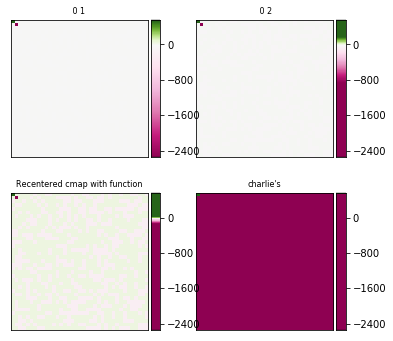

In [405]:
biased_data = np.random.random_integers(low=-15, high=5, size=(37,37))
biased_data[0,0]  = 550
biased_data[1,1]  = -2550

orig_cmap = plt.get_cmap('PiYG')

small = 1/(np.percentile(biased_data,5) / biased_data.min())
big = 1/np.percentile(biased_data,95) / biased_data.max()

cmap1 = customColorMap(orig_cmap, biased_data, start=0, stop=1)
cmap2 = customColorMap(orig_cmap, biased_data, start=-1, stop=2)
cmap3 = customColorMap(orig_cmap, biased_data, start=-10, stop=11)
cmap4 = customColorMap(orig_cmap, biased_data, start=0-small, stop=1+big)
#my_cmap = customColorMap(orig_cmap, biased_data, name='my_cmap')
#shrunk_cmap = shiftedColorMap(orig_cmap, start=0.15, midpoint=0.75, stop=0.85, name='shrunk')


fig = plt.figure(figsize=(6,6))
grid = AxesGrid(fig, 111, nrows_ncols=(2, 2), axes_pad=0.5,
                label_mode="1", share_all=True,
                cbar_location="right", cbar_mode="each",
                cbar_size="7%", cbar_pad="2%")

# normal cmap
im0 = grid[0].imshow(biased_data, interpolation="none", cmap=cmap1)
grid.cbar_axes[0].colorbar(im0)
grid[0].set_title(' 0 1 ', fontsize=8)

im1 = grid[1].imshow(biased_data, interpolation="none", cmap=cmap2)
grid.cbar_axes[1].colorbar(im1)
grid[1].set_title(' 0 2', fontsize=8)

im2 = grid[2].imshow(biased_data, interpolation="none", cmap=cmap3)
grid.cbar_axes[2].colorbar(im2)
grid[2].set_title('Recentered cmap with function', fontsize=8)

im3 = grid[3].imshow(biased_data, interpolation="none", cmap=cmap4)
grid.cbar_axes[3].colorbar(im3)
grid[3].set_title("charlie's", fontsize=8)

for ax in grid:
    ax.set_yticks([])
    ax.set_xticks([])

/Users/charlotteweil1/anaconda/envs/spatialenv/lib/python3.6/site-packages/ipykernel/__main__.py:1: DeprecationWarning: This function is deprecated. Please call randint(-15, 5 + 1) instead
  if __name__ == '__main__':


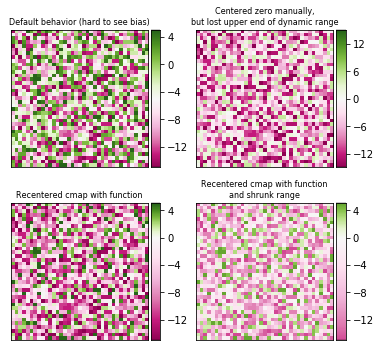

In [247]:
biased_data = np.random.random_integers(low=-15, high=5, size=(37,37))

orig_cmap = plt.get_cmap('PiYG')

shifted_cmap = shiftedColorMap(orig_cmap, midpoint=0.75, name='shifted')
shrunk_cmap = shiftedColorMap(orig_cmap, start=0.15, midpoint=0.75, stop=0.85, name='shrunk')

fig = plt.figure(figsize=(6,6))
grid = AxesGrid(fig, 111, nrows_ncols=(2, 2), axes_pad=0.5,
                label_mode="1", share_all=True,
                cbar_location="right", cbar_mode="each",
                cbar_size="7%", cbar_pad="2%")

# normal cmap
im0 = grid[0].imshow(biased_data, interpolation="none", cmap=orig_cmap)
grid.cbar_axes[0].colorbar(im0)
grid[0].set_title('Default behavior (hard to see bias)', fontsize=8)

im1 = grid[1].imshow(biased_data, interpolation="none", cmap=orig_cmap, vmax=15, vmin=-15)
grid.cbar_axes[1].colorbar(im1)
grid[1].set_title('Centered zero manually,\nbut lost upper end of dynamic range', fontsize=8)

im2 = grid[2].imshow(biased_data, interpolation="none", cmap=shifted_cmap)
grid.cbar_axes[2].colorbar(im2)
grid[2].set_title('Recentered cmap with function', fontsize=8)

im3 = grid[3].imshow(biased_data, interpolation="none", cmap=shrunk_cmap)
grid.cbar_axes[3].colorbar(im3)
grid[3].set_title('Recentered cmap with function\nand shrunk range', fontsize=8)

for ax in grid:
    ax.set_yticks([])
    ax.set_xticks([])

In [245]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid

def shiftedColorMap(cmap, start=0, midpoint=0.5, stop=1.0, name='shiftedcmap'):
    '''
    Function to offset the "center" of a colormap. Useful for
    data with a negative min and positive max and you want the
    middle of the colormap's dynamic range to be at zero.

    Input
    -----
      cmap : The matplotlib colormap to be altered
      start : Offset from lowest point in the colormap's range.
          Defaults to 0.0 (no lower offset). Should be between
          0.0 and `midpoint`.
      midpoint : The new center of the colormap. Defaults to 
          0.5 (no shift). Should be between 0.0 and 1.0. In
          general, this should be  1 - vmax / (vmax + abs(vmin))
          For example if your data range from -15.0 to +5.0 and
          you want the center of the colormap at 0.0, `midpoint`
          should be set to  1 - 5/(5 + 15)) or 0.75
      stop : Offset from highest point in the colormap's range.
          Defaults to 1.0 (no upper offset). Should be between
          `midpoint` and 1.0.
    '''
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False), 
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = matplotlib.colors.LinearSegmentedColormap(name, cdict)
    plt.register_cmap(cmap=newcmap)

    return newcmap

# RANGER !!!!

### Discuss results

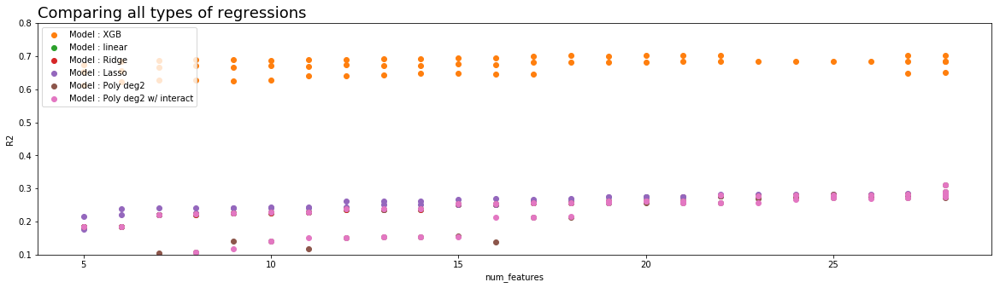

In [101]:
plot_R2_2params('num_features','Model',results_all,
                scatter=True,ylim=(0.10,0.8),
               title = 'Comparing all types of regressions',
               figsize = (20,5),
               color_palette = 'tab10')


# Several values for same model, same ≠ of features because different options (e.g different parameters alpha for Lasso,
# different subset of data for Poly: RFE vs. RFE BUT climzones.)


In [13]:
## Compare models by R2 scores

def plot_R2_2params(param_x, param_color, xgb_tuning,scatter=False,
                    ylim=None,title=None,figsize=(20,5),color_palette='Dark2'):

    fig, ax = plt.subplots(figsize=figsize)


    palette = plt.get_cmap(color_palette)
    num=0
    for param_color_value in xgb_tuning[param_color].unique():
        num+=1
        x = (xgb_tuning[xgb_tuning[param_color]==param_color_value][param_x])
        y = (xgb_tuning[xgb_tuning[param_color]==param_color_value]['R2'])
        #labels= (xgb_tuning[xgb_tuning[param_color]==learning_rate][param_color])
        if scatter == False:
            P = plt.plot(x,y, marker='.',color=palette(num), linewidth=2, alpha=0.9,
                 label=(str(param_color)+' : ' +str(param_color_value)))
        if scatter == True:
            P = plt.scatter(x,y, marker='o',color=palette(num),
                 label=(str(param_color)+' : ' +str(param_color_value)))
        
    plt.legend(loc=2, ncol=1)
    
    if title == None:
        title = "Comparing models by "+ param_x +" and "+ param_color
    plt.title(title, loc='left', fontsize=18, fontweight=0, color='black')

    plt.xlabel(param_x)
    plt.ylabel("R2")
    
    # Y lim
    if ylim != None:
        if scatter == False:
            P[0].axes.set_ylim(ylim)
        if scatter == True:
            P.axes.set_ylim(ylim)

In [33]:
# Subset of columns chosen to be metrics easily available for 2050.
# Soil : chosen "'workability_index'" because most often chosen among soil variables by RFE

simple_subset_cols = ['slope','lat','sin_lon','log_altitude',
                  'workability_index',
                  'log_gpw_population',
                  'temp_avg','precip',
                  'calories_per_ha']

simple_subset_cols_gdp = ['slope','lat','sin_lon','log_altitude',
                  'workability_index',
                  'gdp','log_gdp_per_capita','log_gpw_population'
                  'temp_avg','precip',
                  'calories_per_ha']